# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

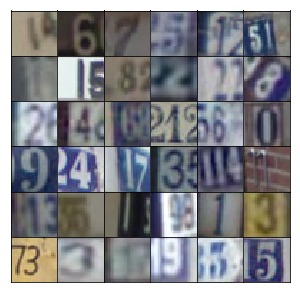

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        nn = tf.layers.batch_normalization(x, training=training)
        # Reshape before passing to conv layer
        nn = tf.reshape(nn, (-1, 4, 4, 512))
        # Leaky relu
        nn = tf.maximum(alpha * nn, nn)
        
        nn = tf.layers.conv2d_transpose(nn, 256, (5, 5), strides=2, padding='same')
        nn = tf.layers.batch_normalization(nn, training=training)
        nn = tf.maximum(alpha * nn, nn)
        
        nn = tf.layers.conv2d_transpose(nn, 128, (5, 5), strides=2, padding='same')
        nn = tf.layers.batch_normalization(nn, training=training)
        nn = tf.maximum(alpha * nn, nn)
    
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(nn, output_dim, (5, 5), strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, (5, 5), strides=2, padding='same')
        # Leaky ReLU
        relu1 = tf.maximum(alpha * x, x)
        
        x2 = tf.layers.conv2d(relu1, 128, (5, 5), strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu1, 256, (5, 5), strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x2, training=True)
        relu3 = tf.maximum(alpha * bn2, bn2)
        
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 4.1579... Generator Loss: 0.0337
Epoch 1/25... Discriminator Loss: 3.0199... Generator Loss: 0.1268
Epoch 1/25... Discriminator Loss: 2.3357... Generator Loss: 0.2568
Epoch 1/25... Discriminator Loss: 1.9648... Generator Loss: 0.3955
Epoch 1/25... Discriminator Loss: 1.6284... Generator Loss: 0.7131
Epoch 1/25... Discriminator Loss: 1.1029... Generator Loss: 0.8464
Epoch 1/25... Discriminator Loss: 1.0411... Generator Loss: 1.0563
Epoch 1/25... Discriminator Loss: 1.2353... Generator Loss: 1.0311
Epoch 1/25... Discriminator Loss: 1.0190... Generator Loss: 1.1796
Epoch 1/25... Discriminator Loss: 1.1571... Generator Loss: 1.0093


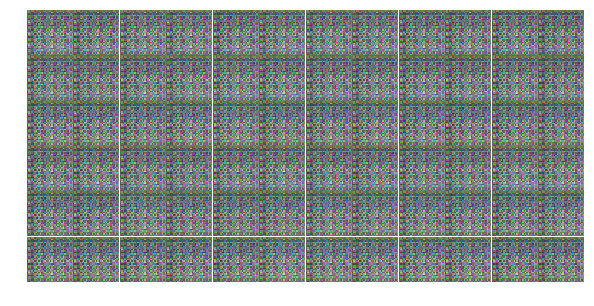

Epoch 1/25... Discriminator Loss: 0.9107... Generator Loss: 1.1122
Epoch 1/25... Discriminator Loss: 1.1729... Generator Loss: 0.9066
Epoch 1/25... Discriminator Loss: 0.8518... Generator Loss: 1.2000
Epoch 1/25... Discriminator Loss: 0.9148... Generator Loss: 1.2485
Epoch 1/25... Discriminator Loss: 0.8768... Generator Loss: 1.3102
Epoch 1/25... Discriminator Loss: 0.7543... Generator Loss: 1.0845
Epoch 1/25... Discriminator Loss: 0.5235... Generator Loss: 1.3989
Epoch 1/25... Discriminator Loss: 0.4241... Generator Loss: 1.8649
Epoch 1/25... Discriminator Loss: 0.5891... Generator Loss: 1.7133
Epoch 1/25... Discriminator Loss: 0.4032... Generator Loss: 1.6910


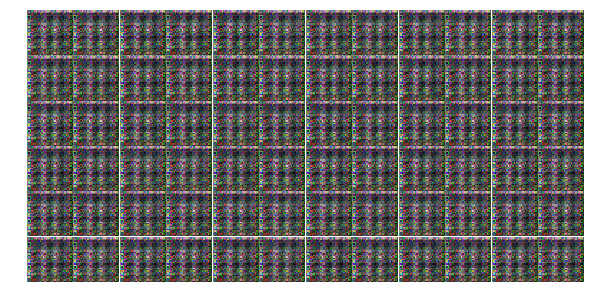

Epoch 1/25... Discriminator Loss: 0.4571... Generator Loss: 1.8961
Epoch 1/25... Discriminator Loss: 0.3776... Generator Loss: 2.1274
Epoch 1/25... Discriminator Loss: 1.0350... Generator Loss: 1.0378
Epoch 1/25... Discriminator Loss: 0.5827... Generator Loss: 1.4788
Epoch 1/25... Discriminator Loss: 0.5940... Generator Loss: 1.4348
Epoch 1/25... Discriminator Loss: 0.4360... Generator Loss: 1.6741
Epoch 1/25... Discriminator Loss: 0.3641... Generator Loss: 1.6876
Epoch 1/25... Discriminator Loss: 0.5046... Generator Loss: 1.8030
Epoch 1/25... Discriminator Loss: 0.3073... Generator Loss: 2.7133
Epoch 1/25... Discriminator Loss: 0.4119... Generator Loss: 1.9865


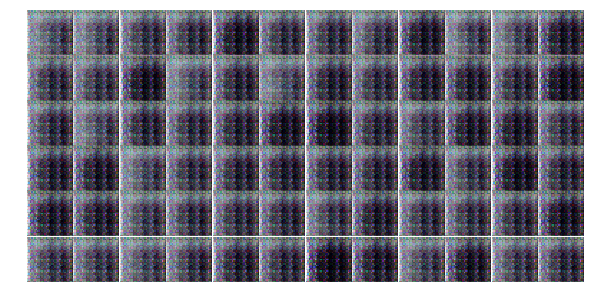

Epoch 1/25... Discriminator Loss: 0.8880... Generator Loss: 1.0822
Epoch 1/25... Discriminator Loss: 1.0718... Generator Loss: 0.8504
Epoch 1/25... Discriminator Loss: 1.1303... Generator Loss: 0.9434
Epoch 1/25... Discriminator Loss: 1.4342... Generator Loss: 0.7875
Epoch 1/25... Discriminator Loss: 1.2031... Generator Loss: 0.8510
Epoch 1/25... Discriminator Loss: 1.1864... Generator Loss: 0.8644
Epoch 1/25... Discriminator Loss: 1.2139... Generator Loss: 0.9078
Epoch 1/25... Discriminator Loss: 1.3605... Generator Loss: 0.8377
Epoch 1/25... Discriminator Loss: 1.2828... Generator Loss: 0.8556
Epoch 1/25... Discriminator Loss: 1.5674... Generator Loss: 0.6698


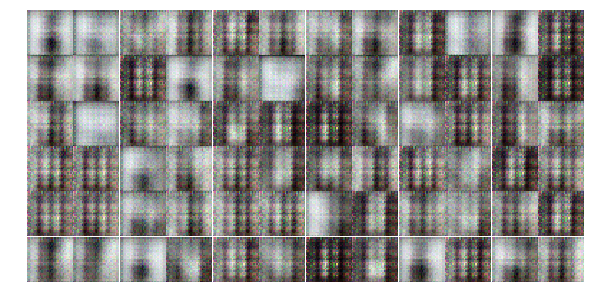

Epoch 1/25... Discriminator Loss: 1.3913... Generator Loss: 0.7293
Epoch 1/25... Discriminator Loss: 1.3334... Generator Loss: 0.8062
Epoch 1/25... Discriminator Loss: 1.4357... Generator Loss: 0.7407
Epoch 1/25... Discriminator Loss: 1.3712... Generator Loss: 0.7817
Epoch 1/25... Discriminator Loss: 1.2008... Generator Loss: 0.8328
Epoch 1/25... Discriminator Loss: 1.2929... Generator Loss: 0.6991
Epoch 1/25... Discriminator Loss: 1.2161... Generator Loss: 0.8148
Epoch 1/25... Discriminator Loss: 1.2577... Generator Loss: 0.7618
Epoch 1/25... Discriminator Loss: 1.2098... Generator Loss: 0.9137
Epoch 1/25... Discriminator Loss: 1.4872... Generator Loss: 0.6645


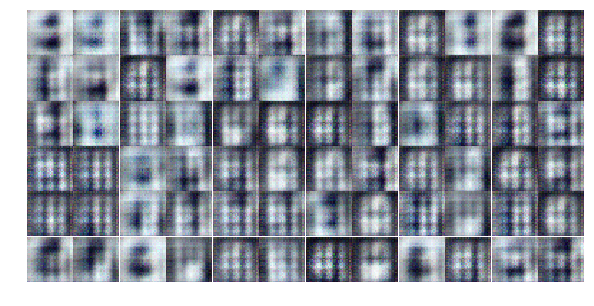

Epoch 1/25... Discriminator Loss: 1.4678... Generator Loss: 0.7189
Epoch 1/25... Discriminator Loss: 1.2288... Generator Loss: 0.7943
Epoch 1/25... Discriminator Loss: 1.2666... Generator Loss: 0.8699
Epoch 1/25... Discriminator Loss: 1.4522... Generator Loss: 0.7160
Epoch 1/25... Discriminator Loss: 1.4349... Generator Loss: 0.7070
Epoch 1/25... Discriminator Loss: 1.0791... Generator Loss: 1.0446
Epoch 1/25... Discriminator Loss: 1.1047... Generator Loss: 0.9576
Epoch 2/25... Discriminator Loss: 1.5677... Generator Loss: 0.6543
Epoch 2/25... Discriminator Loss: 1.4002... Generator Loss: 0.7619
Epoch 2/25... Discriminator Loss: 1.2049... Generator Loss: 0.8599


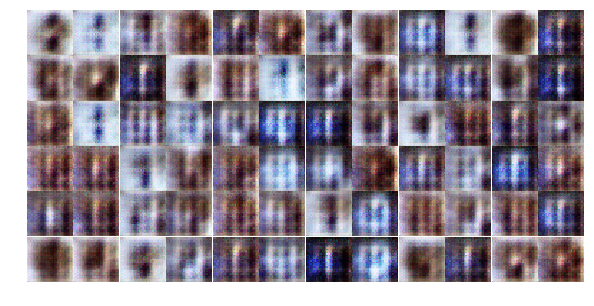

Epoch 2/25... Discriminator Loss: 1.3527... Generator Loss: 0.7484
Epoch 2/25... Discriminator Loss: 1.2620... Generator Loss: 0.8045
Epoch 2/25... Discriminator Loss: 1.4173... Generator Loss: 0.6926
Epoch 2/25... Discriminator Loss: 1.5009... Generator Loss: 0.7947
Epoch 2/25... Discriminator Loss: 1.1986... Generator Loss: 0.7868
Epoch 2/25... Discriminator Loss: 1.3671... Generator Loss: 0.6861
Epoch 2/25... Discriminator Loss: 1.3089... Generator Loss: 0.7770
Epoch 2/25... Discriminator Loss: 1.4134... Generator Loss: 0.8015
Epoch 2/25... Discriminator Loss: 1.4332... Generator Loss: 0.6306
Epoch 2/25... Discriminator Loss: 1.4346... Generator Loss: 0.6433


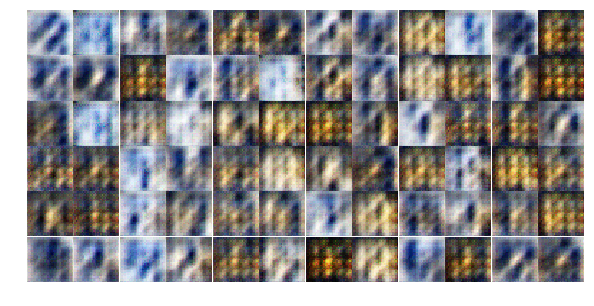

Epoch 2/25... Discriminator Loss: 1.2690... Generator Loss: 0.7616
Epoch 2/25... Discriminator Loss: 1.1998... Generator Loss: 0.8622
Epoch 2/25... Discriminator Loss: 1.2505... Generator Loss: 0.9135
Epoch 2/25... Discriminator Loss: 1.4178... Generator Loss: 0.6971
Epoch 2/25... Discriminator Loss: 1.3628... Generator Loss: 0.7133
Epoch 2/25... Discriminator Loss: 1.4029... Generator Loss: 0.7435
Epoch 2/25... Discriminator Loss: 1.2586... Generator Loss: 0.7268
Epoch 2/25... Discriminator Loss: 1.3639... Generator Loss: 0.7179
Epoch 2/25... Discriminator Loss: 1.2714... Generator Loss: 0.8063
Epoch 2/25... Discriminator Loss: 1.4994... Generator Loss: 0.7277


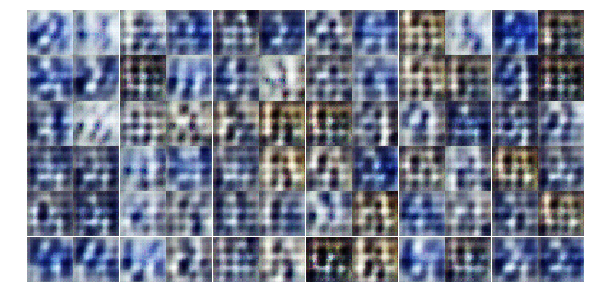

Epoch 2/25... Discriminator Loss: 1.4954... Generator Loss: 0.7229
Epoch 2/25... Discriminator Loss: 1.3300... Generator Loss: 0.7208
Epoch 2/25... Discriminator Loss: 1.3076... Generator Loss: 0.9626
Epoch 2/25... Discriminator Loss: 1.2699... Generator Loss: 0.8575
Epoch 2/25... Discriminator Loss: 1.2034... Generator Loss: 0.8566
Epoch 2/25... Discriminator Loss: 1.3585... Generator Loss: 0.7514
Epoch 2/25... Discriminator Loss: 1.3693... Generator Loss: 0.6963
Epoch 2/25... Discriminator Loss: 1.3642... Generator Loss: 0.7221
Epoch 2/25... Discriminator Loss: 1.2385... Generator Loss: 0.7582
Epoch 2/25... Discriminator Loss: 1.2357... Generator Loss: 0.8509


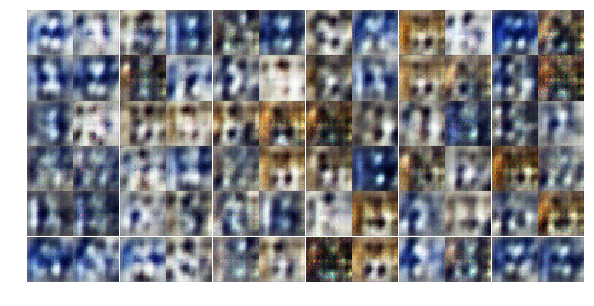

Epoch 2/25... Discriminator Loss: 1.3441... Generator Loss: 0.8324
Epoch 2/25... Discriminator Loss: 1.1629... Generator Loss: 0.7707
Epoch 2/25... Discriminator Loss: 1.2380... Generator Loss: 0.8695
Epoch 2/25... Discriminator Loss: 1.3146... Generator Loss: 0.6638
Epoch 2/25... Discriminator Loss: 1.3253... Generator Loss: 0.7341
Epoch 2/25... Discriminator Loss: 1.2696... Generator Loss: 0.9231
Epoch 2/25... Discriminator Loss: 1.1838... Generator Loss: 0.8702
Epoch 2/25... Discriminator Loss: 1.3079... Generator Loss: 0.7128
Epoch 2/25... Discriminator Loss: 1.4151... Generator Loss: 0.7099
Epoch 2/25... Discriminator Loss: 1.2843... Generator Loss: 0.8689


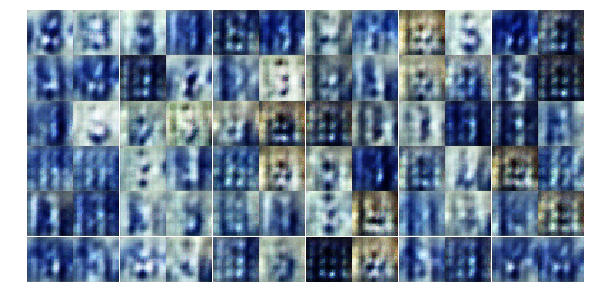

Epoch 2/25... Discriminator Loss: 1.4132... Generator Loss: 0.6728
Epoch 2/25... Discriminator Loss: 1.1959... Generator Loss: 1.0784
Epoch 2/25... Discriminator Loss: 1.3374... Generator Loss: 0.7639
Epoch 2/25... Discriminator Loss: 1.1808... Generator Loss: 0.9505
Epoch 2/25... Discriminator Loss: 1.2329... Generator Loss: 0.7970
Epoch 2/25... Discriminator Loss: 1.4839... Generator Loss: 0.5230
Epoch 2/25... Discriminator Loss: 1.2792... Generator Loss: 0.7394
Epoch 2/25... Discriminator Loss: 1.3053... Generator Loss: 0.7986
Epoch 2/25... Discriminator Loss: 1.0625... Generator Loss: 1.2255
Epoch 2/25... Discriminator Loss: 1.1243... Generator Loss: 0.8906


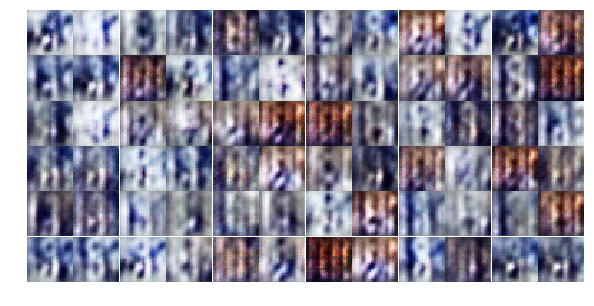

Epoch 2/25... Discriminator Loss: 1.0932... Generator Loss: 0.9273
Epoch 2/25... Discriminator Loss: 1.0220... Generator Loss: 0.9685
Epoch 2/25... Discriminator Loss: 1.3889... Generator Loss: 0.8086
Epoch 2/25... Discriminator Loss: 1.0448... Generator Loss: 0.8592
Epoch 3/25... Discriminator Loss: 1.2190... Generator Loss: 0.8545
Epoch 3/25... Discriminator Loss: 1.3480... Generator Loss: 0.7588
Epoch 3/25... Discriminator Loss: 1.4781... Generator Loss: 0.5394
Epoch 3/25... Discriminator Loss: 1.0504... Generator Loss: 1.0335
Epoch 3/25... Discriminator Loss: 1.2925... Generator Loss: 0.7683
Epoch 3/25... Discriminator Loss: 0.9835... Generator Loss: 1.0606


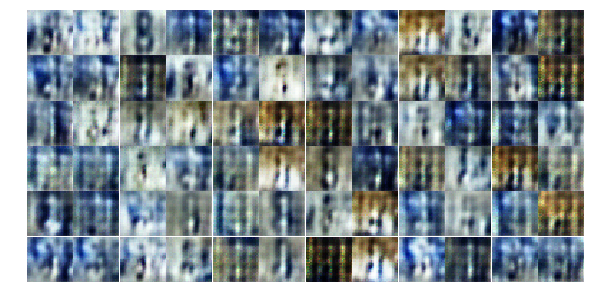

Epoch 3/25... Discriminator Loss: 1.0717... Generator Loss: 0.8931
Epoch 3/25... Discriminator Loss: 1.3292... Generator Loss: 0.6345
Epoch 3/25... Discriminator Loss: 0.8447... Generator Loss: 1.1022
Epoch 3/25... Discriminator Loss: 1.1220... Generator Loss: 0.9323
Epoch 3/25... Discriminator Loss: 1.2238... Generator Loss: 0.6870
Epoch 3/25... Discriminator Loss: 1.1429... Generator Loss: 1.3041
Epoch 3/25... Discriminator Loss: 1.2058... Generator Loss: 1.0092
Epoch 3/25... Discriminator Loss: 1.2554... Generator Loss: 0.8472
Epoch 3/25... Discriminator Loss: 1.0884... Generator Loss: 0.8602
Epoch 3/25... Discriminator Loss: 1.3659... Generator Loss: 0.8746


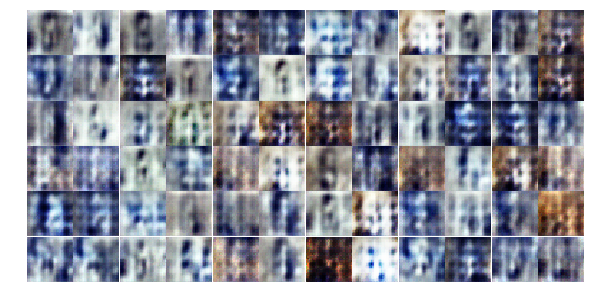

Epoch 3/25... Discriminator Loss: 1.4167... Generator Loss: 0.6606
Epoch 3/25... Discriminator Loss: 1.4495... Generator Loss: 0.6751
Epoch 3/25... Discriminator Loss: 1.1045... Generator Loss: 0.9328
Epoch 3/25... Discriminator Loss: 1.3016... Generator Loss: 0.7672
Epoch 3/25... Discriminator Loss: 1.3441... Generator Loss: 0.6279
Epoch 3/25... Discriminator Loss: 1.3551... Generator Loss: 0.8203
Epoch 3/25... Discriminator Loss: 1.2528... Generator Loss: 0.6818
Epoch 3/25... Discriminator Loss: 1.1735... Generator Loss: 0.8671
Epoch 3/25... Discriminator Loss: 1.1658... Generator Loss: 0.9230
Epoch 3/25... Discriminator Loss: 1.3978... Generator Loss: 0.7529


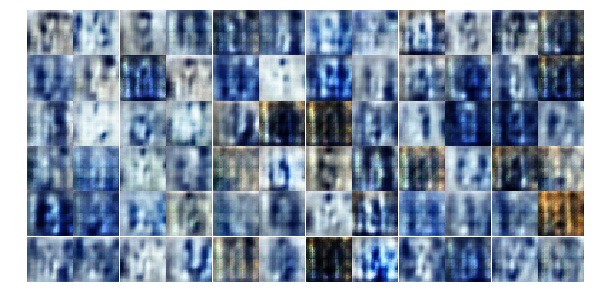

Epoch 3/25... Discriminator Loss: 1.5777... Generator Loss: 0.5354
Epoch 3/25... Discriminator Loss: 1.4454... Generator Loss: 0.7667
Epoch 3/25... Discriminator Loss: 1.4221... Generator Loss: 0.6064
Epoch 3/25... Discriminator Loss: 1.5718... Generator Loss: 0.6456
Epoch 3/25... Discriminator Loss: 1.6130... Generator Loss: 0.7319
Epoch 3/25... Discriminator Loss: 1.3683... Generator Loss: 0.8177
Epoch 3/25... Discriminator Loss: 1.3376... Generator Loss: 0.6847
Epoch 3/25... Discriminator Loss: 1.4783... Generator Loss: 0.7366
Epoch 3/25... Discriminator Loss: 1.4136... Generator Loss: 0.8548
Epoch 3/25... Discriminator Loss: 1.6048... Generator Loss: 0.5831


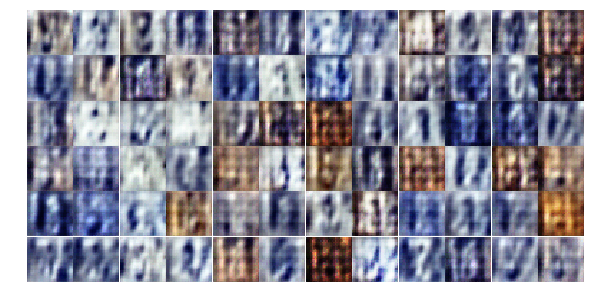

Epoch 3/25... Discriminator Loss: 1.3203... Generator Loss: 0.7880
Epoch 3/25... Discriminator Loss: 1.5667... Generator Loss: 0.5644
Epoch 3/25... Discriminator Loss: 1.2825... Generator Loss: 0.8432
Epoch 3/25... Discriminator Loss: 1.5652... Generator Loss: 0.6793
Epoch 3/25... Discriminator Loss: 1.2838... Generator Loss: 0.7324
Epoch 3/25... Discriminator Loss: 1.5518... Generator Loss: 0.6031
Epoch 3/25... Discriminator Loss: 1.4262... Generator Loss: 0.7903
Epoch 3/25... Discriminator Loss: 1.4622... Generator Loss: 0.6184
Epoch 3/25... Discriminator Loss: 1.3647... Generator Loss: 0.6606
Epoch 3/25... Discriminator Loss: 1.5387... Generator Loss: 0.6457


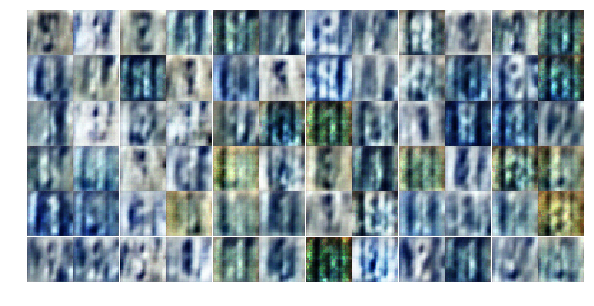

Epoch 3/25... Discriminator Loss: 1.4447... Generator Loss: 0.7110
Epoch 3/25... Discriminator Loss: 1.4344... Generator Loss: 0.6947
Epoch 3/25... Discriminator Loss: 1.3439... Generator Loss: 0.7825
Epoch 3/25... Discriminator Loss: 1.4036... Generator Loss: 0.7280
Epoch 3/25... Discriminator Loss: 1.3532... Generator Loss: 0.6297
Epoch 3/25... Discriminator Loss: 1.3841... Generator Loss: 0.7268
Epoch 3/25... Discriminator Loss: 1.4716... Generator Loss: 0.6715
Epoch 3/25... Discriminator Loss: 1.3345... Generator Loss: 0.7415
Epoch 3/25... Discriminator Loss: 1.4312... Generator Loss: 0.7215
Epoch 3/25... Discriminator Loss: 1.4243... Generator Loss: 0.6849


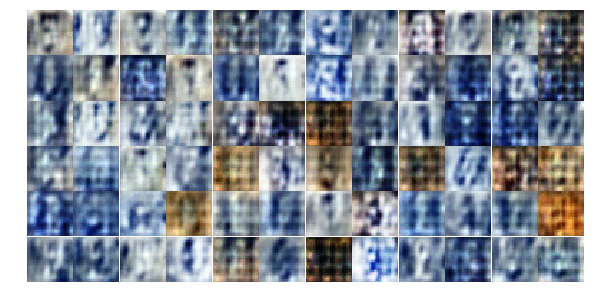

Epoch 3/25... Discriminator Loss: 1.4019... Generator Loss: 0.7336
Epoch 4/25... Discriminator Loss: 1.3580... Generator Loss: 0.7617
Epoch 4/25... Discriminator Loss: 1.4143... Generator Loss: 0.7238
Epoch 4/25... Discriminator Loss: 1.1609... Generator Loss: 0.7726
Epoch 4/25... Discriminator Loss: 1.3027... Generator Loss: 0.6805
Epoch 4/25... Discriminator Loss: 1.3006... Generator Loss: 0.7599
Epoch 4/25... Discriminator Loss: 1.4912... Generator Loss: 0.7553
Epoch 4/25... Discriminator Loss: 1.5728... Generator Loss: 0.6097
Epoch 4/25... Discriminator Loss: 1.4185... Generator Loss: 0.6612
Epoch 4/25... Discriminator Loss: 1.3572... Generator Loss: 0.7728


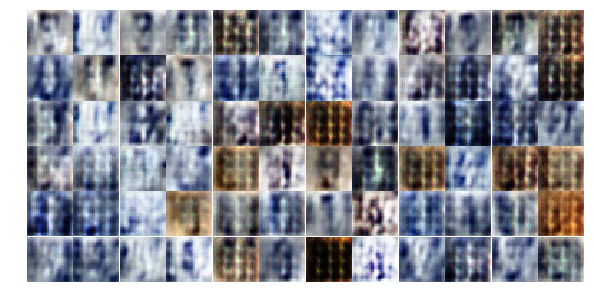

Epoch 4/25... Discriminator Loss: 1.4632... Generator Loss: 0.6346
Epoch 4/25... Discriminator Loss: 1.3714... Generator Loss: 0.6766
Epoch 4/25... Discriminator Loss: 1.4023... Generator Loss: 0.7106
Epoch 4/25... Discriminator Loss: 1.4098... Generator Loss: 0.7341
Epoch 4/25... Discriminator Loss: 1.4854... Generator Loss: 0.6418
Epoch 4/25... Discriminator Loss: 1.4074... Generator Loss: 0.7270
Epoch 4/25... Discriminator Loss: 1.3596... Generator Loss: 0.6507
Epoch 4/25... Discriminator Loss: 1.4840... Generator Loss: 0.7956
Epoch 4/25... Discriminator Loss: 1.5487... Generator Loss: 0.6112
Epoch 4/25... Discriminator Loss: 1.4139... Generator Loss: 0.6692


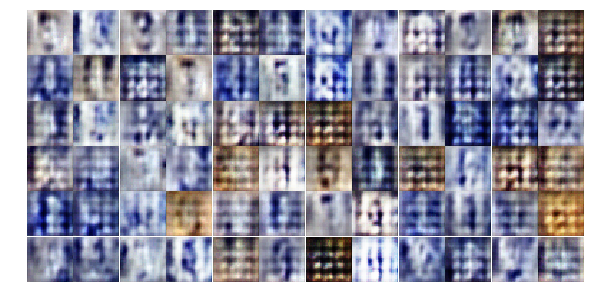

Epoch 4/25... Discriminator Loss: 1.4063... Generator Loss: 0.7130
Epoch 4/25... Discriminator Loss: 1.3924... Generator Loss: 0.7150
Epoch 4/25... Discriminator Loss: 1.5228... Generator Loss: 0.6264
Epoch 4/25... Discriminator Loss: 1.4240... Generator Loss: 0.7737
Epoch 4/25... Discriminator Loss: 1.2140... Generator Loss: 0.7978
Epoch 4/25... Discriminator Loss: 1.5050... Generator Loss: 0.7028
Epoch 4/25... Discriminator Loss: 1.4881... Generator Loss: 0.5887
Epoch 4/25... Discriminator Loss: 1.5671... Generator Loss: 0.6089
Epoch 4/25... Discriminator Loss: 1.3999... Generator Loss: 0.6795
Epoch 4/25... Discriminator Loss: 1.3008... Generator Loss: 0.7230


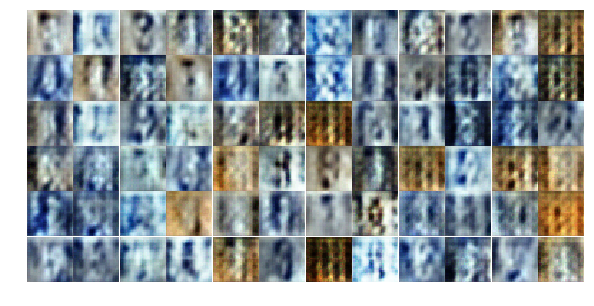

Epoch 4/25... Discriminator Loss: 1.3840... Generator Loss: 0.7321
Epoch 4/25... Discriminator Loss: 1.5138... Generator Loss: 0.6772
Epoch 4/25... Discriminator Loss: 1.4743... Generator Loss: 0.6764
Epoch 4/25... Discriminator Loss: 1.3351... Generator Loss: 0.7235
Epoch 4/25... Discriminator Loss: 1.5524... Generator Loss: 0.6544
Epoch 4/25... Discriminator Loss: 1.4918... Generator Loss: 0.7145
Epoch 4/25... Discriminator Loss: 1.5447... Generator Loss: 0.6161
Epoch 4/25... Discriminator Loss: 1.3784... Generator Loss: 0.6538
Epoch 4/25... Discriminator Loss: 1.4798... Generator Loss: 0.6367
Epoch 4/25... Discriminator Loss: 1.1700... Generator Loss: 0.7831


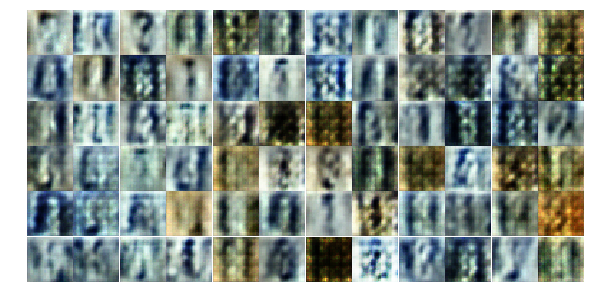

Epoch 4/25... Discriminator Loss: 1.4434... Generator Loss: 0.7089
Epoch 4/25... Discriminator Loss: 1.4622... Generator Loss: 0.6883
Epoch 4/25... Discriminator Loss: 1.2969... Generator Loss: 0.7148
Epoch 4/25... Discriminator Loss: 1.4148... Generator Loss: 0.6566
Epoch 4/25... Discriminator Loss: 1.3936... Generator Loss: 0.6648
Epoch 4/25... Discriminator Loss: 1.5046... Generator Loss: 0.6980
Epoch 4/25... Discriminator Loss: 1.2819... Generator Loss: 0.8352
Epoch 4/25... Discriminator Loss: 1.3261... Generator Loss: 0.8430
Epoch 4/25... Discriminator Loss: 1.4107... Generator Loss: 0.6602
Epoch 4/25... Discriminator Loss: 1.4204... Generator Loss: 0.6786


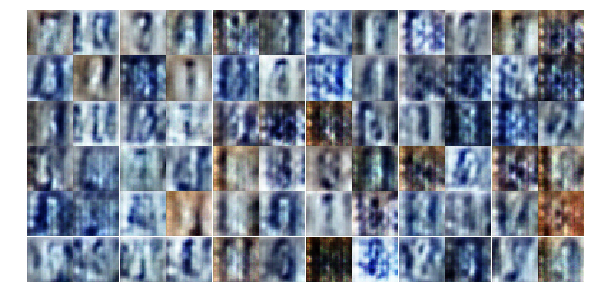

Epoch 4/25... Discriminator Loss: 1.5551... Generator Loss: 0.6748
Epoch 4/25... Discriminator Loss: 1.3823... Generator Loss: 0.8021
Epoch 4/25... Discriminator Loss: 1.3749... Generator Loss: 0.6957
Epoch 4/25... Discriminator Loss: 1.3635... Generator Loss: 0.6352
Epoch 4/25... Discriminator Loss: 1.3700... Generator Loss: 0.7091
Epoch 4/25... Discriminator Loss: 1.3386... Generator Loss: 0.6893
Epoch 4/25... Discriminator Loss: 1.4428... Generator Loss: 0.6772
Epoch 4/25... Discriminator Loss: 1.3791... Generator Loss: 0.7198
Epoch 4/25... Discriminator Loss: 1.4207... Generator Loss: 0.6885
Epoch 5/25... Discriminator Loss: 1.5619... Generator Loss: 0.5928


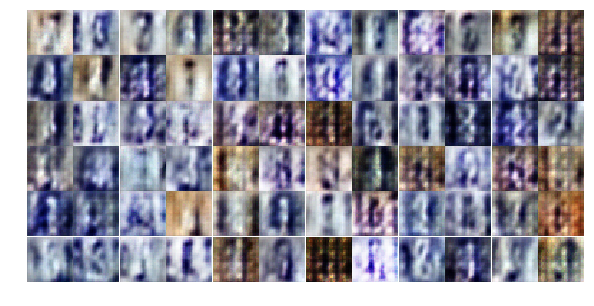

Epoch 5/25... Discriminator Loss: 1.4171... Generator Loss: 0.6806
Epoch 5/25... Discriminator Loss: 1.2533... Generator Loss: 0.7175
Epoch 5/25... Discriminator Loss: 1.3905... Generator Loss: 0.7227
Epoch 5/25... Discriminator Loss: 1.5606... Generator Loss: 0.6559
Epoch 5/25... Discriminator Loss: 1.4117... Generator Loss: 0.7054
Epoch 5/25... Discriminator Loss: 1.4736... Generator Loss: 0.6757
Epoch 5/25... Discriminator Loss: 1.3736... Generator Loss: 0.6465
Epoch 5/25... Discriminator Loss: 1.3680... Generator Loss: 0.7383
Epoch 5/25... Discriminator Loss: 1.4769... Generator Loss: 0.6782
Epoch 5/25... Discriminator Loss: 1.3374... Generator Loss: 0.7256


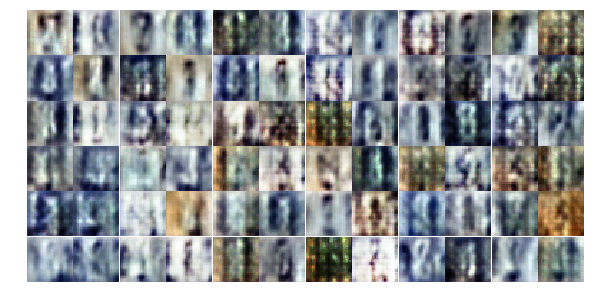

Epoch 5/25... Discriminator Loss: 1.5036... Generator Loss: 0.6807
Epoch 5/25... Discriminator Loss: 1.3542... Generator Loss: 0.7001
Epoch 5/25... Discriminator Loss: 1.5343... Generator Loss: 0.5855
Epoch 5/25... Discriminator Loss: 1.3940... Generator Loss: 0.7146
Epoch 5/25... Discriminator Loss: 1.5142... Generator Loss: 0.6797
Epoch 5/25... Discriminator Loss: 1.3221... Generator Loss: 0.7800
Epoch 5/25... Discriminator Loss: 1.4986... Generator Loss: 0.6675
Epoch 5/25... Discriminator Loss: 1.3406... Generator Loss: 0.7246
Epoch 5/25... Discriminator Loss: 1.4780... Generator Loss: 0.6236
Epoch 5/25... Discriminator Loss: 1.3787... Generator Loss: 0.6783


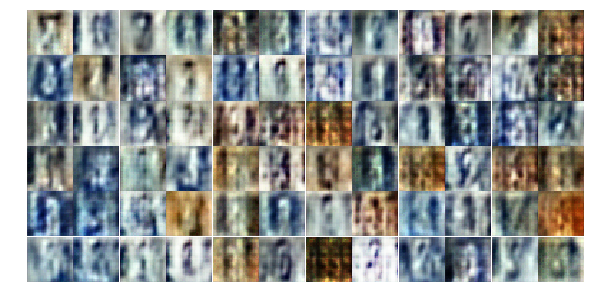

Epoch 5/25... Discriminator Loss: 1.3832... Generator Loss: 0.7183
Epoch 5/25... Discriminator Loss: 1.4628... Generator Loss: 0.6823
Epoch 5/25... Discriminator Loss: 1.4230... Generator Loss: 0.6904
Epoch 5/25... Discriminator Loss: 1.3468... Generator Loss: 0.6812
Epoch 5/25... Discriminator Loss: 1.4524... Generator Loss: 0.6630
Epoch 5/25... Discriminator Loss: 1.1779... Generator Loss: 0.9477
Epoch 5/25... Discriminator Loss: 1.4383... Generator Loss: 0.6663
Epoch 5/25... Discriminator Loss: 1.3519... Generator Loss: 0.7037
Epoch 5/25... Discriminator Loss: 1.5038... Generator Loss: 0.6901
Epoch 5/25... Discriminator Loss: 1.3708... Generator Loss: 0.7355


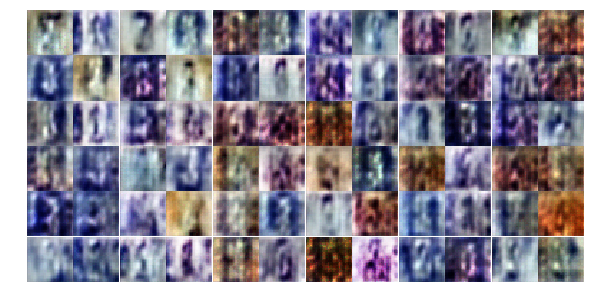

Epoch 5/25... Discriminator Loss: 1.5660... Generator Loss: 0.6453
Epoch 5/25... Discriminator Loss: 1.3225... Generator Loss: 0.7204
Epoch 5/25... Discriminator Loss: 1.7379... Generator Loss: 0.5082
Epoch 5/25... Discriminator Loss: 1.1922... Generator Loss: 0.8048
Epoch 5/25... Discriminator Loss: 1.3629... Generator Loss: 0.7584
Epoch 5/25... Discriminator Loss: 1.4177... Generator Loss: 0.7130
Epoch 5/25... Discriminator Loss: 1.3612... Generator Loss: 0.6864
Epoch 5/25... Discriminator Loss: 1.4135... Generator Loss: 0.7154
Epoch 5/25... Discriminator Loss: 1.4574... Generator Loss: 0.7190
Epoch 5/25... Discriminator Loss: 1.2890... Generator Loss: 0.7505


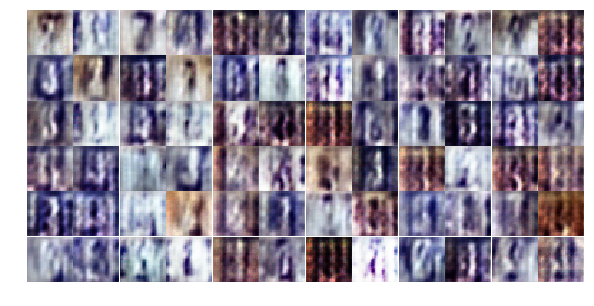

Epoch 5/25... Discriminator Loss: 1.3401... Generator Loss: 0.7242
Epoch 5/25... Discriminator Loss: 1.3820... Generator Loss: 0.6854
Epoch 5/25... Discriminator Loss: 1.3589... Generator Loss: 0.7014
Epoch 5/25... Discriminator Loss: 1.3803... Generator Loss: 0.7774
Epoch 5/25... Discriminator Loss: 1.3764... Generator Loss: 0.7273
Epoch 5/25... Discriminator Loss: 1.5312... Generator Loss: 0.6460
Epoch 5/25... Discriminator Loss: 1.4806... Generator Loss: 0.6831
Epoch 5/25... Discriminator Loss: 1.2676... Generator Loss: 0.7731
Epoch 5/25... Discriminator Loss: 1.4917... Generator Loss: 0.6306
Epoch 5/25... Discriminator Loss: 1.3602... Generator Loss: 0.7528


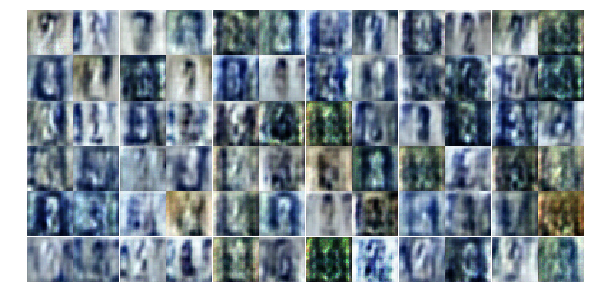

Epoch 5/25... Discriminator Loss: 1.3626... Generator Loss: 0.7377
Epoch 5/25... Discriminator Loss: 1.3685... Generator Loss: 0.6844
Epoch 5/25... Discriminator Loss: 1.4490... Generator Loss: 0.6769
Epoch 5/25... Discriminator Loss: 1.4021... Generator Loss: 0.7300
Epoch 5/25... Discriminator Loss: 1.4718... Generator Loss: 0.6530
Epoch 5/25... Discriminator Loss: 1.3538... Generator Loss: 0.7580
Epoch 6/25... Discriminator Loss: 1.3845... Generator Loss: 0.7901
Epoch 6/25... Discriminator Loss: 1.3728... Generator Loss: 0.6719
Epoch 6/25... Discriminator Loss: 1.1061... Generator Loss: 0.7673
Epoch 6/25... Discriminator Loss: 1.4147... Generator Loss: 0.7345


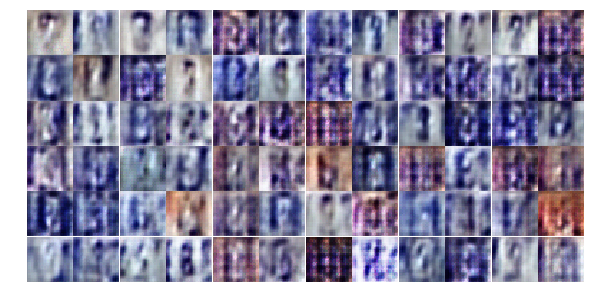

Epoch 6/25... Discriminator Loss: 1.4637... Generator Loss: 0.7198
Epoch 6/25... Discriminator Loss: 1.4054... Generator Loss: 0.6683
Epoch 6/25... Discriminator Loss: 1.4319... Generator Loss: 0.6698
Epoch 6/25... Discriminator Loss: 1.3599... Generator Loss: 0.7615
Epoch 6/25... Discriminator Loss: 1.4660... Generator Loss: 0.6900
Epoch 6/25... Discriminator Loss: 1.5584... Generator Loss: 0.6731
Epoch 6/25... Discriminator Loss: 1.4382... Generator Loss: 0.6934
Epoch 6/25... Discriminator Loss: 1.3468... Generator Loss: 0.6981
Epoch 6/25... Discriminator Loss: 1.5382... Generator Loss: 0.7417
Epoch 6/25... Discriminator Loss: 1.3949... Generator Loss: 0.7847


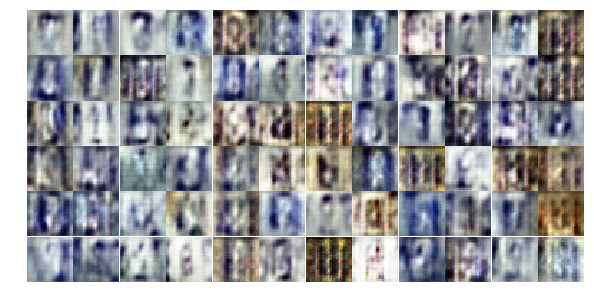

Epoch 6/25... Discriminator Loss: 1.4184... Generator Loss: 0.6042
Epoch 6/25... Discriminator Loss: 1.4255... Generator Loss: 0.6838
Epoch 6/25... Discriminator Loss: 1.3706... Generator Loss: 0.7046
Epoch 6/25... Discriminator Loss: 1.3507... Generator Loss: 0.6886
Epoch 6/25... Discriminator Loss: 1.4417... Generator Loss: 0.7194
Epoch 6/25... Discriminator Loss: 1.3604... Generator Loss: 0.7889
Epoch 6/25... Discriminator Loss: 1.4076... Generator Loss: 0.6779
Epoch 6/25... Discriminator Loss: 1.4473... Generator Loss: 0.6942
Epoch 6/25... Discriminator Loss: 1.3381... Generator Loss: 0.7530
Epoch 6/25... Discriminator Loss: 1.4620... Generator Loss: 0.6558


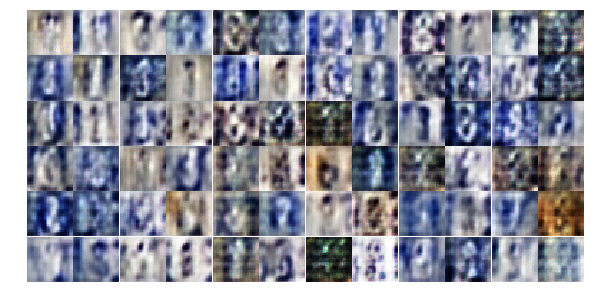

Epoch 6/25... Discriminator Loss: 1.3399... Generator Loss: 0.7562
Epoch 6/25... Discriminator Loss: 1.4795... Generator Loss: 0.6507
Epoch 6/25... Discriminator Loss: 1.3919... Generator Loss: 0.7060
Epoch 6/25... Discriminator Loss: 1.3869... Generator Loss: 0.6643
Epoch 6/25... Discriminator Loss: 1.4317... Generator Loss: 0.7019
Epoch 6/25... Discriminator Loss: 1.3843... Generator Loss: 0.6685
Epoch 6/25... Discriminator Loss: 1.3717... Generator Loss: 0.7302
Epoch 6/25... Discriminator Loss: 1.3120... Generator Loss: 0.7726
Epoch 6/25... Discriminator Loss: 1.4345... Generator Loss: 0.6562
Epoch 6/25... Discriminator Loss: 1.2066... Generator Loss: 0.7491


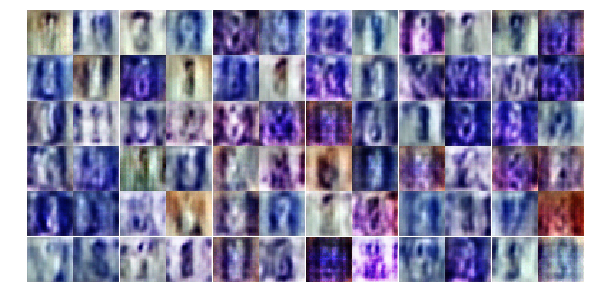

Epoch 6/25... Discriminator Loss: 1.2643... Generator Loss: 0.7778
Epoch 6/25... Discriminator Loss: 1.4676... Generator Loss: 0.6745
Epoch 6/25... Discriminator Loss: 1.4102... Generator Loss: 0.7058
Epoch 6/25... Discriminator Loss: 1.4080... Generator Loss: 0.6864
Epoch 6/25... Discriminator Loss: 1.4630... Generator Loss: 0.6839
Epoch 6/25... Discriminator Loss: 1.4099... Generator Loss: 0.6695
Epoch 6/25... Discriminator Loss: 1.3290... Generator Loss: 0.7825
Epoch 6/25... Discriminator Loss: 1.3621... Generator Loss: 0.6868
Epoch 6/25... Discriminator Loss: 1.2968... Generator Loss: 0.8156
Epoch 6/25... Discriminator Loss: 1.3162... Generator Loss: 0.7337


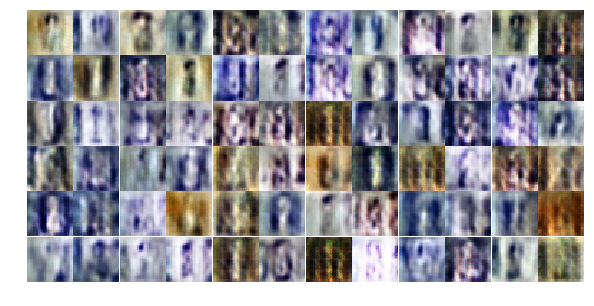

Epoch 6/25... Discriminator Loss: 1.4631... Generator Loss: 0.7121
Epoch 6/25... Discriminator Loss: 1.4358... Generator Loss: 0.5949
Epoch 6/25... Discriminator Loss: 1.4254... Generator Loss: 0.6250
Epoch 6/25... Discriminator Loss: 1.3208... Generator Loss: 0.7363
Epoch 6/25... Discriminator Loss: 1.4779... Generator Loss: 0.6671
Epoch 6/25... Discriminator Loss: 1.2721... Generator Loss: 0.7905
Epoch 6/25... Discriminator Loss: 1.4631... Generator Loss: 0.6924
Epoch 6/25... Discriminator Loss: 1.4399... Generator Loss: 0.6869
Epoch 6/25... Discriminator Loss: 1.4374... Generator Loss: 0.6556
Epoch 6/25... Discriminator Loss: 1.4516... Generator Loss: 0.6849


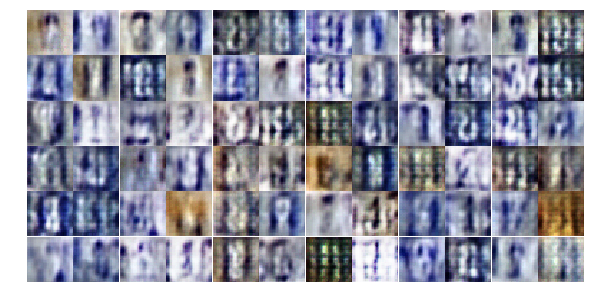

Epoch 6/25... Discriminator Loss: 1.4052... Generator Loss: 0.6912
Epoch 6/25... Discriminator Loss: 1.4112... Generator Loss: 0.6947
Epoch 6/25... Discriminator Loss: 1.5036... Generator Loss: 0.6304
Epoch 7/25... Discriminator Loss: 1.2787... Generator Loss: 0.7501
Epoch 7/25... Discriminator Loss: 1.3828... Generator Loss: 0.6876
Epoch 7/25... Discriminator Loss: 1.3459... Generator Loss: 0.7527
Epoch 7/25... Discriminator Loss: 1.5148... Generator Loss: 0.6598
Epoch 7/25... Discriminator Loss: 1.4073... Generator Loss: 0.6799
Epoch 7/25... Discriminator Loss: 1.4414... Generator Loss: 0.6435
Epoch 7/25... Discriminator Loss: 1.3914... Generator Loss: 0.7103


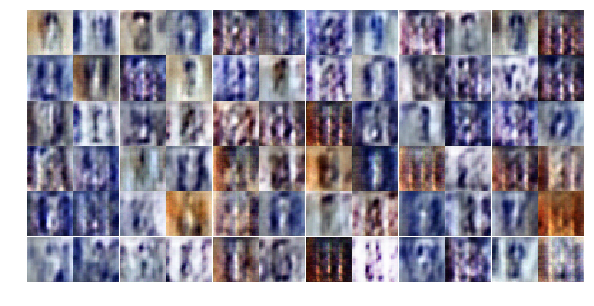

Epoch 7/25... Discriminator Loss: 1.3491... Generator Loss: 0.6807
Epoch 7/25... Discriminator Loss: 1.3928... Generator Loss: 0.6782
Epoch 7/25... Discriminator Loss: 1.3255... Generator Loss: 0.7694
Epoch 7/25... Discriminator Loss: 1.4784... Generator Loss: 0.6084
Epoch 7/25... Discriminator Loss: 1.3069... Generator Loss: 0.7999
Epoch 7/25... Discriminator Loss: 1.3531... Generator Loss: 0.7406
Epoch 7/25... Discriminator Loss: 1.3786... Generator Loss: 0.6727
Epoch 7/25... Discriminator Loss: 1.3953... Generator Loss: 0.6743
Epoch 7/25... Discriminator Loss: 1.4256... Generator Loss: 0.7462
Epoch 7/25... Discriminator Loss: 1.1835... Generator Loss: 0.9282


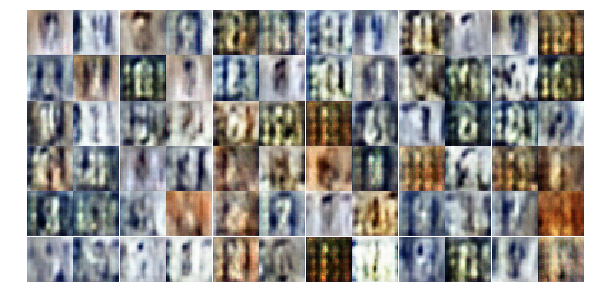

Epoch 7/25... Discriminator Loss: 1.4393... Generator Loss: 0.6273
Epoch 7/25... Discriminator Loss: 1.3839... Generator Loss: 0.6886
Epoch 7/25... Discriminator Loss: 1.3245... Generator Loss: 0.7425
Epoch 7/25... Discriminator Loss: 1.3640... Generator Loss: 0.7086
Epoch 7/25... Discriminator Loss: 1.3371... Generator Loss: 0.6800
Epoch 7/25... Discriminator Loss: 1.3331... Generator Loss: 0.7116
Epoch 7/25... Discriminator Loss: 1.3949... Generator Loss: 0.6957
Epoch 7/25... Discriminator Loss: 1.3367... Generator Loss: 0.6679
Epoch 7/25... Discriminator Loss: 1.3790... Generator Loss: 0.7270
Epoch 7/25... Discriminator Loss: 1.4261... Generator Loss: 0.6322


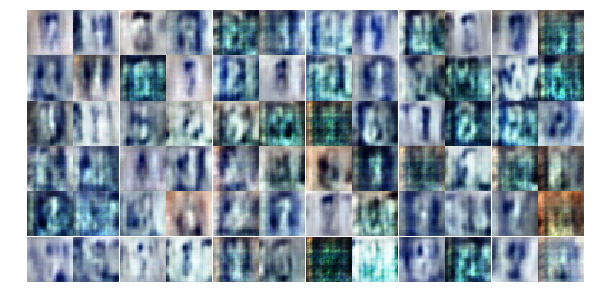

Epoch 7/25... Discriminator Loss: 1.3155... Generator Loss: 0.7517
Epoch 7/25... Discriminator Loss: 1.4543... Generator Loss: 0.7045
Epoch 7/25... Discriminator Loss: 1.3761... Generator Loss: 0.7336
Epoch 7/25... Discriminator Loss: 1.2691... Generator Loss: 0.8926
Epoch 7/25... Discriminator Loss: 1.4794... Generator Loss: 0.5773
Epoch 7/25... Discriminator Loss: 1.4482... Generator Loss: 0.5777
Epoch 7/25... Discriminator Loss: 1.2971... Generator Loss: 0.7464
Epoch 7/25... Discriminator Loss: 1.6320... Generator Loss: 0.6499
Epoch 7/25... Discriminator Loss: 1.3838... Generator Loss: 0.7702
Epoch 7/25... Discriminator Loss: 1.2845... Generator Loss: 0.8333


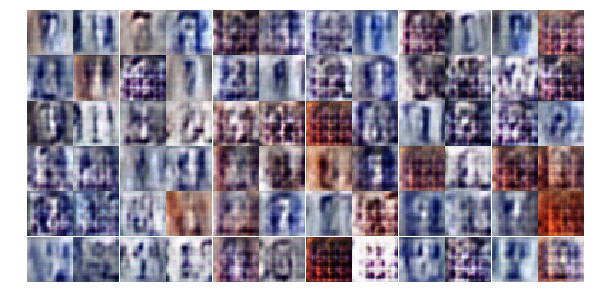

Epoch 7/25... Discriminator Loss: 1.3916... Generator Loss: 0.6525
Epoch 7/25... Discriminator Loss: 1.5470... Generator Loss: 0.6419
Epoch 7/25... Discriminator Loss: 1.3163... Generator Loss: 0.8018
Epoch 7/25... Discriminator Loss: 1.2553... Generator Loss: 0.7357
Epoch 7/25... Discriminator Loss: 1.3763... Generator Loss: 0.7089
Epoch 7/25... Discriminator Loss: 1.4324... Generator Loss: 0.6623
Epoch 7/25... Discriminator Loss: 1.3763... Generator Loss: 0.7787
Epoch 7/25... Discriminator Loss: 1.4939... Generator Loss: 0.5995
Epoch 7/25... Discriminator Loss: 1.3211... Generator Loss: 0.8339
Epoch 7/25... Discriminator Loss: 1.2827... Generator Loss: 0.7128


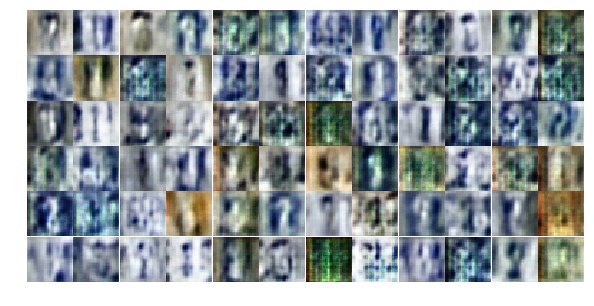

Epoch 7/25... Discriminator Loss: 1.5948... Generator Loss: 0.7050
Epoch 7/25... Discriminator Loss: 1.2181... Generator Loss: 0.8467
Epoch 7/25... Discriminator Loss: 1.2451... Generator Loss: 0.7884
Epoch 7/25... Discriminator Loss: 1.4457... Generator Loss: 0.6576
Epoch 7/25... Discriminator Loss: 1.4072... Generator Loss: 0.6981
Epoch 7/25... Discriminator Loss: 1.3594... Generator Loss: 0.7650
Epoch 7/25... Discriminator Loss: 1.2715... Generator Loss: 0.6836
Epoch 7/25... Discriminator Loss: 1.0702... Generator Loss: 1.0959
Epoch 7/25... Discriminator Loss: 1.3550... Generator Loss: 0.8221
Epoch 7/25... Discriminator Loss: 1.0454... Generator Loss: 0.8886


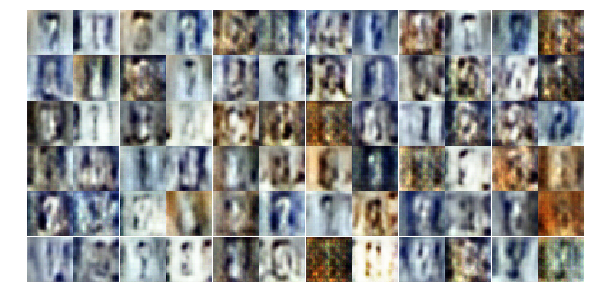

Epoch 7/25... Discriminator Loss: 1.1886... Generator Loss: 0.7774
Epoch 8/25... Discriminator Loss: 1.5162... Generator Loss: 0.5964
Epoch 8/25... Discriminator Loss: 1.2425... Generator Loss: 0.7755
Epoch 8/25... Discriminator Loss: 1.5918... Generator Loss: 0.6255
Epoch 8/25... Discriminator Loss: 1.2514... Generator Loss: 0.8234
Epoch 8/25... Discriminator Loss: 1.3642... Generator Loss: 0.7661
Epoch 8/25... Discriminator Loss: 1.3576... Generator Loss: 0.6957
Epoch 8/25... Discriminator Loss: 1.3597... Generator Loss: 0.7705
Epoch 8/25... Discriminator Loss: 1.4393... Generator Loss: 0.7079
Epoch 8/25... Discriminator Loss: 1.3595... Generator Loss: 0.7691


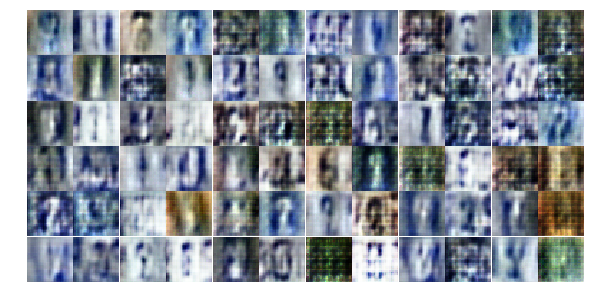

Epoch 8/25... Discriminator Loss: 1.3534... Generator Loss: 0.7476
Epoch 8/25... Discriminator Loss: 1.2379... Generator Loss: 0.7353
Epoch 8/25... Discriminator Loss: 1.4497... Generator Loss: 0.6687
Epoch 8/25... Discriminator Loss: 1.3575... Generator Loss: 0.7489
Epoch 8/25... Discriminator Loss: 1.3331... Generator Loss: 0.7550
Epoch 8/25... Discriminator Loss: 1.3217... Generator Loss: 0.7003
Epoch 8/25... Discriminator Loss: 1.4272... Generator Loss: 0.7117
Epoch 8/25... Discriminator Loss: 1.2992... Generator Loss: 0.9040
Epoch 8/25... Discriminator Loss: 1.4003... Generator Loss: 0.6952
Epoch 8/25... Discriminator Loss: 1.3671... Generator Loss: 0.6666


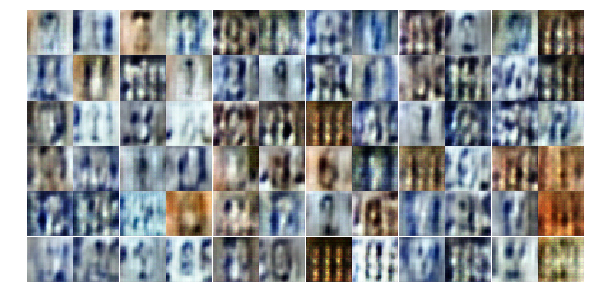

Epoch 8/25... Discriminator Loss: 1.3839... Generator Loss: 0.7396
Epoch 8/25... Discriminator Loss: 1.4277... Generator Loss: 0.7030
Epoch 8/25... Discriminator Loss: 1.3812... Generator Loss: 0.7268
Epoch 8/25... Discriminator Loss: 1.3322... Generator Loss: 0.7230
Epoch 8/25... Discriminator Loss: 1.3764... Generator Loss: 0.7413
Epoch 8/25... Discriminator Loss: 1.4071... Generator Loss: 0.6547
Epoch 8/25... Discriminator Loss: 1.4146... Generator Loss: 0.6156
Epoch 8/25... Discriminator Loss: 1.3032... Generator Loss: 0.7342
Epoch 8/25... Discriminator Loss: 1.3312... Generator Loss: 0.7031
Epoch 8/25... Discriminator Loss: 1.3220... Generator Loss: 0.7303


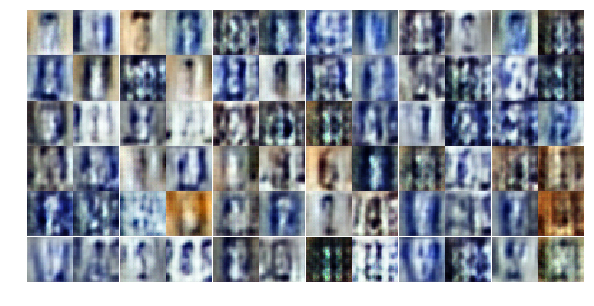

Epoch 8/25... Discriminator Loss: 1.3165... Generator Loss: 0.7293
Epoch 8/25... Discriminator Loss: 1.3746... Generator Loss: 0.8151
Epoch 8/25... Discriminator Loss: 1.2465... Generator Loss: 0.8276
Epoch 8/25... Discriminator Loss: 1.4263... Generator Loss: 0.6613
Epoch 8/25... Discriminator Loss: 1.2649... Generator Loss: 0.7516
Epoch 8/25... Discriminator Loss: 1.3188... Generator Loss: 0.8802
Epoch 8/25... Discriminator Loss: 1.4019... Generator Loss: 0.6932
Epoch 8/25... Discriminator Loss: 1.2985... Generator Loss: 0.7279
Epoch 8/25... Discriminator Loss: 1.3242... Generator Loss: 0.6673
Epoch 8/25... Discriminator Loss: 1.4076... Generator Loss: 0.6803


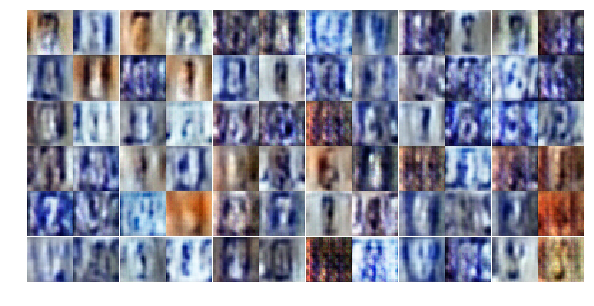

Epoch 8/25... Discriminator Loss: 1.2878... Generator Loss: 0.7642
Epoch 8/25... Discriminator Loss: 1.4151... Generator Loss: 0.7379
Epoch 8/25... Discriminator Loss: 1.3162... Generator Loss: 0.7532
Epoch 8/25... Discriminator Loss: 1.3412... Generator Loss: 0.7583
Epoch 8/25... Discriminator Loss: 1.3542... Generator Loss: 0.6639
Epoch 8/25... Discriminator Loss: 1.3601... Generator Loss: 0.6672
Epoch 8/25... Discriminator Loss: 1.5104... Generator Loss: 0.5401
Epoch 8/25... Discriminator Loss: 1.3711... Generator Loss: 0.7334
Epoch 8/25... Discriminator Loss: 1.3030... Generator Loss: 0.7516
Epoch 8/25... Discriminator Loss: 1.3394... Generator Loss: 0.7684


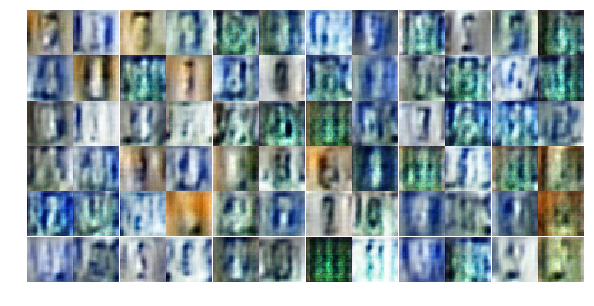

Epoch 8/25... Discriminator Loss: 1.4440... Generator Loss: 0.5508
Epoch 8/25... Discriminator Loss: 1.2670... Generator Loss: 0.7924
Epoch 8/25... Discriminator Loss: 1.4129... Generator Loss: 0.7380
Epoch 8/25... Discriminator Loss: 1.4095... Generator Loss: 0.6626
Epoch 8/25... Discriminator Loss: 1.1794... Generator Loss: 0.9684
Epoch 8/25... Discriminator Loss: 1.3641... Generator Loss: 0.6597
Epoch 8/25... Discriminator Loss: 1.4164... Generator Loss: 0.7021
Epoch 8/25... Discriminator Loss: 1.5337... Generator Loss: 0.6519
Epoch 9/25... Discriminator Loss: 1.3400... Generator Loss: 0.7296
Epoch 9/25... Discriminator Loss: 1.3790... Generator Loss: 0.7349


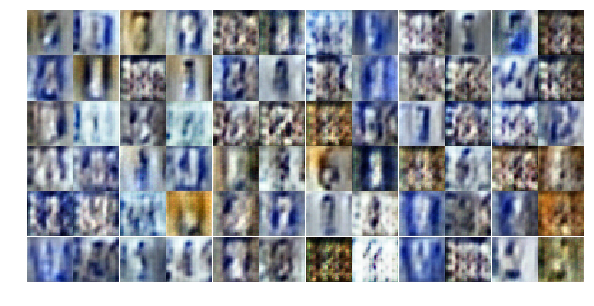

Epoch 9/25... Discriminator Loss: 1.2949... Generator Loss: 0.6980
Epoch 9/25... Discriminator Loss: 1.3897... Generator Loss: 0.7402
Epoch 9/25... Discriminator Loss: 1.3505... Generator Loss: 0.7658
Epoch 9/25... Discriminator Loss: 1.2789... Generator Loss: 0.7437
Epoch 9/25... Discriminator Loss: 1.3837... Generator Loss: 0.6408
Epoch 9/25... Discriminator Loss: 1.3161... Generator Loss: 0.7916
Epoch 9/25... Discriminator Loss: 1.3657... Generator Loss: 0.7024
Epoch 9/25... Discriminator Loss: 1.2992... Generator Loss: 0.6935
Epoch 9/25... Discriminator Loss: 1.4140... Generator Loss: 0.6543
Epoch 9/25... Discriminator Loss: 1.3922... Generator Loss: 0.7244


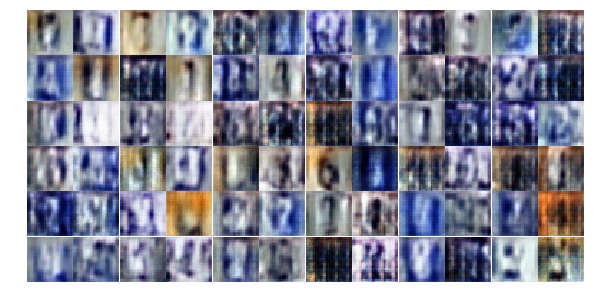

Epoch 9/25... Discriminator Loss: 1.3555... Generator Loss: 0.7094
Epoch 9/25... Discriminator Loss: 1.3082... Generator Loss: 0.7860
Epoch 9/25... Discriminator Loss: 1.4434... Generator Loss: 0.6675
Epoch 9/25... Discriminator Loss: 1.2059... Generator Loss: 0.7686
Epoch 9/25... Discriminator Loss: 1.2962... Generator Loss: 0.7853
Epoch 9/25... Discriminator Loss: 1.4821... Generator Loss: 0.6374
Epoch 9/25... Discriminator Loss: 1.3032... Generator Loss: 0.7760
Epoch 9/25... Discriminator Loss: 1.3466... Generator Loss: 0.7026
Epoch 9/25... Discriminator Loss: 1.4410... Generator Loss: 0.6952
Epoch 9/25... Discriminator Loss: 1.4728... Generator Loss: 0.6530


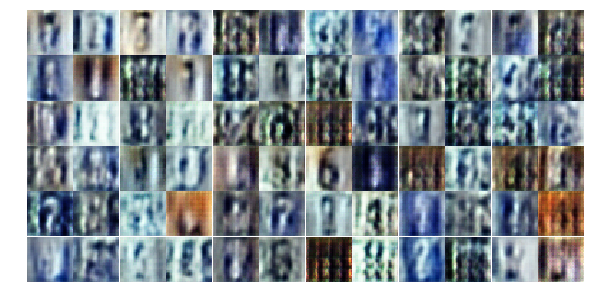

Epoch 9/25... Discriminator Loss: 1.3051... Generator Loss: 0.7390
Epoch 9/25... Discriminator Loss: 1.2945... Generator Loss: 0.7090
Epoch 9/25... Discriminator Loss: 1.3745... Generator Loss: 0.7003
Epoch 9/25... Discriminator Loss: 1.3428... Generator Loss: 0.7456
Epoch 9/25... Discriminator Loss: 1.1870... Generator Loss: 0.7722
Epoch 9/25... Discriminator Loss: 1.4423... Generator Loss: 0.6621
Epoch 9/25... Discriminator Loss: 1.5053... Generator Loss: 0.6240
Epoch 9/25... Discriminator Loss: 1.3969... Generator Loss: 0.7151
Epoch 9/25... Discriminator Loss: 1.2591... Generator Loss: 0.7575
Epoch 9/25... Discriminator Loss: 1.4788... Generator Loss: 0.6852


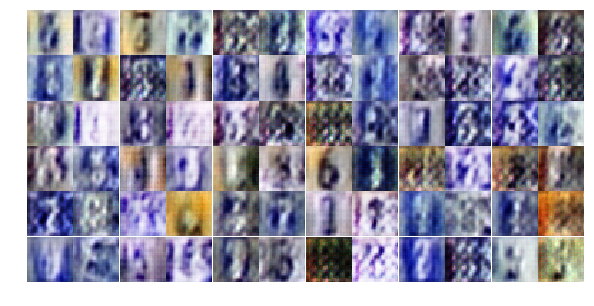

Epoch 9/25... Discriminator Loss: 1.2925... Generator Loss: 0.7403
Epoch 9/25... Discriminator Loss: 1.2764... Generator Loss: 0.8155
Epoch 9/25... Discriminator Loss: 1.6119... Generator Loss: 0.6710
Epoch 9/25... Discriminator Loss: 1.3345... Generator Loss: 0.6711
Epoch 9/25... Discriminator Loss: 1.3025... Generator Loss: 0.8256
Epoch 9/25... Discriminator Loss: 1.3376... Generator Loss: 0.7229
Epoch 9/25... Discriminator Loss: 1.3836... Generator Loss: 0.6328
Epoch 9/25... Discriminator Loss: 1.3645... Generator Loss: 0.7245
Epoch 9/25... Discriminator Loss: 1.3486... Generator Loss: 0.7793
Epoch 9/25... Discriminator Loss: 1.3800... Generator Loss: 0.7354


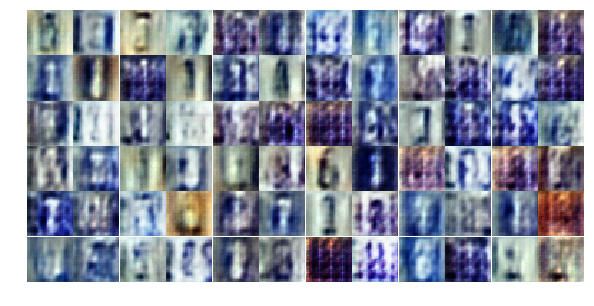

Epoch 9/25... Discriminator Loss: 1.2231... Generator Loss: 0.7755
Epoch 9/25... Discriminator Loss: 1.3591... Generator Loss: 0.7096
Epoch 9/25... Discriminator Loss: 1.4461... Generator Loss: 0.6010
Epoch 9/25... Discriminator Loss: 1.3662... Generator Loss: 0.7557
Epoch 9/25... Discriminator Loss: 1.3414... Generator Loss: 0.7781
Epoch 9/25... Discriminator Loss: 1.3481... Generator Loss: 0.6989
Epoch 9/25... Discriminator Loss: 1.2695... Generator Loss: 0.7944
Epoch 9/25... Discriminator Loss: 1.3150... Generator Loss: 0.7033
Epoch 9/25... Discriminator Loss: 1.3422... Generator Loss: 0.8100
Epoch 9/25... Discriminator Loss: 1.4309... Generator Loss: 0.5256


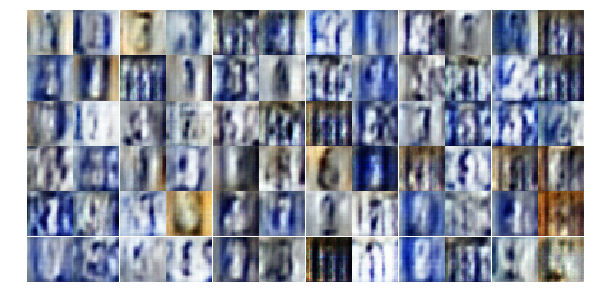

Epoch 9/25... Discriminator Loss: 1.4624... Generator Loss: 0.5669
Epoch 9/25... Discriminator Loss: 1.4783... Generator Loss: 0.6027
Epoch 9/25... Discriminator Loss: 1.4004... Generator Loss: 0.6910
Epoch 9/25... Discriminator Loss: 1.4528... Generator Loss: 0.6190
Epoch 9/25... Discriminator Loss: 1.4214... Generator Loss: 0.6382
Epoch 10/25... Discriminator Loss: 1.5187... Generator Loss: 0.5828
Epoch 10/25... Discriminator Loss: 1.4152... Generator Loss: 0.7148
Epoch 10/25... Discriminator Loss: 1.6479... Generator Loss: 0.6051
Epoch 10/25... Discriminator Loss: 1.6787... Generator Loss: 0.6157
Epoch 10/25... Discriminator Loss: 1.2027... Generator Loss: 0.8855


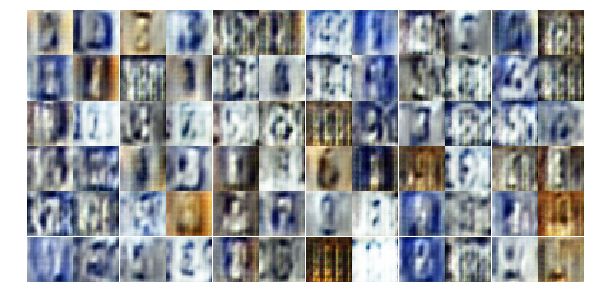

Epoch 10/25... Discriminator Loss: 1.3763... Generator Loss: 0.6665
Epoch 10/25... Discriminator Loss: 1.4312... Generator Loss: 0.6914
Epoch 10/25... Discriminator Loss: 1.2847... Generator Loss: 0.7634
Epoch 10/25... Discriminator Loss: 1.5609... Generator Loss: 0.6291
Epoch 10/25... Discriminator Loss: 1.3593... Generator Loss: 0.7435
Epoch 10/25... Discriminator Loss: 1.4487... Generator Loss: 0.6421
Epoch 10/25... Discriminator Loss: 1.3228... Generator Loss: 0.7258
Epoch 10/25... Discriminator Loss: 1.3789... Generator Loss: 0.6869
Epoch 10/25... Discriminator Loss: 1.2888... Generator Loss: 0.7091
Epoch 10/25... Discriminator Loss: 1.3695... Generator Loss: 0.7156


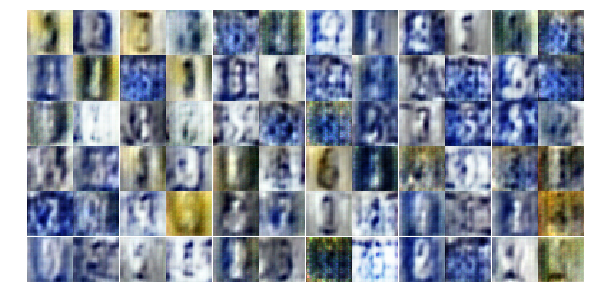

Epoch 10/25... Discriminator Loss: 1.2012... Generator Loss: 0.8121
Epoch 10/25... Discriminator Loss: 1.3080... Generator Loss: 0.7701
Epoch 10/25... Discriminator Loss: 1.3793... Generator Loss: 0.7925
Epoch 10/25... Discriminator Loss: 1.2126... Generator Loss: 0.7932
Epoch 10/25... Discriminator Loss: 1.3864... Generator Loss: 0.6717
Epoch 10/25... Discriminator Loss: 1.3315... Generator Loss: 0.8417
Epoch 10/25... Discriminator Loss: 1.3239... Generator Loss: 0.7119
Epoch 10/25... Discriminator Loss: 1.3775... Generator Loss: 0.7487
Epoch 10/25... Discriminator Loss: 1.3524... Generator Loss: 0.6674
Epoch 10/25... Discriminator Loss: 1.3389... Generator Loss: 0.7661


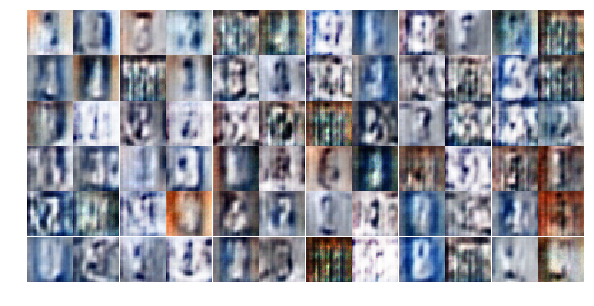

Epoch 10/25... Discriminator Loss: 1.4940... Generator Loss: 0.7428
Epoch 10/25... Discriminator Loss: 1.1756... Generator Loss: 0.8442
Epoch 10/25... Discriminator Loss: 1.5010... Generator Loss: 0.6750
Epoch 10/25... Discriminator Loss: 1.2630... Generator Loss: 0.7317
Epoch 10/25... Discriminator Loss: 1.1426... Generator Loss: 0.8203
Epoch 10/25... Discriminator Loss: 1.5140... Generator Loss: 0.6287
Epoch 10/25... Discriminator Loss: 1.2284... Generator Loss: 0.8298
Epoch 10/25... Discriminator Loss: 1.5367... Generator Loss: 0.6453
Epoch 10/25... Discriminator Loss: 1.3722... Generator Loss: 0.6892
Epoch 10/25... Discriminator Loss: 1.2731... Generator Loss: 0.7336


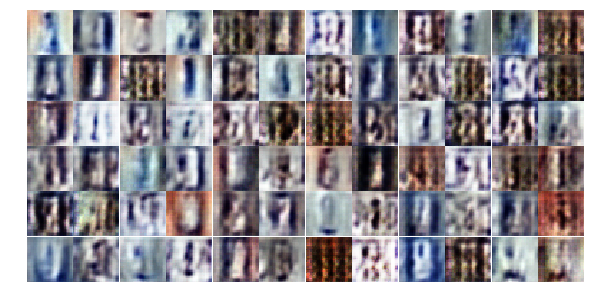

Epoch 10/25... Discriminator Loss: 1.3302... Generator Loss: 0.7180
Epoch 10/25... Discriminator Loss: 1.4512... Generator Loss: 0.6555
Epoch 10/25... Discriminator Loss: 1.4468... Generator Loss: 0.6317
Epoch 10/25... Discriminator Loss: 1.3049... Generator Loss: 0.8205
Epoch 10/25... Discriminator Loss: 1.1848... Generator Loss: 0.8396
Epoch 10/25... Discriminator Loss: 1.3630... Generator Loss: 0.6775
Epoch 10/25... Discriminator Loss: 1.2758... Generator Loss: 0.7355
Epoch 10/25... Discriminator Loss: 1.4456... Generator Loss: 0.6941
Epoch 10/25... Discriminator Loss: 1.3952... Generator Loss: 0.6669
Epoch 10/25... Discriminator Loss: 1.3571... Generator Loss: 0.7263


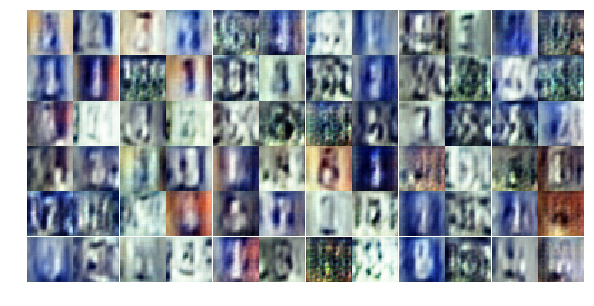

Epoch 10/25... Discriminator Loss: 1.4046... Generator Loss: 0.7586
Epoch 10/25... Discriminator Loss: 1.5022... Generator Loss: 0.6251
Epoch 10/25... Discriminator Loss: 1.3260... Generator Loss: 0.8176
Epoch 10/25... Discriminator Loss: 1.1705... Generator Loss: 0.8556
Epoch 10/25... Discriminator Loss: 1.2827... Generator Loss: 0.8319
Epoch 10/25... Discriminator Loss: 1.3919... Generator Loss: 0.6743
Epoch 10/25... Discriminator Loss: 1.2871... Generator Loss: 0.8071
Epoch 10/25... Discriminator Loss: 1.4037... Generator Loss: 0.7247
Epoch 10/25... Discriminator Loss: 1.3747... Generator Loss: 0.6783
Epoch 10/25... Discriminator Loss: 1.3788... Generator Loss: 0.7245


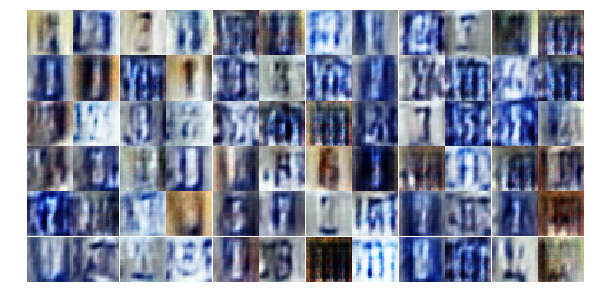

Epoch 10/25... Discriminator Loss: 1.4295... Generator Loss: 0.6414
Epoch 10/25... Discriminator Loss: 1.3128... Generator Loss: 0.7748
Epoch 10/25... Discriminator Loss: 1.2939... Generator Loss: 0.8718
Epoch 11/25... Discriminator Loss: 1.2539... Generator Loss: 0.7784
Epoch 11/25... Discriminator Loss: 1.4455... Generator Loss: 0.6336
Epoch 11/25... Discriminator Loss: 1.3266... Generator Loss: 0.7114
Epoch 11/25... Discriminator Loss: 1.3060... Generator Loss: 0.7670
Epoch 11/25... Discriminator Loss: 1.3141... Generator Loss: 0.7895
Epoch 11/25... Discriminator Loss: 1.4003... Generator Loss: 0.6791
Epoch 11/25... Discriminator Loss: 1.3803... Generator Loss: 0.7218


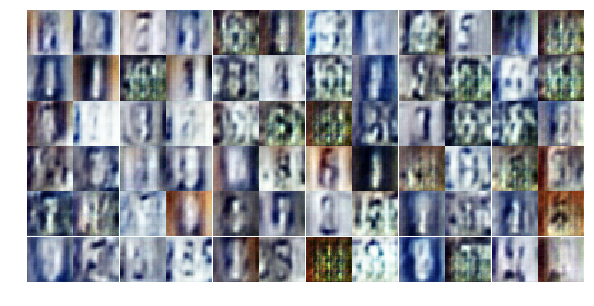

Epoch 11/25... Discriminator Loss: 1.4767... Generator Loss: 0.6437
Epoch 11/25... Discriminator Loss: 1.2033... Generator Loss: 0.7903
Epoch 11/25... Discriminator Loss: 1.3576... Generator Loss: 0.8303
Epoch 11/25... Discriminator Loss: 1.2833... Generator Loss: 0.7431
Epoch 11/25... Discriminator Loss: 1.3998... Generator Loss: 0.7690
Epoch 11/25... Discriminator Loss: 1.4246... Generator Loss: 0.6967
Epoch 11/25... Discriminator Loss: 1.2652... Generator Loss: 0.8187
Epoch 11/25... Discriminator Loss: 1.3530... Generator Loss: 0.7705
Epoch 11/25... Discriminator Loss: 1.3959... Generator Loss: 0.7603
Epoch 11/25... Discriminator Loss: 1.1707... Generator Loss: 0.7601


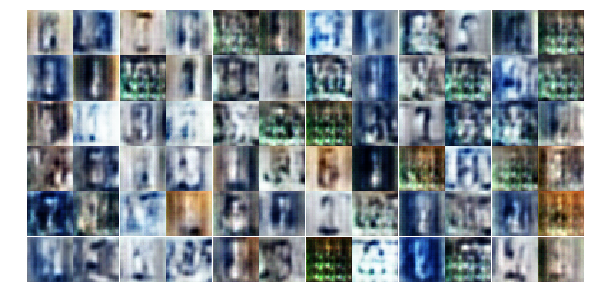

Epoch 11/25... Discriminator Loss: 1.2598... Generator Loss: 0.7351
Epoch 11/25... Discriminator Loss: 1.3253... Generator Loss: 0.7731
Epoch 11/25... Discriminator Loss: 1.3163... Generator Loss: 0.7333
Epoch 11/25... Discriminator Loss: 1.2460... Generator Loss: 0.7774
Epoch 11/25... Discriminator Loss: 1.3711... Generator Loss: 0.6976
Epoch 11/25... Discriminator Loss: 1.2849... Generator Loss: 0.8012
Epoch 11/25... Discriminator Loss: 1.3127... Generator Loss: 0.7686
Epoch 11/25... Discriminator Loss: 1.2903... Generator Loss: 0.8095
Epoch 11/25... Discriminator Loss: 1.4537... Generator Loss: 0.6715
Epoch 11/25... Discriminator Loss: 1.3677... Generator Loss: 0.7207


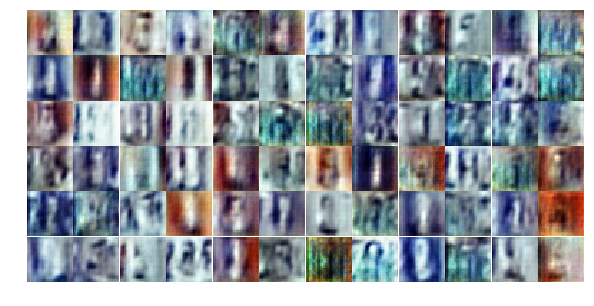

Epoch 11/25... Discriminator Loss: 1.3126... Generator Loss: 0.7648
Epoch 11/25... Discriminator Loss: 1.4174... Generator Loss: 0.7354
Epoch 11/25... Discriminator Loss: 1.3479... Generator Loss: 0.7067
Epoch 11/25... Discriminator Loss: 1.3649... Generator Loss: 0.7352
Epoch 11/25... Discriminator Loss: 1.3192... Generator Loss: 0.6843
Epoch 11/25... Discriminator Loss: 1.4329... Generator Loss: 0.6089
Epoch 11/25... Discriminator Loss: 1.2603... Generator Loss: 0.7948
Epoch 11/25... Discriminator Loss: 1.5765... Generator Loss: 0.6383
Epoch 11/25... Discriminator Loss: 1.3812... Generator Loss: 0.8643
Epoch 11/25... Discriminator Loss: 1.4011... Generator Loss: 0.7756


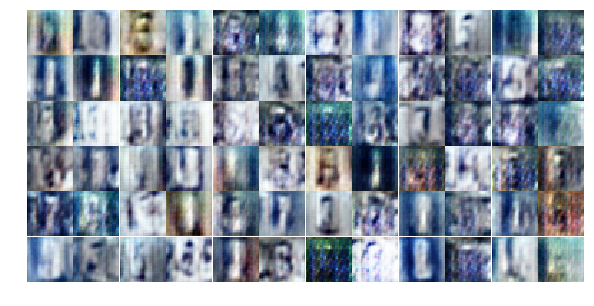

Epoch 11/25... Discriminator Loss: 1.0231... Generator Loss: 1.0229
Epoch 11/25... Discriminator Loss: 1.5088... Generator Loss: 0.5489
Epoch 11/25... Discriminator Loss: 1.3081... Generator Loss: 0.7293
Epoch 11/25... Discriminator Loss: 1.2960... Generator Loss: 0.7627
Epoch 11/25... Discriminator Loss: 1.4857... Generator Loss: 0.6638
Epoch 11/25... Discriminator Loss: 1.1953... Generator Loss: 0.8235
Epoch 11/25... Discriminator Loss: 1.2979... Generator Loss: 0.8301
Epoch 11/25... Discriminator Loss: 1.3981... Generator Loss: 0.5856
Epoch 11/25... Discriminator Loss: 1.2964... Generator Loss: 0.7000
Epoch 11/25... Discriminator Loss: 1.1998... Generator Loss: 0.8359


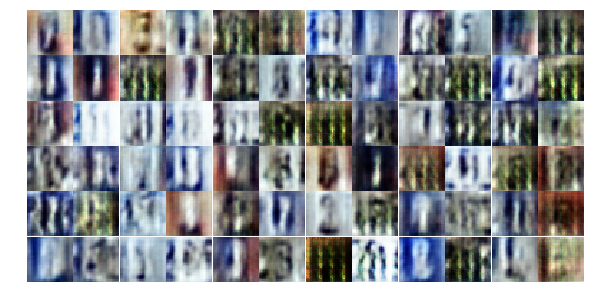

Epoch 11/25... Discriminator Loss: 1.3293... Generator Loss: 0.7459
Epoch 11/25... Discriminator Loss: 1.4688... Generator Loss: 0.6572
Epoch 11/25... Discriminator Loss: 1.1807... Generator Loss: 0.8637
Epoch 11/25... Discriminator Loss: 1.4652... Generator Loss: 0.6725
Epoch 11/25... Discriminator Loss: 1.3695... Generator Loss: 0.7083
Epoch 11/25... Discriminator Loss: 1.2987... Generator Loss: 0.6714
Epoch 11/25... Discriminator Loss: 1.2970... Generator Loss: 0.7396
Epoch 11/25... Discriminator Loss: 1.3767... Generator Loss: 0.8096
Epoch 11/25... Discriminator Loss: 1.3673... Generator Loss: 0.6690
Epoch 11/25... Discriminator Loss: 1.3254... Generator Loss: 0.7079


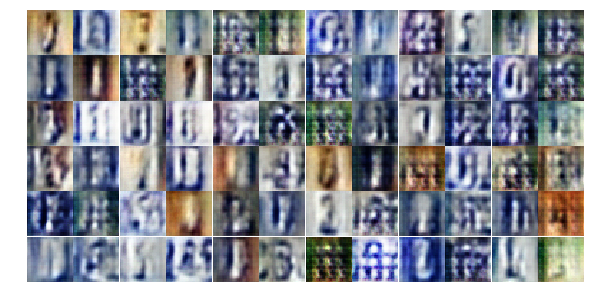

Epoch 12/25... Discriminator Loss: 1.3894... Generator Loss: 0.7296
Epoch 12/25... Discriminator Loss: 1.3784... Generator Loss: 0.6999
Epoch 12/25... Discriminator Loss: 1.3340... Generator Loss: 0.7484
Epoch 12/25... Discriminator Loss: 1.4842... Generator Loss: 0.6845
Epoch 12/25... Discriminator Loss: 1.3812... Generator Loss: 0.7219
Epoch 12/25... Discriminator Loss: 1.3448... Generator Loss: 0.7051
Epoch 12/25... Discriminator Loss: 1.2552... Generator Loss: 0.7923
Epoch 12/25... Discriminator Loss: 1.3809... Generator Loss: 0.7002
Epoch 12/25... Discriminator Loss: 1.3425... Generator Loss: 0.7276
Epoch 12/25... Discriminator Loss: 1.3794... Generator Loss: 0.8150


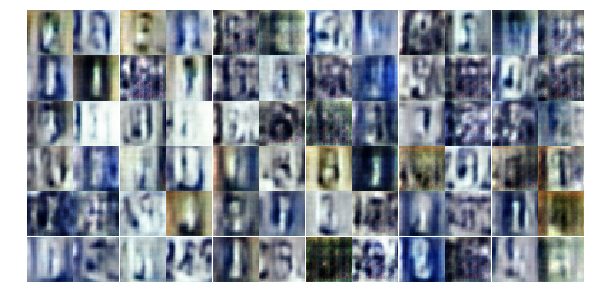

Epoch 12/25... Discriminator Loss: 1.3891... Generator Loss: 0.6406
Epoch 12/25... Discriminator Loss: 1.5359... Generator Loss: 0.6022
Epoch 12/25... Discriminator Loss: 1.3743... Generator Loss: 0.6098
Epoch 12/25... Discriminator Loss: 1.4143... Generator Loss: 0.6480
Epoch 12/25... Discriminator Loss: 1.2882... Generator Loss: 0.7649
Epoch 12/25... Discriminator Loss: 1.4785... Generator Loss: 0.7459
Epoch 12/25... Discriminator Loss: 1.2777... Generator Loss: 0.7554
Epoch 12/25... Discriminator Loss: 1.4271... Generator Loss: 0.6269
Epoch 12/25... Discriminator Loss: 1.3395... Generator Loss: 0.7765
Epoch 12/25... Discriminator Loss: 1.2350... Generator Loss: 0.8450


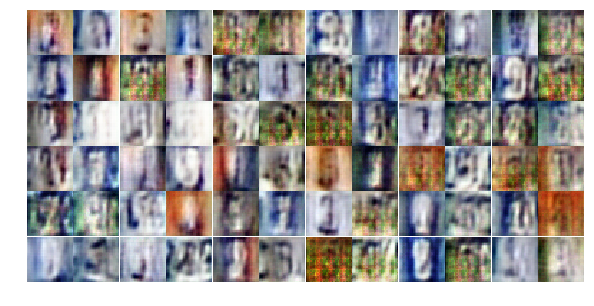

Epoch 12/25... Discriminator Loss: 1.2117... Generator Loss: 0.8474
Epoch 12/25... Discriminator Loss: 1.3423... Generator Loss: 0.7796
Epoch 12/25... Discriminator Loss: 1.2181... Generator Loss: 0.9160
Epoch 12/25... Discriminator Loss: 1.1907... Generator Loss: 0.7741
Epoch 12/25... Discriminator Loss: 1.6157... Generator Loss: 0.6495
Epoch 12/25... Discriminator Loss: 1.0565... Generator Loss: 1.1050
Epoch 12/25... Discriminator Loss: 1.1642... Generator Loss: 0.9365
Epoch 12/25... Discriminator Loss: 1.2729... Generator Loss: 0.7442
Epoch 12/25... Discriminator Loss: 1.0924... Generator Loss: 0.9319
Epoch 12/25... Discriminator Loss: 1.1137... Generator Loss: 0.9433


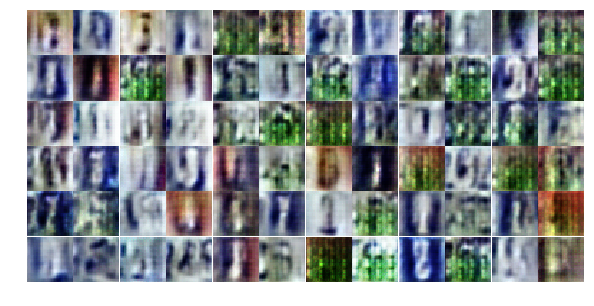

Epoch 12/25... Discriminator Loss: 1.2908... Generator Loss: 0.7510
Epoch 12/25... Discriminator Loss: 1.3884... Generator Loss: 0.7054
Epoch 12/25... Discriminator Loss: 1.1952... Generator Loss: 0.7774
Epoch 12/25... Discriminator Loss: 1.5504... Generator Loss: 0.5888
Epoch 12/25... Discriminator Loss: 1.3096... Generator Loss: 0.7584
Epoch 12/25... Discriminator Loss: 1.3917... Generator Loss: 0.7190
Epoch 12/25... Discriminator Loss: 1.2522... Generator Loss: 0.7670
Epoch 12/25... Discriminator Loss: 1.3659... Generator Loss: 0.7318
Epoch 12/25... Discriminator Loss: 1.3974... Generator Loss: 0.6914
Epoch 12/25... Discriminator Loss: 1.2446... Generator Loss: 0.9543


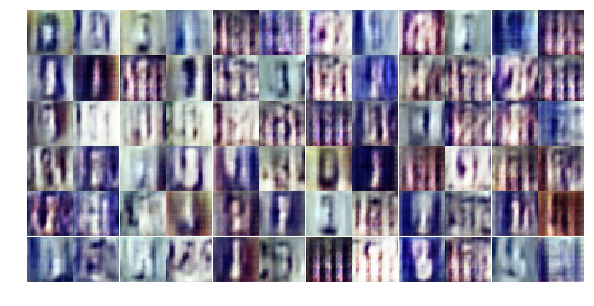

Epoch 12/25... Discriminator Loss: 1.3726... Generator Loss: 0.6877
Epoch 12/25... Discriminator Loss: 1.3022... Generator Loss: 0.7420
Epoch 12/25... Discriminator Loss: 1.6244... Generator Loss: 0.5821
Epoch 12/25... Discriminator Loss: 1.2800... Generator Loss: 0.7493
Epoch 12/25... Discriminator Loss: 1.2055... Generator Loss: 0.8314
Epoch 12/25... Discriminator Loss: 1.3368... Generator Loss: 0.7455
Epoch 12/25... Discriminator Loss: 1.3174... Generator Loss: 0.7949
Epoch 12/25... Discriminator Loss: 1.3834... Generator Loss: 0.6869
Epoch 12/25... Discriminator Loss: 1.3218... Generator Loss: 0.7132
Epoch 12/25... Discriminator Loss: 1.3801... Generator Loss: 0.6184


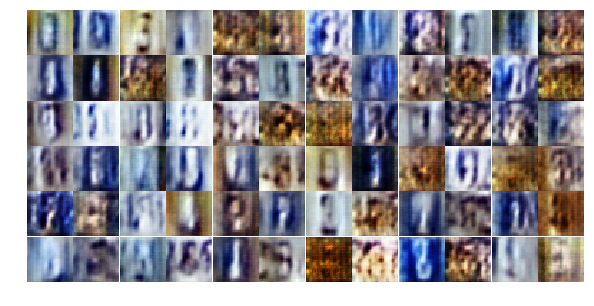

Epoch 12/25... Discriminator Loss: 1.3604... Generator Loss: 0.7140
Epoch 12/25... Discriminator Loss: 1.4041... Generator Loss: 0.7056
Epoch 12/25... Discriminator Loss: 1.3799... Generator Loss: 0.7747
Epoch 12/25... Discriminator Loss: 1.2914... Generator Loss: 0.7615
Epoch 12/25... Discriminator Loss: 1.2566... Generator Loss: 0.8389
Epoch 12/25... Discriminator Loss: 1.3479... Generator Loss: 0.7483
Epoch 12/25... Discriminator Loss: 1.3431... Generator Loss: 0.7267
Epoch 13/25... Discriminator Loss: 1.1827... Generator Loss: 0.7870
Epoch 13/25... Discriminator Loss: 1.4395... Generator Loss: 0.7287
Epoch 13/25... Discriminator Loss: 1.3309... Generator Loss: 0.6951


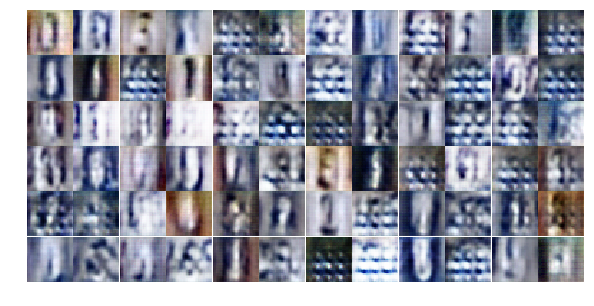

Epoch 13/25... Discriminator Loss: 1.4989... Generator Loss: 0.5660
Epoch 13/25... Discriminator Loss: 1.3925... Generator Loss: 0.6882
Epoch 13/25... Discriminator Loss: 1.5813... Generator Loss: 0.6535
Epoch 13/25... Discriminator Loss: 1.3059... Generator Loss: 0.7792
Epoch 13/25... Discriminator Loss: 1.3359... Generator Loss: 0.7529
Epoch 13/25... Discriminator Loss: 1.1496... Generator Loss: 0.8262
Epoch 13/25... Discriminator Loss: 1.3061... Generator Loss: 0.8086
Epoch 13/25... Discriminator Loss: 1.3802... Generator Loss: 0.7072
Epoch 13/25... Discriminator Loss: 1.3084... Generator Loss: 0.7604
Epoch 13/25... Discriminator Loss: 1.3464... Generator Loss: 0.7414


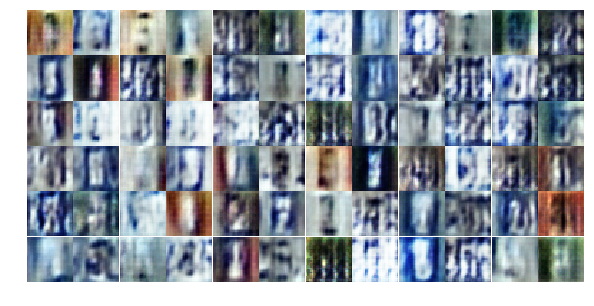

Epoch 13/25... Discriminator Loss: 1.3382... Generator Loss: 0.7027
Epoch 13/25... Discriminator Loss: 1.2488... Generator Loss: 0.7251
Epoch 13/25... Discriminator Loss: 1.4346... Generator Loss: 0.6988
Epoch 13/25... Discriminator Loss: 1.2992... Generator Loss: 0.7633
Epoch 13/25... Discriminator Loss: 1.4301... Generator Loss: 0.7777
Epoch 13/25... Discriminator Loss: 1.3189... Generator Loss: 0.6883
Epoch 13/25... Discriminator Loss: 1.1765... Generator Loss: 1.0024
Epoch 13/25... Discriminator Loss: 1.3723... Generator Loss: 0.6750
Epoch 13/25... Discriminator Loss: 1.3415... Generator Loss: 0.8479
Epoch 13/25... Discriminator Loss: 1.3749... Generator Loss: 0.6451


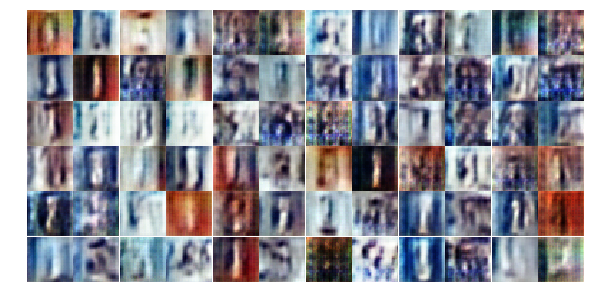

Epoch 13/25... Discriminator Loss: 1.3392... Generator Loss: 0.6913
Epoch 13/25... Discriminator Loss: 1.3522... Generator Loss: 0.8108
Epoch 13/25... Discriminator Loss: 1.4012... Generator Loss: 0.7671
Epoch 13/25... Discriminator Loss: 1.2613... Generator Loss: 0.7677
Epoch 13/25... Discriminator Loss: 1.2892... Generator Loss: 0.7724
Epoch 13/25... Discriminator Loss: 1.4352... Generator Loss: 0.6413
Epoch 13/25... Discriminator Loss: 1.3128... Generator Loss: 0.6833
Epoch 13/25... Discriminator Loss: 1.2698... Generator Loss: 0.8341
Epoch 13/25... Discriminator Loss: 1.3129... Generator Loss: 0.8259
Epoch 13/25... Discriminator Loss: 1.3272... Generator Loss: 0.7080


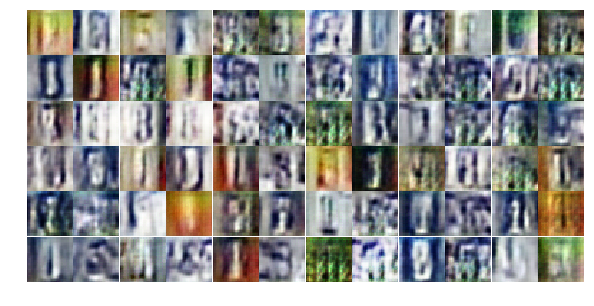

Epoch 13/25... Discriminator Loss: 1.2323... Generator Loss: 0.7418
Epoch 13/25... Discriminator Loss: 1.4505... Generator Loss: 0.7432
Epoch 13/25... Discriminator Loss: 1.2991... Generator Loss: 0.7718
Epoch 13/25... Discriminator Loss: 1.2558... Generator Loss: 0.7792
Epoch 13/25... Discriminator Loss: 1.4545... Generator Loss: 0.6578
Epoch 13/25... Discriminator Loss: 1.3214... Generator Loss: 0.8248
Epoch 13/25... Discriminator Loss: 1.2813... Generator Loss: 0.7614
Epoch 13/25... Discriminator Loss: 1.3522... Generator Loss: 0.6699
Epoch 13/25... Discriminator Loss: 1.3236... Generator Loss: 0.7118
Epoch 13/25... Discriminator Loss: 1.4846... Generator Loss: 0.6446


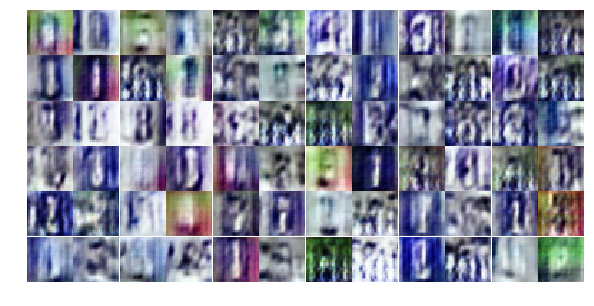

Epoch 13/25... Discriminator Loss: 1.5131... Generator Loss: 0.6702
Epoch 13/25... Discriminator Loss: 1.2418... Generator Loss: 0.8108
Epoch 13/25... Discriminator Loss: 1.3251... Generator Loss: 0.6980
Epoch 13/25... Discriminator Loss: 1.3385... Generator Loss: 0.8069
Epoch 13/25... Discriminator Loss: 1.3166... Generator Loss: 0.7567
Epoch 13/25... Discriminator Loss: 1.3046... Generator Loss: 0.7389
Epoch 13/25... Discriminator Loss: 1.3639... Generator Loss: 0.7736
Epoch 13/25... Discriminator Loss: 1.3518... Generator Loss: 0.6770
Epoch 13/25... Discriminator Loss: 1.3928... Generator Loss: 0.7721
Epoch 13/25... Discriminator Loss: 1.3153... Generator Loss: 0.7539


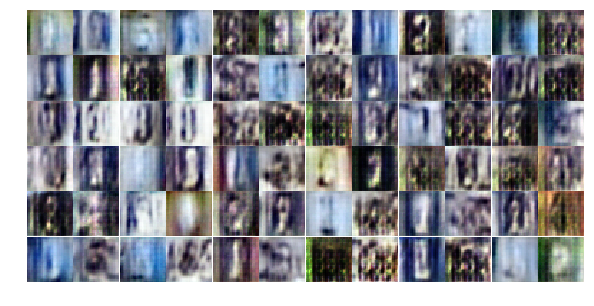

Epoch 13/25... Discriminator Loss: 1.2776... Generator Loss: 0.7531
Epoch 13/25... Discriminator Loss: 1.1056... Generator Loss: 0.9438
Epoch 13/25... Discriminator Loss: 1.4477... Generator Loss: 0.7403
Epoch 13/25... Discriminator Loss: 1.2650... Generator Loss: 0.7588
Epoch 14/25... Discriminator Loss: 1.3046... Generator Loss: 0.8251
Epoch 14/25... Discriminator Loss: 1.2134... Generator Loss: 0.8383
Epoch 14/25... Discriminator Loss: 1.4911... Generator Loss: 0.5915
Epoch 14/25... Discriminator Loss: 1.2494... Generator Loss: 0.7587
Epoch 14/25... Discriminator Loss: 1.2543... Generator Loss: 0.7676
Epoch 14/25... Discriminator Loss: 1.3007... Generator Loss: 0.7120


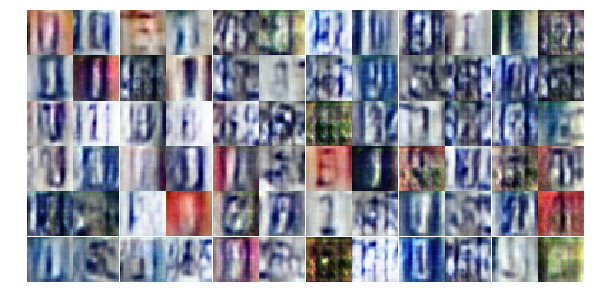

Epoch 14/25... Discriminator Loss: 1.3313... Generator Loss: 0.7666
Epoch 14/25... Discriminator Loss: 1.5374... Generator Loss: 0.5522
Epoch 14/25... Discriminator Loss: 1.3330... Generator Loss: 0.6995
Epoch 14/25... Discriminator Loss: 1.2644... Generator Loss: 0.8016
Epoch 14/25... Discriminator Loss: 1.2425... Generator Loss: 0.7259
Epoch 14/25... Discriminator Loss: 1.3076... Generator Loss: 0.8587
Epoch 14/25... Discriminator Loss: 1.1880... Generator Loss: 0.9301
Epoch 14/25... Discriminator Loss: 1.3440... Generator Loss: 0.7121
Epoch 14/25... Discriminator Loss: 1.4153... Generator Loss: 0.6821
Epoch 14/25... Discriminator Loss: 1.2270... Generator Loss: 0.7537


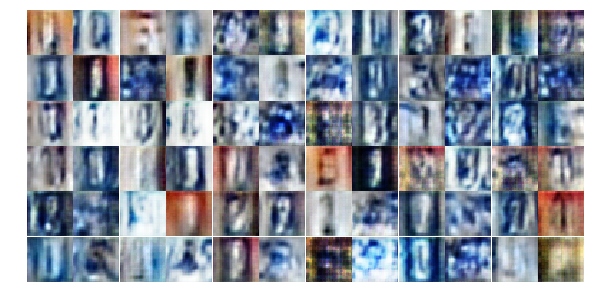

Epoch 14/25... Discriminator Loss: 1.3093... Generator Loss: 0.7701
Epoch 14/25... Discriminator Loss: 1.4093... Generator Loss: 0.6278
Epoch 14/25... Discriminator Loss: 1.2657... Generator Loss: 0.6762
Epoch 14/25... Discriminator Loss: 1.3838... Generator Loss: 0.6460
Epoch 14/25... Discriminator Loss: 1.3125... Generator Loss: 0.6916
Epoch 14/25... Discriminator Loss: 1.4016... Generator Loss: 0.7189
Epoch 14/25... Discriminator Loss: 1.4621... Generator Loss: 0.6875
Epoch 14/25... Discriminator Loss: 1.2286... Generator Loss: 0.8074
Epoch 14/25... Discriminator Loss: 1.5841... Generator Loss: 0.6702
Epoch 14/25... Discriminator Loss: 1.2754... Generator Loss: 0.6811


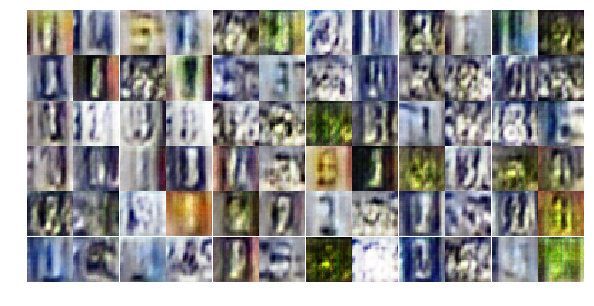

Epoch 14/25... Discriminator Loss: 1.3430... Generator Loss: 0.7521
Epoch 14/25... Discriminator Loss: 1.3344... Generator Loss: 0.7209
Epoch 14/25... Discriminator Loss: 1.2081... Generator Loss: 0.8328
Epoch 14/25... Discriminator Loss: 1.3840... Generator Loss: 0.7785
Epoch 14/25... Discriminator Loss: 1.4529... Generator Loss: 0.8119
Epoch 14/25... Discriminator Loss: 1.3642... Generator Loss: 0.7712
Epoch 14/25... Discriminator Loss: 1.2863... Generator Loss: 0.7584
Epoch 14/25... Discriminator Loss: 1.3079... Generator Loss: 0.8202
Epoch 14/25... Discriminator Loss: 1.4116... Generator Loss: 0.6746
Epoch 14/25... Discriminator Loss: 1.3273... Generator Loss: 0.7061


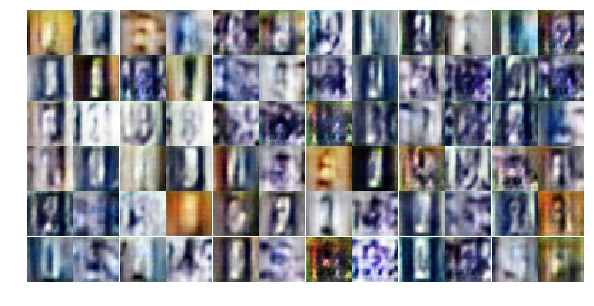

Epoch 14/25... Discriminator Loss: 1.3343... Generator Loss: 0.6745
Epoch 14/25... Discriminator Loss: 1.1585... Generator Loss: 0.8197
Epoch 14/25... Discriminator Loss: 1.3845... Generator Loss: 0.7293
Epoch 14/25... Discriminator Loss: 1.3648... Generator Loss: 0.7696
Epoch 14/25... Discriminator Loss: 1.3859... Generator Loss: 0.7587
Epoch 14/25... Discriminator Loss: 1.3508... Generator Loss: 0.7359
Epoch 14/25... Discriminator Loss: 1.3620... Generator Loss: 0.6650
Epoch 14/25... Discriminator Loss: 1.2868... Generator Loss: 0.7947
Epoch 14/25... Discriminator Loss: 1.2875... Generator Loss: 0.7758
Epoch 14/25... Discriminator Loss: 1.3370... Generator Loss: 0.6749


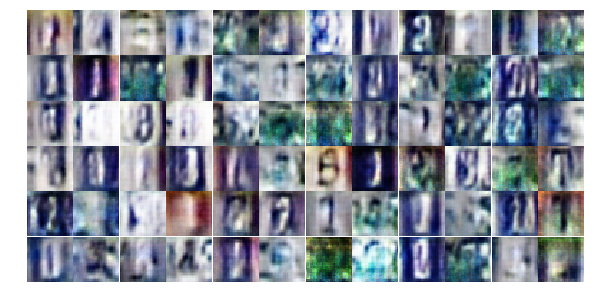

Epoch 14/25... Discriminator Loss: 1.2516... Generator Loss: 0.8084
Epoch 14/25... Discriminator Loss: 1.2516... Generator Loss: 0.7941
Epoch 14/25... Discriminator Loss: 1.2760... Generator Loss: 0.7987
Epoch 14/25... Discriminator Loss: 1.4332... Generator Loss: 0.6261
Epoch 14/25... Discriminator Loss: 1.4547... Generator Loss: 0.6332
Epoch 14/25... Discriminator Loss: 1.3017... Generator Loss: 0.7326
Epoch 14/25... Discriminator Loss: 1.2916... Generator Loss: 0.7251
Epoch 14/25... Discriminator Loss: 1.3282... Generator Loss: 0.7263
Epoch 14/25... Discriminator Loss: 1.2459... Generator Loss: 0.7571
Epoch 14/25... Discriminator Loss: 1.4538... Generator Loss: 0.5948


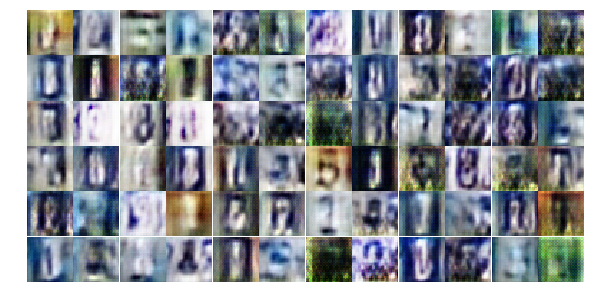

Epoch 14/25... Discriminator Loss: 1.2289... Generator Loss: 0.8194
Epoch 14/25... Discriminator Loss: 1.4941... Generator Loss: 0.6917
Epoch 15/25... Discriminator Loss: 1.4223... Generator Loss: 0.6910
Epoch 15/25... Discriminator Loss: 1.3487... Generator Loss: 0.7592
Epoch 15/25... Discriminator Loss: 1.3180... Generator Loss: 0.6799
Epoch 15/25... Discriminator Loss: 1.3244... Generator Loss: 0.7739
Epoch 15/25... Discriminator Loss: 1.2609... Generator Loss: 0.7658
Epoch 15/25... Discriminator Loss: 1.2300... Generator Loss: 0.8518
Epoch 15/25... Discriminator Loss: 1.3925... Generator Loss: 0.6914
Epoch 15/25... Discriminator Loss: 1.3387... Generator Loss: 0.7102


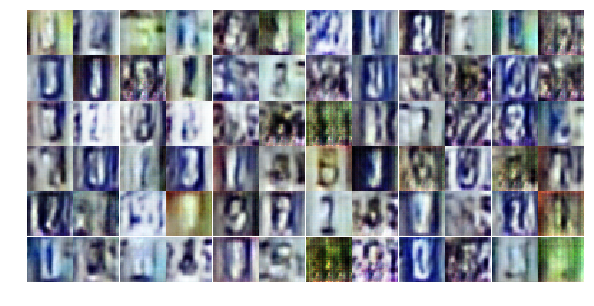

Epoch 15/25... Discriminator Loss: 1.3358... Generator Loss: 0.7589
Epoch 15/25... Discriminator Loss: 1.3867... Generator Loss: 0.7533
Epoch 15/25... Discriminator Loss: 1.2865... Generator Loss: 0.7388
Epoch 15/25... Discriminator Loss: 1.4275... Generator Loss: 0.6644
Epoch 15/25... Discriminator Loss: 1.3060... Generator Loss: 0.7446
Epoch 15/25... Discriminator Loss: 1.3262... Generator Loss: 0.7195
Epoch 15/25... Discriminator Loss: 1.3698... Generator Loss: 0.6882
Epoch 15/25... Discriminator Loss: 1.3025... Generator Loss: 0.8595
Epoch 15/25... Discriminator Loss: 1.3545... Generator Loss: 0.7036
Epoch 15/25... Discriminator Loss: 1.1994... Generator Loss: 0.7841


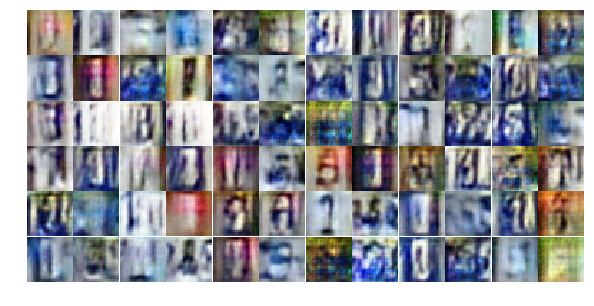

Epoch 15/25... Discriminator Loss: 1.5090... Generator Loss: 0.5931
Epoch 15/25... Discriminator Loss: 1.4050... Generator Loss: 0.6734
Epoch 15/25... Discriminator Loss: 1.2979... Generator Loss: 0.7796
Epoch 15/25... Discriminator Loss: 1.3727... Generator Loss: 0.7214
Epoch 15/25... Discriminator Loss: 1.3481... Generator Loss: 0.7263
Epoch 15/25... Discriminator Loss: 1.4410... Generator Loss: 0.6243
Epoch 15/25... Discriminator Loss: 1.2555... Generator Loss: 0.7786
Epoch 15/25... Discriminator Loss: 1.7199... Generator Loss: 0.5953
Epoch 15/25... Discriminator Loss: 1.2791... Generator Loss: 0.8212
Epoch 15/25... Discriminator Loss: 1.2482... Generator Loss: 0.7962


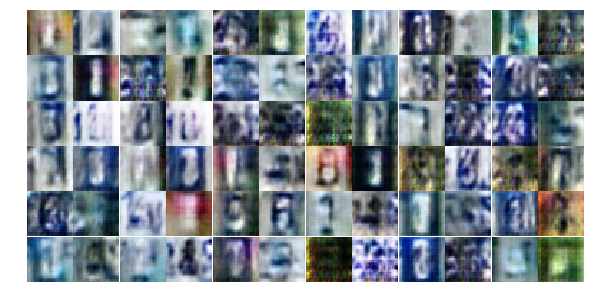

Epoch 15/25... Discriminator Loss: 1.3297... Generator Loss: 0.8215
Epoch 15/25... Discriminator Loss: 1.3532... Generator Loss: 0.7807
Epoch 15/25... Discriminator Loss: 1.2943... Generator Loss: 0.7199
Epoch 15/25... Discriminator Loss: 1.2778... Generator Loss: 0.7630
Epoch 15/25... Discriminator Loss: 1.3623... Generator Loss: 0.7218
Epoch 15/25... Discriminator Loss: 1.2857... Generator Loss: 0.7557
Epoch 15/25... Discriminator Loss: 1.3097... Generator Loss: 0.7286
Epoch 15/25... Discriminator Loss: 1.5111... Generator Loss: 0.6355
Epoch 15/25... Discriminator Loss: 1.2423... Generator Loss: 0.8056
Epoch 15/25... Discriminator Loss: 1.3613... Generator Loss: 0.5842


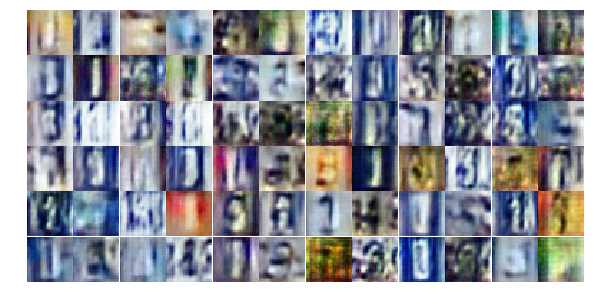

Epoch 15/25... Discriminator Loss: 1.2815... Generator Loss: 0.8850
Epoch 15/25... Discriminator Loss: 1.2741... Generator Loss: 0.7494
Epoch 15/25... Discriminator Loss: 1.2322... Generator Loss: 0.7680
Epoch 15/25... Discriminator Loss: 1.1556... Generator Loss: 0.8684
Epoch 15/25... Discriminator Loss: 1.3170... Generator Loss: 0.7156
Epoch 15/25... Discriminator Loss: 1.1818... Generator Loss: 0.7606
Epoch 15/25... Discriminator Loss: 1.2226... Generator Loss: 0.9505
Epoch 15/25... Discriminator Loss: 1.4461... Generator Loss: 0.6824
Epoch 15/25... Discriminator Loss: 1.5092... Generator Loss: 0.5976
Epoch 15/25... Discriminator Loss: 1.5436... Generator Loss: 0.5902


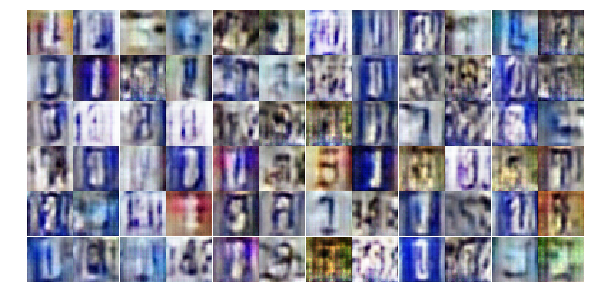

Epoch 15/25... Discriminator Loss: 1.3714... Generator Loss: 0.6949
Epoch 15/25... Discriminator Loss: 1.3659... Generator Loss: 0.6463
Epoch 15/25... Discriminator Loss: 1.3989... Generator Loss: 0.6524
Epoch 15/25... Discriminator Loss: 1.2919... Generator Loss: 0.7981
Epoch 15/25... Discriminator Loss: 1.3486... Generator Loss: 0.7878
Epoch 15/25... Discriminator Loss: 1.3288... Generator Loss: 0.7125
Epoch 15/25... Discriminator Loss: 1.4167... Generator Loss: 0.6336
Epoch 15/25... Discriminator Loss: 1.4840... Generator Loss: 0.6727
Epoch 15/25... Discriminator Loss: 1.3608... Generator Loss: 0.7197
Epoch 16/25... Discriminator Loss: 1.3458... Generator Loss: 0.8506


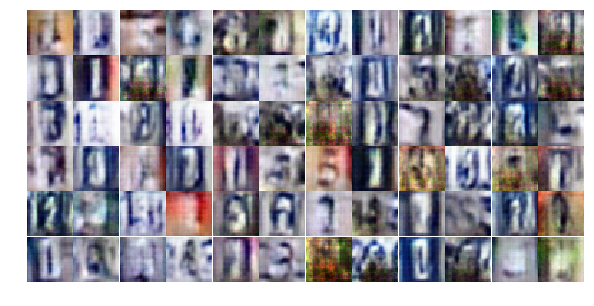

Epoch 16/25... Discriminator Loss: 1.2869... Generator Loss: 0.7468
Epoch 16/25... Discriminator Loss: 1.1692... Generator Loss: 0.9276
Epoch 16/25... Discriminator Loss: 1.3111... Generator Loss: 0.7446
Epoch 16/25... Discriminator Loss: 1.3268... Generator Loss: 0.7679
Epoch 16/25... Discriminator Loss: 1.2134... Generator Loss: 0.7101
Epoch 16/25... Discriminator Loss: 1.2101... Generator Loss: 0.9249
Epoch 16/25... Discriminator Loss: 1.4180... Generator Loss: 0.5717
Epoch 16/25... Discriminator Loss: 1.2997... Generator Loss: 0.7806
Epoch 16/25... Discriminator Loss: 1.2407... Generator Loss: 0.7428
Epoch 16/25... Discriminator Loss: 1.2056... Generator Loss: 0.7967


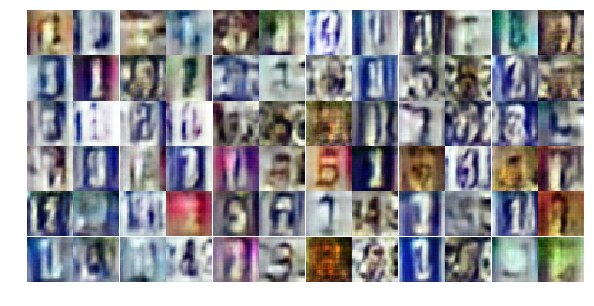

Epoch 16/25... Discriminator Loss: 1.3929... Generator Loss: 0.7228
Epoch 16/25... Discriminator Loss: 1.2333... Generator Loss: 0.8174
Epoch 16/25... Discriminator Loss: 1.3980... Generator Loss: 0.7029
Epoch 16/25... Discriminator Loss: 1.3056... Generator Loss: 0.6534
Epoch 16/25... Discriminator Loss: 1.3162... Generator Loss: 0.7487
Epoch 16/25... Discriminator Loss: 1.4475... Generator Loss: 0.7011
Epoch 16/25... Discriminator Loss: 1.0915... Generator Loss: 0.8532
Epoch 16/25... Discriminator Loss: 1.5176... Generator Loss: 0.6362
Epoch 16/25... Discriminator Loss: 1.1806... Generator Loss: 0.9210
Epoch 16/25... Discriminator Loss: 1.3582... Generator Loss: 0.6396


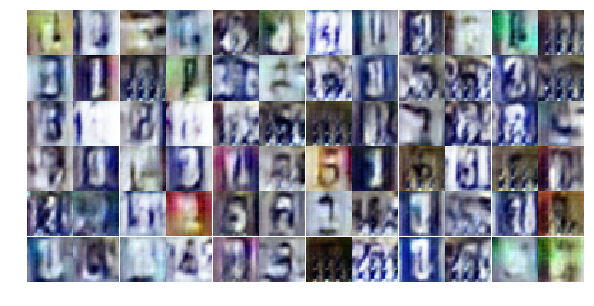

Epoch 16/25... Discriminator Loss: 1.2892... Generator Loss: 0.7550
Epoch 16/25... Discriminator Loss: 1.2628... Generator Loss: 0.7430
Epoch 16/25... Discriminator Loss: 1.3360... Generator Loss: 0.6968
Epoch 16/25... Discriminator Loss: 1.3456... Generator Loss: 0.7144
Epoch 16/25... Discriminator Loss: 1.4883... Generator Loss: 0.5640
Epoch 16/25... Discriminator Loss: 1.4598... Generator Loss: 0.6227
Epoch 16/25... Discriminator Loss: 1.3308... Generator Loss: 0.7355
Epoch 16/25... Discriminator Loss: 1.3792... Generator Loss: 0.7588
Epoch 16/25... Discriminator Loss: 1.3413... Generator Loss: 0.7001
Epoch 16/25... Discriminator Loss: 1.3309... Generator Loss: 0.7084


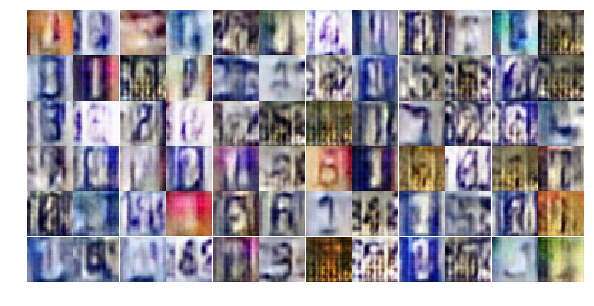

Epoch 16/25... Discriminator Loss: 1.3006... Generator Loss: 0.7556
Epoch 16/25... Discriminator Loss: 1.3879... Generator Loss: 0.7437
Epoch 16/25... Discriminator Loss: 1.2154... Generator Loss: 0.7892
Epoch 16/25... Discriminator Loss: 1.3145... Generator Loss: 0.7714
Epoch 16/25... Discriminator Loss: 1.3622... Generator Loss: 0.7007
Epoch 16/25... Discriminator Loss: 1.4047... Generator Loss: 0.6677
Epoch 16/25... Discriminator Loss: 1.2215... Generator Loss: 0.8616
Epoch 16/25... Discriminator Loss: 1.4113... Generator Loss: 0.6822
Epoch 16/25... Discriminator Loss: 1.5977... Generator Loss: 0.5519
Epoch 16/25... Discriminator Loss: 1.3352... Generator Loss: 0.7717


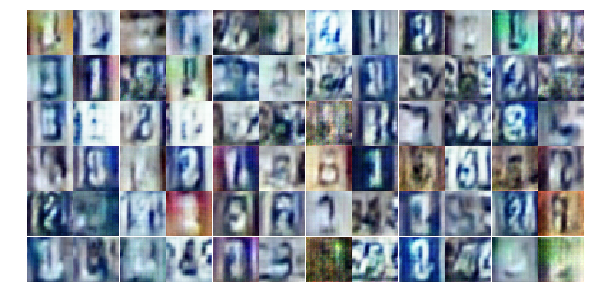

Epoch 16/25... Discriminator Loss: 1.3096... Generator Loss: 0.7430
Epoch 16/25... Discriminator Loss: 1.2799... Generator Loss: 0.7837
Epoch 16/25... Discriminator Loss: 1.3258... Generator Loss: 0.8415
Epoch 16/25... Discriminator Loss: 1.3716... Generator Loss: 0.7005
Epoch 16/25... Discriminator Loss: 1.2743... Generator Loss: 0.7178
Epoch 16/25... Discriminator Loss: 1.2985... Generator Loss: 0.7540
Epoch 16/25... Discriminator Loss: 1.3904... Generator Loss: 0.6046
Epoch 16/25... Discriminator Loss: 1.1900... Generator Loss: 0.8179
Epoch 16/25... Discriminator Loss: 1.3765... Generator Loss: 0.7208
Epoch 16/25... Discriminator Loss: 1.1609... Generator Loss: 0.9021


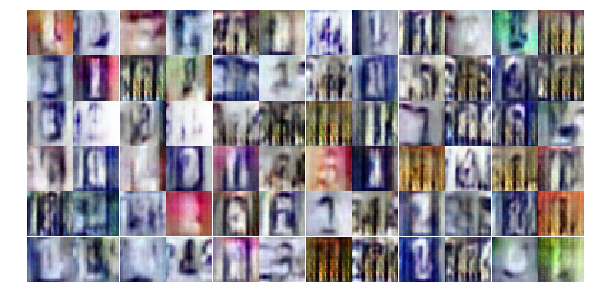

Epoch 16/25... Discriminator Loss: 1.5518... Generator Loss: 0.5235
Epoch 16/25... Discriminator Loss: 1.3366... Generator Loss: 0.7060
Epoch 16/25... Discriminator Loss: 1.3500... Generator Loss: 0.6788
Epoch 16/25... Discriminator Loss: 1.3070... Generator Loss: 0.7203
Epoch 16/25... Discriminator Loss: 1.2175... Generator Loss: 0.7955
Epoch 16/25... Discriminator Loss: 1.3879... Generator Loss: 0.6396
Epoch 17/25... Discriminator Loss: 1.2395... Generator Loss: 0.7369
Epoch 17/25... Discriminator Loss: 1.4601... Generator Loss: 0.6754
Epoch 17/25... Discriminator Loss: 1.1959... Generator Loss: 0.8691
Epoch 17/25... Discriminator Loss: 1.3220... Generator Loss: 0.8179


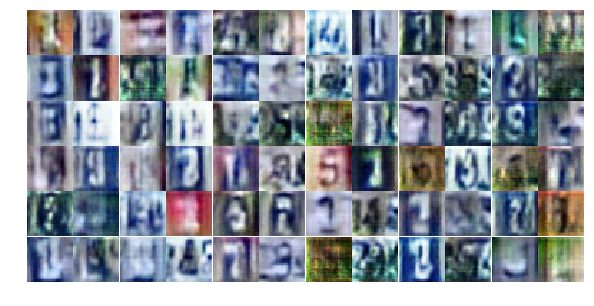

Epoch 17/25... Discriminator Loss: 1.3138... Generator Loss: 0.7411
Epoch 17/25... Discriminator Loss: 1.3275... Generator Loss: 0.6387
Epoch 17/25... Discriminator Loss: 1.3605... Generator Loss: 0.7394
Epoch 17/25... Discriminator Loss: 1.3181... Generator Loss: 0.7067
Epoch 17/25... Discriminator Loss: 1.3612... Generator Loss: 0.6690
Epoch 17/25... Discriminator Loss: 1.3520... Generator Loss: 0.6840
Epoch 17/25... Discriminator Loss: 1.3144... Generator Loss: 0.7112
Epoch 17/25... Discriminator Loss: 1.3348... Generator Loss: 0.7658
Epoch 17/25... Discriminator Loss: 1.2451... Generator Loss: 0.8522
Epoch 17/25... Discriminator Loss: 1.3560... Generator Loss: 0.6689


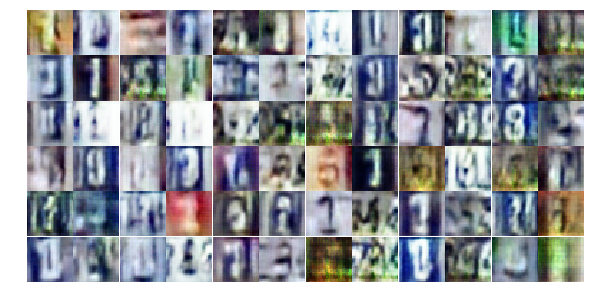

Epoch 17/25... Discriminator Loss: 1.3194... Generator Loss: 0.7000
Epoch 17/25... Discriminator Loss: 1.4093... Generator Loss: 0.6835
Epoch 17/25... Discriminator Loss: 1.1211... Generator Loss: 0.9041
Epoch 17/25... Discriminator Loss: 1.2884... Generator Loss: 0.7316
Epoch 17/25... Discriminator Loss: 1.1979... Generator Loss: 0.7810
Epoch 17/25... Discriminator Loss: 1.2877... Generator Loss: 0.6970
Epoch 17/25... Discriminator Loss: 1.2769... Generator Loss: 0.8549
Epoch 17/25... Discriminator Loss: 1.3288... Generator Loss: 0.6759
Epoch 17/25... Discriminator Loss: 1.3113... Generator Loss: 0.8479
Epoch 17/25... Discriminator Loss: 1.3047... Generator Loss: 0.6892


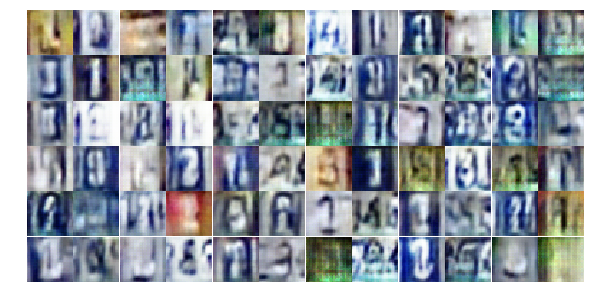

Epoch 17/25... Discriminator Loss: 1.5045... Generator Loss: 0.6148
Epoch 17/25... Discriminator Loss: 1.1661... Generator Loss: 0.8040
Epoch 17/25... Discriminator Loss: 1.3355... Generator Loss: 0.7907
Epoch 17/25... Discriminator Loss: 1.3871... Generator Loss: 0.7222
Epoch 17/25... Discriminator Loss: 1.3106... Generator Loss: 0.7720
Epoch 17/25... Discriminator Loss: 1.3316... Generator Loss: 0.6965
Epoch 17/25... Discriminator Loss: 1.3042... Generator Loss: 0.7344
Epoch 17/25... Discriminator Loss: 1.3698... Generator Loss: 0.6851
Epoch 17/25... Discriminator Loss: 1.4040... Generator Loss: 0.7181
Epoch 17/25... Discriminator Loss: 1.3112... Generator Loss: 0.7292


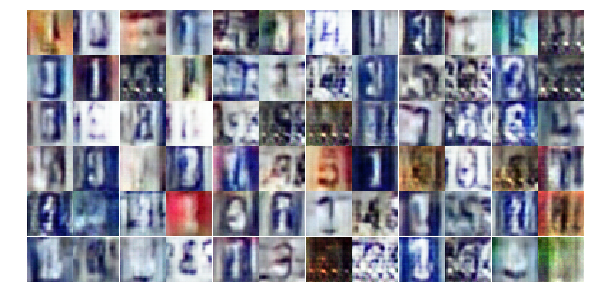

Epoch 17/25... Discriminator Loss: 1.4574... Generator Loss: 0.6367
Epoch 17/25... Discriminator Loss: 1.4844... Generator Loss: 0.6295
Epoch 17/25... Discriminator Loss: 1.3443... Generator Loss: 0.7491
Epoch 17/25... Discriminator Loss: 1.2274... Generator Loss: 0.8090
Epoch 17/25... Discriminator Loss: 1.2960... Generator Loss: 0.6640
Epoch 17/25... Discriminator Loss: 1.2188... Generator Loss: 0.7641
Epoch 17/25... Discriminator Loss: 1.4469... Generator Loss: 0.6300
Epoch 17/25... Discriminator Loss: 1.3190... Generator Loss: 0.7446
Epoch 17/25... Discriminator Loss: 1.4313... Generator Loss: 0.7403
Epoch 17/25... Discriminator Loss: 1.2909... Generator Loss: 0.8095


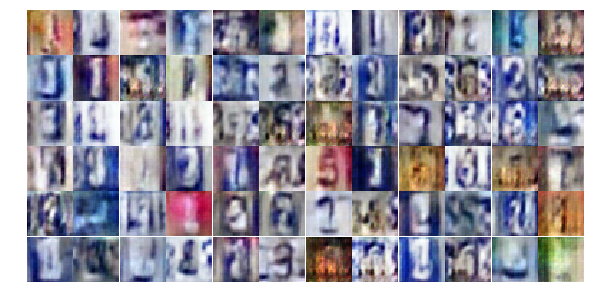

Epoch 17/25... Discriminator Loss: 1.4139... Generator Loss: 0.6641
Epoch 17/25... Discriminator Loss: 1.2275... Generator Loss: 0.8343
Epoch 17/25... Discriminator Loss: 1.3076... Generator Loss: 0.7711
Epoch 17/25... Discriminator Loss: 1.3133... Generator Loss: 0.7367
Epoch 17/25... Discriminator Loss: 1.3249... Generator Loss: 0.7323
Epoch 17/25... Discriminator Loss: 1.4863... Generator Loss: 0.5945
Epoch 17/25... Discriminator Loss: 1.1590... Generator Loss: 0.8328
Epoch 17/25... Discriminator Loss: 1.3228... Generator Loss: 0.7556
Epoch 17/25... Discriminator Loss: 1.2596... Generator Loss: 0.8037
Epoch 17/25... Discriminator Loss: 1.2969... Generator Loss: 0.7281


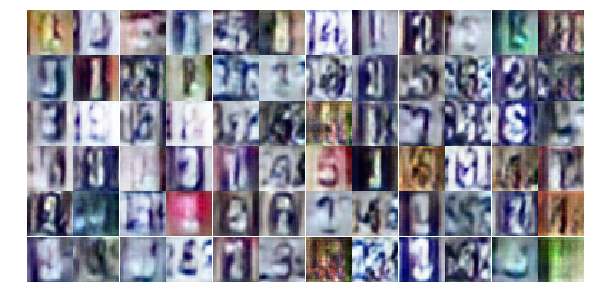

Epoch 17/25... Discriminator Loss: 1.3505... Generator Loss: 0.6693
Epoch 17/25... Discriminator Loss: 1.3637... Generator Loss: 0.7062
Epoch 17/25... Discriminator Loss: 0.9677... Generator Loss: 1.0201
Epoch 17/25... Discriminator Loss: 1.2250... Generator Loss: 0.8170
Epoch 18/25... Discriminator Loss: 1.4523... Generator Loss: 0.6790
Epoch 18/25... Discriminator Loss: 1.3186... Generator Loss: 0.6659
Epoch 18/25... Discriminator Loss: 1.5055... Generator Loss: 0.7183
Epoch 18/25... Discriminator Loss: 1.3780... Generator Loss: 0.7274
Epoch 18/25... Discriminator Loss: 1.3549... Generator Loss: 0.7228
Epoch 18/25... Discriminator Loss: 1.3832... Generator Loss: 0.6948


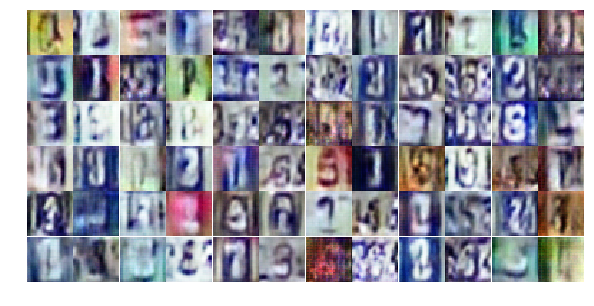

Epoch 18/25... Discriminator Loss: 1.2106... Generator Loss: 0.8139
Epoch 18/25... Discriminator Loss: 1.2897... Generator Loss: 0.7096
Epoch 18/25... Discriminator Loss: 1.3386... Generator Loss: 0.7305
Epoch 18/25... Discriminator Loss: 1.2642... Generator Loss: 0.8458
Epoch 18/25... Discriminator Loss: 1.2995... Generator Loss: 0.7533
Epoch 18/25... Discriminator Loss: 1.3570... Generator Loss: 0.7343
Epoch 18/25... Discriminator Loss: 1.2903... Generator Loss: 0.7980
Epoch 18/25... Discriminator Loss: 1.3296... Generator Loss: 0.6803
Epoch 18/25... Discriminator Loss: 1.2456... Generator Loss: 0.7153
Epoch 18/25... Discriminator Loss: 1.2544... Generator Loss: 0.8372


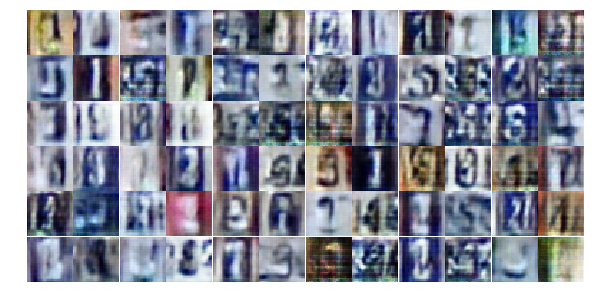

Epoch 18/25... Discriminator Loss: 1.1752... Generator Loss: 0.8431
Epoch 18/25... Discriminator Loss: 1.3187... Generator Loss: 0.7149
Epoch 18/25... Discriminator Loss: 1.3366... Generator Loss: 0.6731
Epoch 18/25... Discriminator Loss: 1.2906... Generator Loss: 0.7783
Epoch 18/25... Discriminator Loss: 1.2513... Generator Loss: 0.8109
Epoch 18/25... Discriminator Loss: 1.4867... Generator Loss: 0.6514
Epoch 18/25... Discriminator Loss: 1.2755... Generator Loss: 0.7973
Epoch 18/25... Discriminator Loss: 1.3971... Generator Loss: 0.7493
Epoch 18/25... Discriminator Loss: 1.4705... Generator Loss: 0.7665
Epoch 18/25... Discriminator Loss: 1.2713... Generator Loss: 0.7276


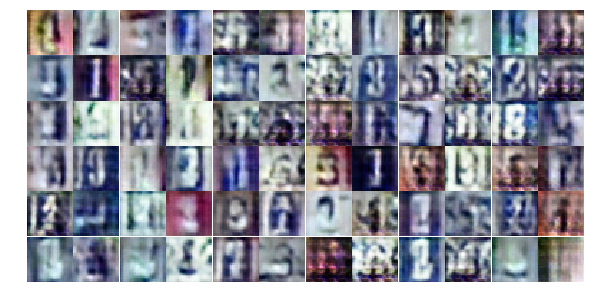

Epoch 18/25... Discriminator Loss: 1.3177... Generator Loss: 0.7805
Epoch 18/25... Discriminator Loss: 1.2617... Generator Loss: 0.7206
Epoch 18/25... Discriminator Loss: 1.4104... Generator Loss: 0.6473
Epoch 18/25... Discriminator Loss: 1.3478... Generator Loss: 0.6282
Epoch 18/25... Discriminator Loss: 1.2916... Generator Loss: 0.6931
Epoch 18/25... Discriminator Loss: 1.4661... Generator Loss: 0.6817
Epoch 18/25... Discriminator Loss: 1.2818... Generator Loss: 0.6834
Epoch 18/25... Discriminator Loss: 1.1429... Generator Loss: 0.9257
Epoch 18/25... Discriminator Loss: 1.2258... Generator Loss: 0.8289
Epoch 18/25... Discriminator Loss: 1.4510... Generator Loss: 0.6430


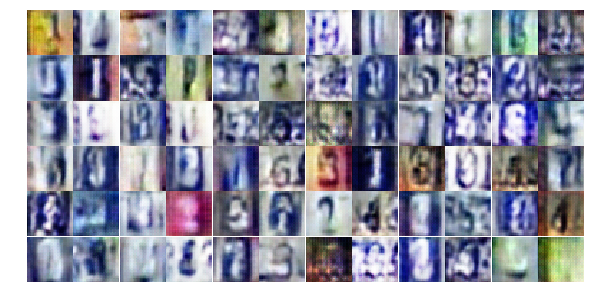

Epoch 18/25... Discriminator Loss: 1.3629... Generator Loss: 0.7495
Epoch 18/25... Discriminator Loss: 1.3530... Generator Loss: 0.7039
Epoch 18/25... Discriminator Loss: 1.2361... Generator Loss: 0.8114
Epoch 18/25... Discriminator Loss: 1.4035... Generator Loss: 0.6359
Epoch 18/25... Discriminator Loss: 1.3629... Generator Loss: 0.6813
Epoch 18/25... Discriminator Loss: 1.3370... Generator Loss: 0.8299
Epoch 18/25... Discriminator Loss: 1.4154... Generator Loss: 0.7300
Epoch 18/25... Discriminator Loss: 1.3681... Generator Loss: 0.7509
Epoch 18/25... Discriminator Loss: 1.2772... Generator Loss: 0.7362
Epoch 18/25... Discriminator Loss: 1.3131... Generator Loss: 0.7048


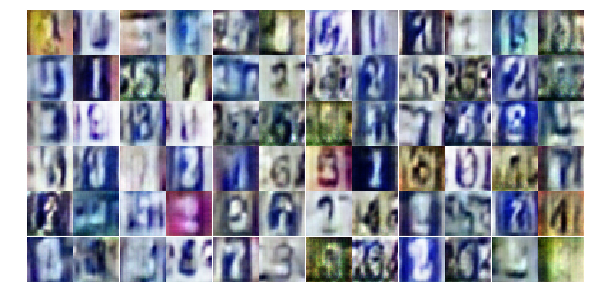

Epoch 18/25... Discriminator Loss: 1.2674... Generator Loss: 0.7430
Epoch 18/25... Discriminator Loss: 1.3519... Generator Loss: 0.6946
Epoch 18/25... Discriminator Loss: 1.3758... Generator Loss: 0.7108
Epoch 18/25... Discriminator Loss: 1.2814... Generator Loss: 0.7710
Epoch 18/25... Discriminator Loss: 1.3538... Generator Loss: 0.6978
Epoch 18/25... Discriminator Loss: 1.2805... Generator Loss: 0.7886
Epoch 18/25... Discriminator Loss: 1.3176... Generator Loss: 0.7105
Epoch 18/25... Discriminator Loss: 1.2804... Generator Loss: 0.7960
Epoch 18/25... Discriminator Loss: 1.3662... Generator Loss: 0.6505
Epoch 18/25... Discriminator Loss: 1.2485... Generator Loss: 0.8277


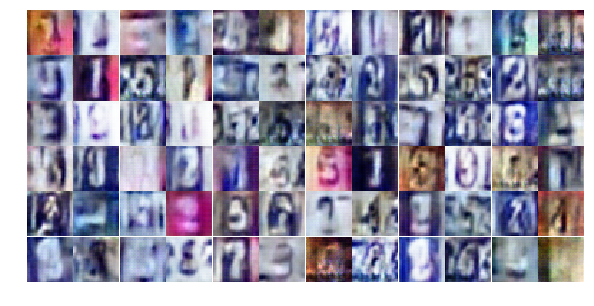

Epoch 18/25... Discriminator Loss: 1.4909... Generator Loss: 0.6166
Epoch 19/25... Discriminator Loss: 1.3647... Generator Loss: 0.7182
Epoch 19/25... Discriminator Loss: 1.4337... Generator Loss: 0.6648
Epoch 19/25... Discriminator Loss: 1.4351... Generator Loss: 0.7127
Epoch 19/25... Discriminator Loss: 1.2994... Generator Loss: 0.8667
Epoch 19/25... Discriminator Loss: 1.3099... Generator Loss: 0.7304
Epoch 19/25... Discriminator Loss: 1.3694... Generator Loss: 0.6912
Epoch 19/25... Discriminator Loss: 1.3037... Generator Loss: 0.8353
Epoch 19/25... Discriminator Loss: 1.3380... Generator Loss: 0.6926
Epoch 19/25... Discriminator Loss: 1.3664... Generator Loss: 0.6745


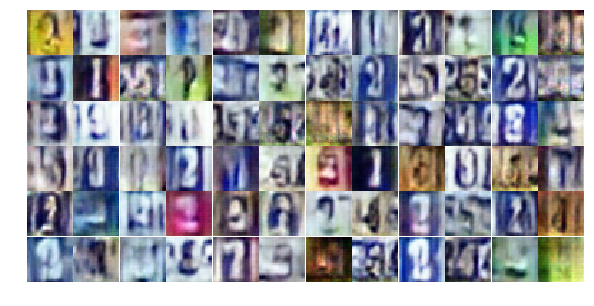

Epoch 19/25... Discriminator Loss: 1.3387... Generator Loss: 0.7385
Epoch 19/25... Discriminator Loss: 1.3230... Generator Loss: 0.7079
Epoch 19/25... Discriminator Loss: 1.3319... Generator Loss: 0.7124
Epoch 19/25... Discriminator Loss: 1.3737... Generator Loss: 0.7043
Epoch 19/25... Discriminator Loss: 1.4035... Generator Loss: 0.6685
Epoch 19/25... Discriminator Loss: 1.3643... Generator Loss: 0.6293
Epoch 19/25... Discriminator Loss: 1.2851... Generator Loss: 0.6947
Epoch 19/25... Discriminator Loss: 1.3132... Generator Loss: 0.7664
Epoch 19/25... Discriminator Loss: 1.3714... Generator Loss: 0.5744
Epoch 19/25... Discriminator Loss: 1.3649... Generator Loss: 0.7697


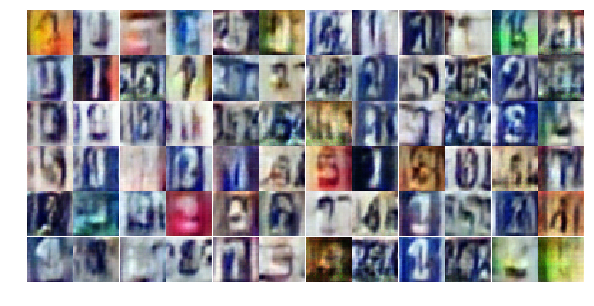

Epoch 19/25... Discriminator Loss: 1.4987... Generator Loss: 0.6066
Epoch 19/25... Discriminator Loss: 1.3124... Generator Loss: 0.6711
Epoch 19/25... Discriminator Loss: 1.4112... Generator Loss: 0.6537
Epoch 19/25... Discriminator Loss: 1.3525... Generator Loss: 0.6828
Epoch 19/25... Discriminator Loss: 1.1927... Generator Loss: 0.7770
Epoch 19/25... Discriminator Loss: 1.3598... Generator Loss: 0.6331
Epoch 19/25... Discriminator Loss: 1.1563... Generator Loss: 0.8727
Epoch 19/25... Discriminator Loss: 1.3512... Generator Loss: 0.6242
Epoch 19/25... Discriminator Loss: 1.3363... Generator Loss: 0.6564
Epoch 19/25... Discriminator Loss: 1.3049... Generator Loss: 0.8291


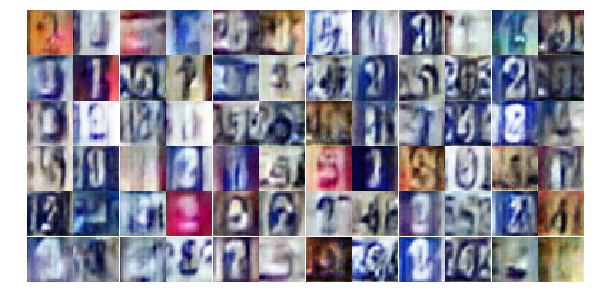

Epoch 19/25... Discriminator Loss: 1.2870... Generator Loss: 0.9017
Epoch 19/25... Discriminator Loss: 1.3672... Generator Loss: 0.7109
Epoch 19/25... Discriminator Loss: 1.2907... Generator Loss: 0.7689
Epoch 19/25... Discriminator Loss: 1.3281... Generator Loss: 0.6885
Epoch 19/25... Discriminator Loss: 1.3604... Generator Loss: 0.7469
Epoch 19/25... Discriminator Loss: 1.1156... Generator Loss: 0.8230
Epoch 19/25... Discriminator Loss: 1.1780... Generator Loss: 0.7764
Epoch 19/25... Discriminator Loss: 1.3548... Generator Loss: 0.7765
Epoch 19/25... Discriminator Loss: 1.2965... Generator Loss: 0.7623
Epoch 19/25... Discriminator Loss: 1.3210... Generator Loss: 0.6999


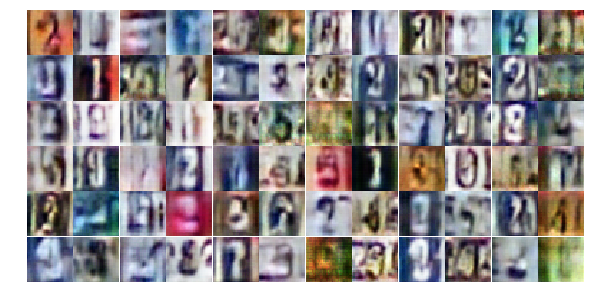

Epoch 19/25... Discriminator Loss: 1.3436... Generator Loss: 0.6726
Epoch 19/25... Discriminator Loss: 1.3526... Generator Loss: 0.7437
Epoch 19/25... Discriminator Loss: 1.2741... Generator Loss: 0.7969
Epoch 19/25... Discriminator Loss: 1.2812... Generator Loss: 0.7618
Epoch 19/25... Discriminator Loss: 1.4059... Generator Loss: 0.5946
Epoch 19/25... Discriminator Loss: 1.3940... Generator Loss: 0.6288
Epoch 19/25... Discriminator Loss: 1.3047... Generator Loss: 0.7516
Epoch 19/25... Discriminator Loss: 1.3722... Generator Loss: 0.7015
Epoch 19/25... Discriminator Loss: 1.3626... Generator Loss: 0.7225
Epoch 19/25... Discriminator Loss: 1.2637... Generator Loss: 0.7864


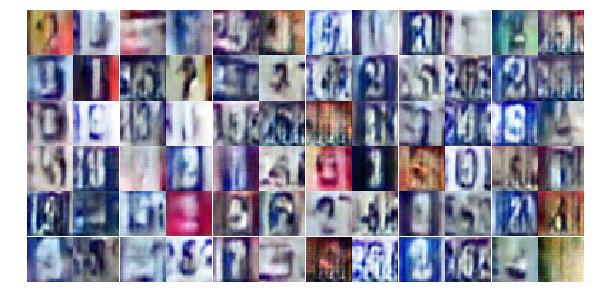

Epoch 19/25... Discriminator Loss: 1.3489... Generator Loss: 0.6993
Epoch 19/25... Discriminator Loss: 1.2435... Generator Loss: 0.8323
Epoch 19/25... Discriminator Loss: 1.3853... Generator Loss: 0.6505
Epoch 19/25... Discriminator Loss: 1.3418... Generator Loss: 0.6489
Epoch 19/25... Discriminator Loss: 1.4389... Generator Loss: 0.6111
Epoch 19/25... Discriminator Loss: 1.2510... Generator Loss: 0.7224
Epoch 19/25... Discriminator Loss: 1.1698... Generator Loss: 0.8008
Epoch 19/25... Discriminator Loss: 1.4841... Generator Loss: 0.7857
Epoch 20/25... Discriminator Loss: 1.3846... Generator Loss: 0.6369
Epoch 20/25... Discriminator Loss: 1.2908... Generator Loss: 0.7497


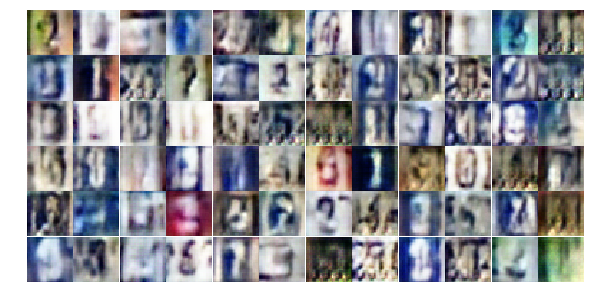

Epoch 20/25... Discriminator Loss: 1.4237... Generator Loss: 0.6736
Epoch 20/25... Discriminator Loss: 1.3084... Generator Loss: 0.7843
Epoch 20/25... Discriminator Loss: 1.3619... Generator Loss: 0.6952
Epoch 20/25... Discriminator Loss: 1.3462... Generator Loss: 0.7155
Epoch 20/25... Discriminator Loss: 1.4423... Generator Loss: 0.7015
Epoch 20/25... Discriminator Loss: 1.2522... Generator Loss: 0.7673
Epoch 20/25... Discriminator Loss: 1.3251... Generator Loss: 0.7186
Epoch 20/25... Discriminator Loss: 1.2979... Generator Loss: 0.7737
Epoch 20/25... Discriminator Loss: 1.3693... Generator Loss: 0.6951
Epoch 20/25... Discriminator Loss: 1.2865... Generator Loss: 0.7141


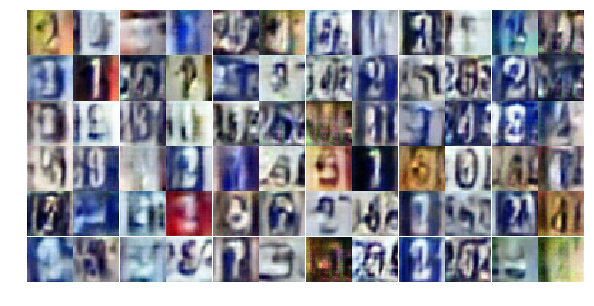

Epoch 20/25... Discriminator Loss: 1.3548... Generator Loss: 0.7263
Epoch 20/25... Discriminator Loss: 1.3339... Generator Loss: 0.7063
Epoch 20/25... Discriminator Loss: 1.3356... Generator Loss: 0.7129
Epoch 20/25... Discriminator Loss: 1.1789... Generator Loss: 0.8283
Epoch 20/25... Discriminator Loss: 1.3283... Generator Loss: 0.7395
Epoch 20/25... Discriminator Loss: 1.3164... Generator Loss: 0.8332
Epoch 20/25... Discriminator Loss: 1.2886... Generator Loss: 0.7961
Epoch 20/25... Discriminator Loss: 1.2238... Generator Loss: 0.8046
Epoch 20/25... Discriminator Loss: 1.3209... Generator Loss: 0.7759
Epoch 20/25... Discriminator Loss: 1.3592... Generator Loss: 0.6931


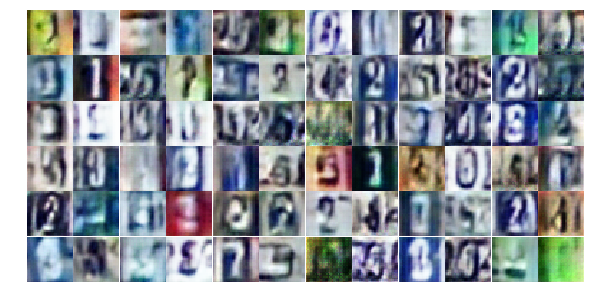

Epoch 20/25... Discriminator Loss: 1.3298... Generator Loss: 0.7376
Epoch 20/25... Discriminator Loss: 1.3527... Generator Loss: 0.7040
Epoch 20/25... Discriminator Loss: 1.3702... Generator Loss: 0.7389
Epoch 20/25... Discriminator Loss: 1.2772... Generator Loss: 0.9134
Epoch 20/25... Discriminator Loss: 1.2783... Generator Loss: 0.7561
Epoch 20/25... Discriminator Loss: 1.2915... Generator Loss: 0.7375
Epoch 20/25... Discriminator Loss: 1.3630... Generator Loss: 0.6254
Epoch 20/25... Discriminator Loss: 1.2890... Generator Loss: 0.7182
Epoch 20/25... Discriminator Loss: 1.3166... Generator Loss: 0.7311
Epoch 20/25... Discriminator Loss: 1.1821... Generator Loss: 0.8320


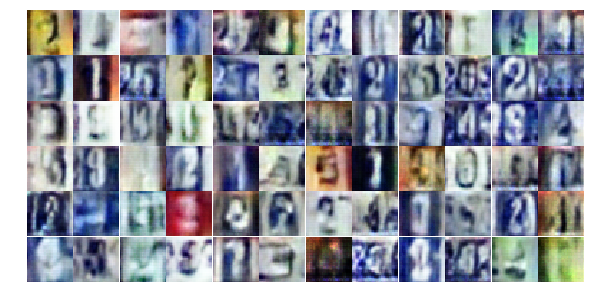

Epoch 20/25... Discriminator Loss: 1.2515... Generator Loss: 0.6814
Epoch 20/25... Discriminator Loss: 1.3101... Generator Loss: 0.7508
Epoch 20/25... Discriminator Loss: 1.3138... Generator Loss: 0.7265
Epoch 20/25... Discriminator Loss: 1.2882... Generator Loss: 0.7642
Epoch 20/25... Discriminator Loss: 1.3167... Generator Loss: 0.7445
Epoch 20/25... Discriminator Loss: 1.3313... Generator Loss: 0.7790
Epoch 20/25... Discriminator Loss: 1.3159... Generator Loss: 0.6877
Epoch 20/25... Discriminator Loss: 1.2701... Generator Loss: 0.8058
Epoch 20/25... Discriminator Loss: 1.4051... Generator Loss: 0.5921
Epoch 20/25... Discriminator Loss: 1.2926... Generator Loss: 0.7367


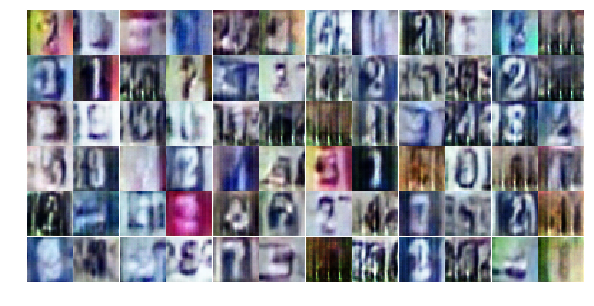

Epoch 20/25... Discriminator Loss: 1.3798... Generator Loss: 0.7019
Epoch 20/25... Discriminator Loss: 1.3531... Generator Loss: 0.7201
Epoch 20/25... Discriminator Loss: 1.3806... Generator Loss: 0.7071
Epoch 20/25... Discriminator Loss: 1.3448... Generator Loss: 0.8369
Epoch 20/25... Discriminator Loss: 1.2564... Generator Loss: 0.7326
Epoch 20/25... Discriminator Loss: 1.4134... Generator Loss: 0.6603
Epoch 20/25... Discriminator Loss: 1.3712... Generator Loss: 0.7282
Epoch 20/25... Discriminator Loss: 1.4124... Generator Loss: 0.7332
Epoch 20/25... Discriminator Loss: 1.4558... Generator Loss: 0.6910
Epoch 20/25... Discriminator Loss: 1.2967... Generator Loss: 0.7831


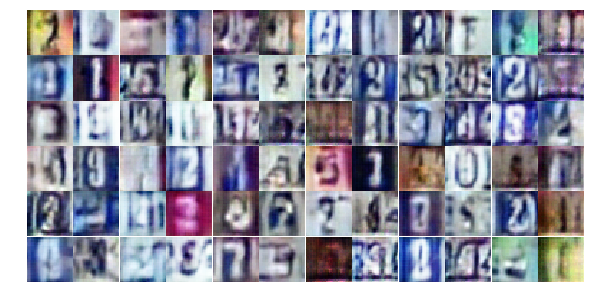

Epoch 20/25... Discriminator Loss: 1.3662... Generator Loss: 0.8866
Epoch 20/25... Discriminator Loss: 1.3081... Generator Loss: 0.7195
Epoch 20/25... Discriminator Loss: 1.3240... Generator Loss: 0.7800
Epoch 20/25... Discriminator Loss: 1.3943... Generator Loss: 0.6805
Epoch 20/25... Discriminator Loss: 1.2874... Generator Loss: 0.8787
Epoch 20/25... Discriminator Loss: 1.0320... Generator Loss: 0.9445
Epoch 21/25... Discriminator Loss: 1.4106... Generator Loss: 0.6730
Epoch 21/25... Discriminator Loss: 1.2134... Generator Loss: 0.7761
Epoch 21/25... Discriminator Loss: 1.3646... Generator Loss: 0.5835
Epoch 21/25... Discriminator Loss: 1.3629... Generator Loss: 0.6504


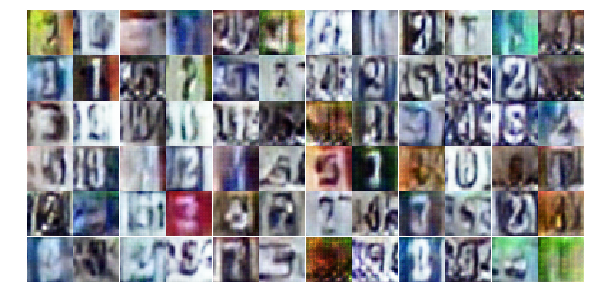

Epoch 21/25... Discriminator Loss: 1.3071... Generator Loss: 0.8126
Epoch 21/25... Discriminator Loss: 1.3522... Generator Loss: 0.6446
Epoch 21/25... Discriminator Loss: 1.3056... Generator Loss: 0.7784
Epoch 21/25... Discriminator Loss: 1.2164... Generator Loss: 0.8775
Epoch 21/25... Discriminator Loss: 1.2935... Generator Loss: 0.6987
Epoch 21/25... Discriminator Loss: 1.2949... Generator Loss: 0.8619
Epoch 21/25... Discriminator Loss: 1.2895... Generator Loss: 0.7649
Epoch 21/25... Discriminator Loss: 1.3017... Generator Loss: 0.7502
Epoch 21/25... Discriminator Loss: 1.3312... Generator Loss: 0.7914
Epoch 21/25... Discriminator Loss: 1.2847... Generator Loss: 0.7591


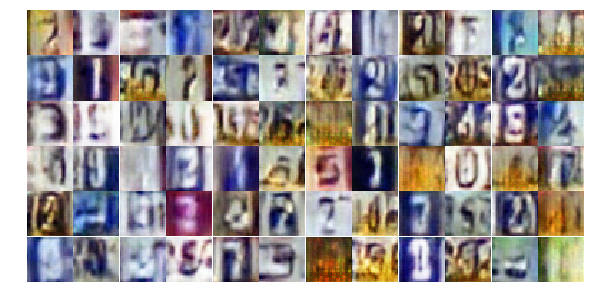

Epoch 21/25... Discriminator Loss: 1.3046... Generator Loss: 0.7784
Epoch 21/25... Discriminator Loss: 1.4234... Generator Loss: 0.7589
Epoch 21/25... Discriminator Loss: 1.3845... Generator Loss: 0.7257
Epoch 21/25... Discriminator Loss: 1.4924... Generator Loss: 0.5955
Epoch 21/25... Discriminator Loss: 1.2828... Generator Loss: 1.0015
Epoch 21/25... Discriminator Loss: 1.5844... Generator Loss: 0.7535
Epoch 21/25... Discriminator Loss: 1.2630... Generator Loss: 0.7442
Epoch 21/25... Discriminator Loss: 1.4628... Generator Loss: 0.7707
Epoch 21/25... Discriminator Loss: 1.3568... Generator Loss: 0.8084
Epoch 21/25... Discriminator Loss: 1.2880... Generator Loss: 0.7550


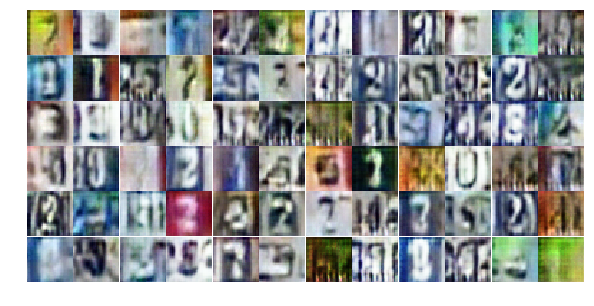

Epoch 21/25... Discriminator Loss: 1.4354... Generator Loss: 0.6913
Epoch 21/25... Discriminator Loss: 1.3438... Generator Loss: 0.7563
Epoch 21/25... Discriminator Loss: 1.3664... Generator Loss: 0.7175
Epoch 21/25... Discriminator Loss: 1.3554... Generator Loss: 0.6822
Epoch 21/25... Discriminator Loss: 1.4083... Generator Loss: 0.6843
Epoch 21/25... Discriminator Loss: 1.4369... Generator Loss: 0.6349
Epoch 21/25... Discriminator Loss: 1.3774... Generator Loss: 0.7307
Epoch 21/25... Discriminator Loss: 1.4063... Generator Loss: 0.6633
Epoch 21/25... Discriminator Loss: 1.2195... Generator Loss: 0.7924
Epoch 21/25... Discriminator Loss: 1.4808... Generator Loss: 0.6986


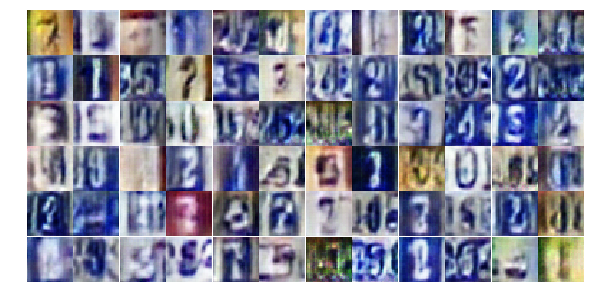

Epoch 21/25... Discriminator Loss: 1.4414... Generator Loss: 0.6760
Epoch 21/25... Discriminator Loss: 1.3015... Generator Loss: 0.8020
Epoch 21/25... Discriminator Loss: 1.4504... Generator Loss: 0.6273
Epoch 21/25... Discriminator Loss: 1.2657... Generator Loss: 0.7762
Epoch 21/25... Discriminator Loss: 1.2319... Generator Loss: 0.7964
Epoch 21/25... Discriminator Loss: 1.4323... Generator Loss: 0.7198
Epoch 21/25... Discriminator Loss: 1.2452... Generator Loss: 0.8226
Epoch 21/25... Discriminator Loss: 1.3195... Generator Loss: 0.7041
Epoch 21/25... Discriminator Loss: 1.2388... Generator Loss: 0.7885
Epoch 21/25... Discriminator Loss: 1.3043... Generator Loss: 0.8156


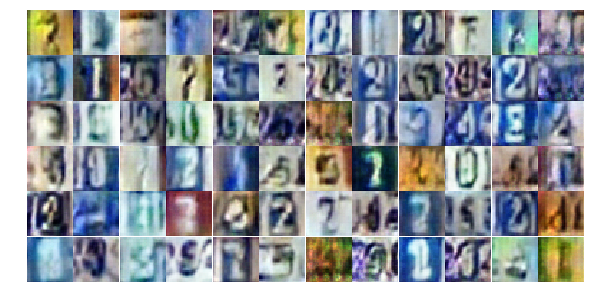

Epoch 21/25... Discriminator Loss: 1.4015... Generator Loss: 0.6005
Epoch 21/25... Discriminator Loss: 1.3708... Generator Loss: 0.6991
Epoch 21/25... Discriminator Loss: 1.2807... Generator Loss: 0.7924
Epoch 21/25... Discriminator Loss: 1.3553... Generator Loss: 0.7541
Epoch 21/25... Discriminator Loss: 1.2898... Generator Loss: 0.7899
Epoch 21/25... Discriminator Loss: 1.4129... Generator Loss: 0.6969
Epoch 21/25... Discriminator Loss: 1.4064... Generator Loss: 0.7142
Epoch 21/25... Discriminator Loss: 1.3080... Generator Loss: 0.6372
Epoch 21/25... Discriminator Loss: 1.3151... Generator Loss: 0.8609
Epoch 21/25... Discriminator Loss: 1.4264... Generator Loss: 0.7369


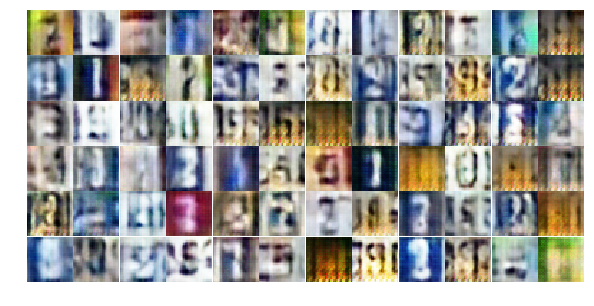

Epoch 21/25... Discriminator Loss: 1.4383... Generator Loss: 0.6759
Epoch 21/25... Discriminator Loss: 1.3563... Generator Loss: 0.7237
Epoch 21/25... Discriminator Loss: 1.2451... Generator Loss: 0.7189
Epoch 22/25... Discriminator Loss: 1.4682... Generator Loss: 0.6377
Epoch 22/25... Discriminator Loss: 1.2779... Generator Loss: 0.7294
Epoch 22/25... Discriminator Loss: 1.2808... Generator Loss: 0.7145
Epoch 22/25... Discriminator Loss: 1.4510... Generator Loss: 0.6806
Epoch 22/25... Discriminator Loss: 1.3695... Generator Loss: 0.7309
Epoch 22/25... Discriminator Loss: 1.3020... Generator Loss: 0.7277
Epoch 22/25... Discriminator Loss: 1.3954... Generator Loss: 0.7228


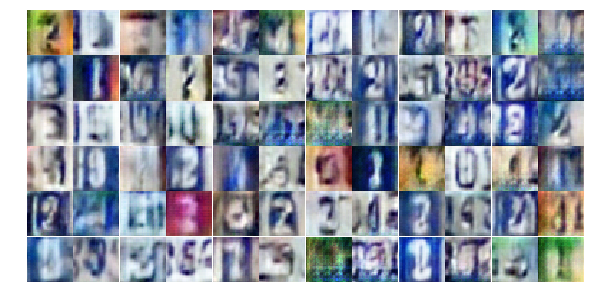

Epoch 22/25... Discriminator Loss: 1.2849... Generator Loss: 0.7263
Epoch 22/25... Discriminator Loss: 1.3266... Generator Loss: 0.7535
Epoch 22/25... Discriminator Loss: 1.3692... Generator Loss: 0.6709
Epoch 22/25... Discriminator Loss: 1.2500... Generator Loss: 0.7911
Epoch 22/25... Discriminator Loss: 1.3246... Generator Loss: 0.7161
Epoch 22/25... Discriminator Loss: 1.3071... Generator Loss: 0.7312
Epoch 22/25... Discriminator Loss: 1.3522... Generator Loss: 0.6962
Epoch 22/25... Discriminator Loss: 1.3282... Generator Loss: 0.7217
Epoch 22/25... Discriminator Loss: 1.4602... Generator Loss: 0.6953
Epoch 22/25... Discriminator Loss: 1.4040... Generator Loss: 0.6524


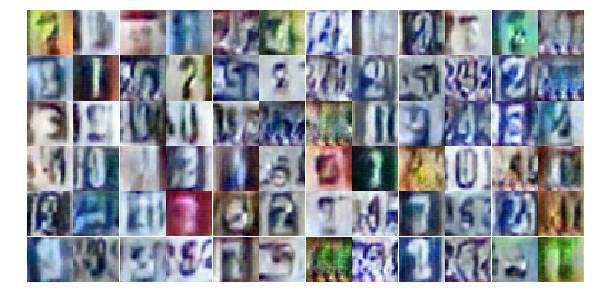

Epoch 22/25... Discriminator Loss: 1.3162... Generator Loss: 0.6849
Epoch 22/25... Discriminator Loss: 1.2642... Generator Loss: 0.7530
Epoch 22/25... Discriminator Loss: 1.3952... Generator Loss: 0.7163
Epoch 22/25... Discriminator Loss: 1.2914... Generator Loss: 0.7466
Epoch 22/25... Discriminator Loss: 1.3523... Generator Loss: 0.7417
Epoch 22/25... Discriminator Loss: 1.4144... Generator Loss: 0.6267
Epoch 22/25... Discriminator Loss: 1.4346... Generator Loss: 0.6838
Epoch 22/25... Discriminator Loss: 1.1233... Generator Loss: 0.9528
Epoch 22/25... Discriminator Loss: 1.2479... Generator Loss: 0.9651
Epoch 22/25... Discriminator Loss: 1.3814... Generator Loss: 0.7569


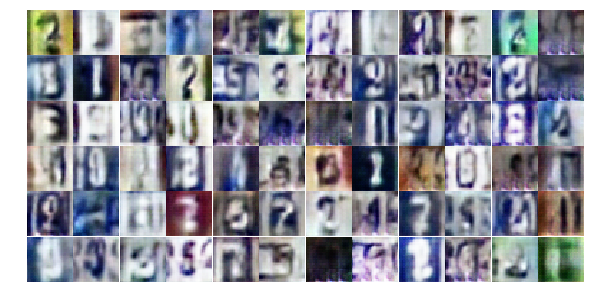

Epoch 22/25... Discriminator Loss: 1.2670... Generator Loss: 0.8258
Epoch 22/25... Discriminator Loss: 1.2672... Generator Loss: 0.7820
Epoch 22/25... Discriminator Loss: 1.1558... Generator Loss: 0.8419
Epoch 22/25... Discriminator Loss: 1.3880... Generator Loss: 0.7019
Epoch 22/25... Discriminator Loss: 1.3413... Generator Loss: 0.6691
Epoch 22/25... Discriminator Loss: 1.3088... Generator Loss: 0.6611
Epoch 22/25... Discriminator Loss: 1.4871... Generator Loss: 0.5998
Epoch 22/25... Discriminator Loss: 1.3892... Generator Loss: 0.7866
Epoch 22/25... Discriminator Loss: 1.3575... Generator Loss: 0.7030
Epoch 22/25... Discriminator Loss: 1.3729... Generator Loss: 0.7397


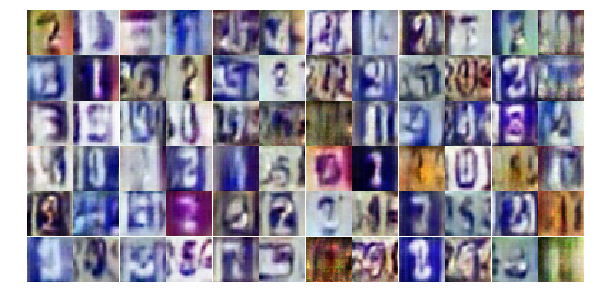

Epoch 22/25... Discriminator Loss: 1.3840... Generator Loss: 0.7061
Epoch 22/25... Discriminator Loss: 1.3587... Generator Loss: 0.7720
Epoch 22/25... Discriminator Loss: 1.2058... Generator Loss: 0.8311
Epoch 22/25... Discriminator Loss: 1.4203... Generator Loss: 0.6919
Epoch 22/25... Discriminator Loss: 1.3842... Generator Loss: 0.7562
Epoch 22/25... Discriminator Loss: 1.2699... Generator Loss: 0.7601
Epoch 22/25... Discriminator Loss: 1.3456... Generator Loss: 0.7575
Epoch 22/25... Discriminator Loss: 1.2808... Generator Loss: 0.7937
Epoch 22/25... Discriminator Loss: 1.3790... Generator Loss: 0.6819
Epoch 22/25... Discriminator Loss: 1.3160... Generator Loss: 0.7449


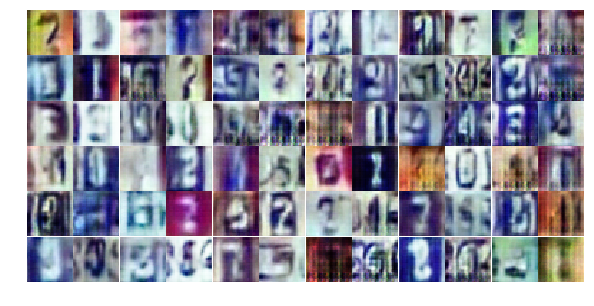

Epoch 22/25... Discriminator Loss: 1.4172... Generator Loss: 0.6591
Epoch 22/25... Discriminator Loss: 1.3642... Generator Loss: 0.6796
Epoch 22/25... Discriminator Loss: 1.4445... Generator Loss: 0.5656
Epoch 22/25... Discriminator Loss: 1.3033... Generator Loss: 0.7132
Epoch 22/25... Discriminator Loss: 1.3591... Generator Loss: 0.7330
Epoch 22/25... Discriminator Loss: 1.4157... Generator Loss: 0.7229
Epoch 22/25... Discriminator Loss: 1.4260... Generator Loss: 0.6723
Epoch 22/25... Discriminator Loss: 1.3423... Generator Loss: 0.7333
Epoch 22/25... Discriminator Loss: 1.3530... Generator Loss: 0.6676
Epoch 22/25... Discriminator Loss: 1.3792... Generator Loss: 0.7948


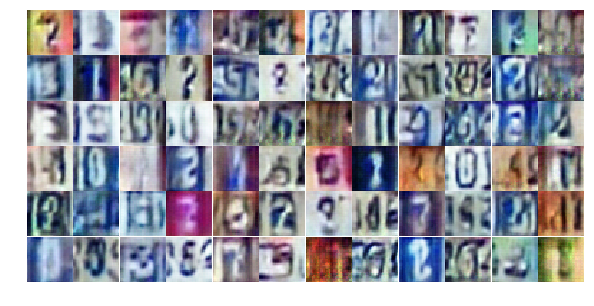

Epoch 23/25... Discriminator Loss: 1.1081... Generator Loss: 0.9818
Epoch 23/25... Discriminator Loss: 1.3946... Generator Loss: 0.7314
Epoch 23/25... Discriminator Loss: 1.3921... Generator Loss: 0.6901
Epoch 23/25... Discriminator Loss: 1.5511... Generator Loss: 0.6299
Epoch 23/25... Discriminator Loss: 1.4422... Generator Loss: 0.5592
Epoch 23/25... Discriminator Loss: 1.3284... Generator Loss: 0.7246
Epoch 23/25... Discriminator Loss: 1.3729... Generator Loss: 0.6867
Epoch 23/25... Discriminator Loss: 1.3098... Generator Loss: 0.6967
Epoch 23/25... Discriminator Loss: 1.4211... Generator Loss: 0.6993
Epoch 23/25... Discriminator Loss: 1.2422... Generator Loss: 0.7824


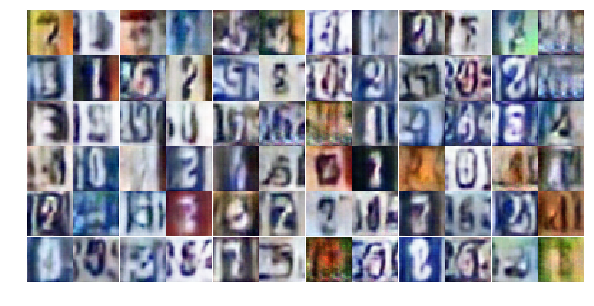

Epoch 23/25... Discriminator Loss: 1.4115... Generator Loss: 0.7085
Epoch 23/25... Discriminator Loss: 1.2913... Generator Loss: 0.7329
Epoch 23/25... Discriminator Loss: 1.3428... Generator Loss: 0.7523
Epoch 23/25... Discriminator Loss: 1.3416... Generator Loss: 0.6793
Epoch 23/25... Discriminator Loss: 1.3485... Generator Loss: 0.7030
Epoch 23/25... Discriminator Loss: 1.3937... Generator Loss: 0.7100
Epoch 23/25... Discriminator Loss: 1.2899... Generator Loss: 0.6472
Epoch 23/25... Discriminator Loss: 1.3477... Generator Loss: 0.7322
Epoch 23/25... Discriminator Loss: 1.3243... Generator Loss: 0.6878
Epoch 23/25... Discriminator Loss: 1.2799... Generator Loss: 0.7870


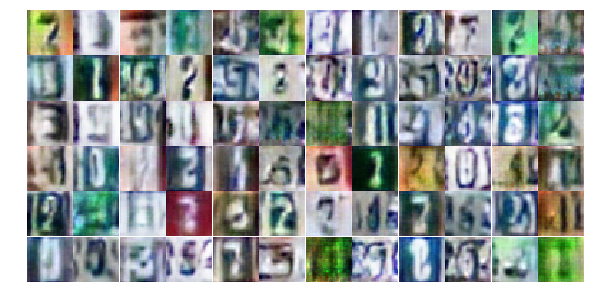

Epoch 23/25... Discriminator Loss: 1.3254... Generator Loss: 0.7423
Epoch 23/25... Discriminator Loss: 1.3713... Generator Loss: 0.7401
Epoch 23/25... Discriminator Loss: 1.2514... Generator Loss: 0.8076
Epoch 23/25... Discriminator Loss: 1.2446... Generator Loss: 0.6994
Epoch 23/25... Discriminator Loss: 1.3156... Generator Loss: 0.7976
Epoch 23/25... Discriminator Loss: 1.3060... Generator Loss: 0.7530
Epoch 23/25... Discriminator Loss: 1.2938... Generator Loss: 0.8233
Epoch 23/25... Discriminator Loss: 1.2993... Generator Loss: 0.7600
Epoch 23/25... Discriminator Loss: 1.3990... Generator Loss: 0.6972
Epoch 23/25... Discriminator Loss: 1.3277... Generator Loss: 0.6392


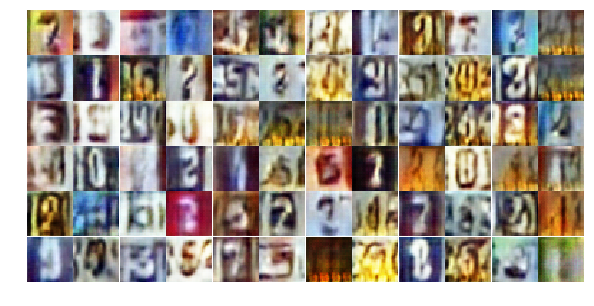

Epoch 23/25... Discriminator Loss: 1.4334... Generator Loss: 0.6293
Epoch 23/25... Discriminator Loss: 1.3426... Generator Loss: 0.7853
Epoch 23/25... Discriminator Loss: 1.3598... Generator Loss: 0.7657
Epoch 23/25... Discriminator Loss: 1.4499... Generator Loss: 0.6404
Epoch 23/25... Discriminator Loss: 1.4478... Generator Loss: 0.7260
Epoch 23/25... Discriminator Loss: 1.3945... Generator Loss: 0.7293
Epoch 23/25... Discriminator Loss: 1.3902... Generator Loss: 0.6346
Epoch 23/25... Discriminator Loss: 1.2833... Generator Loss: 0.8783
Epoch 23/25... Discriminator Loss: 1.4385... Generator Loss: 0.7442
Epoch 23/25... Discriminator Loss: 1.3166... Generator Loss: 0.7100


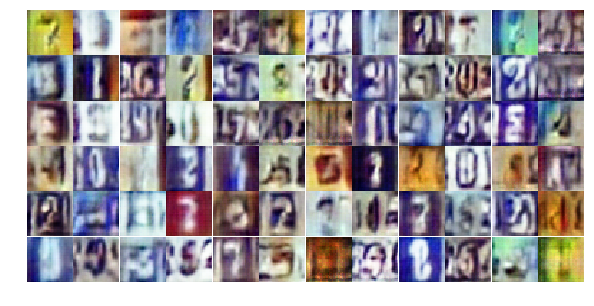

Epoch 23/25... Discriminator Loss: 1.3673... Generator Loss: 0.6835
Epoch 23/25... Discriminator Loss: 1.3725... Generator Loss: 0.6672
Epoch 23/25... Discriminator Loss: 1.4061... Generator Loss: 0.6755
Epoch 23/25... Discriminator Loss: 1.3703... Generator Loss: 0.7503
Epoch 23/25... Discriminator Loss: 1.3807... Generator Loss: 1.1554
Epoch 23/25... Discriminator Loss: 1.3222... Generator Loss: 0.7612
Epoch 23/25... Discriminator Loss: 1.3666... Generator Loss: 0.7255
Epoch 23/25... Discriminator Loss: 1.3348... Generator Loss: 0.6812
Epoch 23/25... Discriminator Loss: 1.3185... Generator Loss: 0.7184
Epoch 23/25... Discriminator Loss: 1.4228... Generator Loss: 0.7065


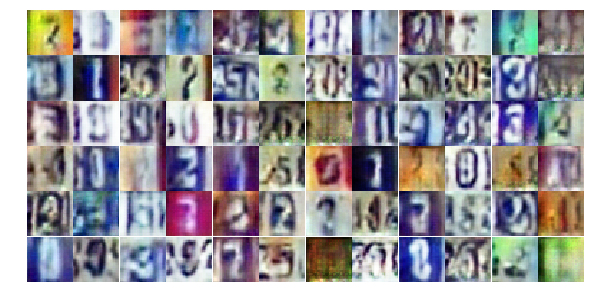

Epoch 23/25... Discriminator Loss: 1.3692... Generator Loss: 0.7171
Epoch 23/25... Discriminator Loss: 1.4313... Generator Loss: 0.7122
Epoch 23/25... Discriminator Loss: 1.1622... Generator Loss: 0.8756
Epoch 23/25... Discriminator Loss: 1.2111... Generator Loss: 0.7761
Epoch 23/25... Discriminator Loss: 1.2801... Generator Loss: 0.7681
Epoch 23/25... Discriminator Loss: 1.5419... Generator Loss: 0.6675
Epoch 23/25... Discriminator Loss: 1.3672... Generator Loss: 0.6858
Epoch 24/25... Discriminator Loss: 1.2479... Generator Loss: 0.7735
Epoch 24/25... Discriminator Loss: 1.3289... Generator Loss: 0.6889
Epoch 24/25... Discriminator Loss: 1.3942... Generator Loss: 0.6522


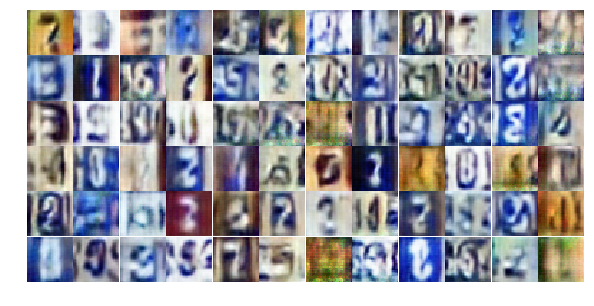

Epoch 24/25... Discriminator Loss: 1.2249... Generator Loss: 0.7149
Epoch 24/25... Discriminator Loss: 1.3448... Generator Loss: 0.7868
Epoch 24/25... Discriminator Loss: 1.4569... Generator Loss: 0.7070
Epoch 24/25... Discriminator Loss: 1.4249... Generator Loss: 0.6874
Epoch 24/25... Discriminator Loss: 1.2070... Generator Loss: 0.7301
Epoch 24/25... Discriminator Loss: 1.3257... Generator Loss: 0.6918
Epoch 24/25... Discriminator Loss: 1.4603... Generator Loss: 0.6495
Epoch 24/25... Discriminator Loss: 1.4207... Generator Loss: 0.7107
Epoch 24/25... Discriminator Loss: 1.3281... Generator Loss: 0.7560
Epoch 24/25... Discriminator Loss: 1.3955... Generator Loss: 0.7748


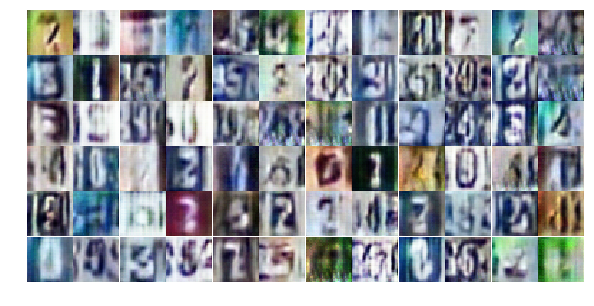

Epoch 24/25... Discriminator Loss: 1.3464... Generator Loss: 0.6390
Epoch 24/25... Discriminator Loss: 1.4851... Generator Loss: 0.6831
Epoch 24/25... Discriminator Loss: 1.2975... Generator Loss: 0.7517
Epoch 24/25... Discriminator Loss: 1.2604... Generator Loss: 0.7389
Epoch 24/25... Discriminator Loss: 1.3598... Generator Loss: 0.7285
Epoch 24/25... Discriminator Loss: 1.3556... Generator Loss: 0.6673
Epoch 24/25... Discriminator Loss: 1.3089... Generator Loss: 0.8374
Epoch 24/25... Discriminator Loss: 1.4367... Generator Loss: 0.7315
Epoch 24/25... Discriminator Loss: 1.4201... Generator Loss: 0.6469
Epoch 24/25... Discriminator Loss: 1.4093... Generator Loss: 0.7362


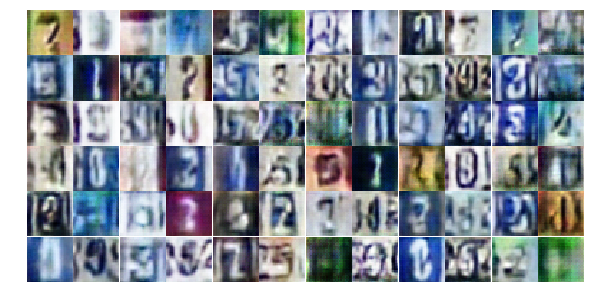

Epoch 24/25... Discriminator Loss: 1.1809... Generator Loss: 0.8431
Epoch 24/25... Discriminator Loss: 1.7438... Generator Loss: 0.5990
Epoch 24/25... Discriminator Loss: 1.2902... Generator Loss: 0.6950
Epoch 24/25... Discriminator Loss: 1.6870... Generator Loss: 0.6965
Epoch 24/25... Discriminator Loss: 1.3243... Generator Loss: 0.7871
Epoch 24/25... Discriminator Loss: 1.1898... Generator Loss: 0.8038
Epoch 24/25... Discriminator Loss: 1.2772... Generator Loss: 0.8574
Epoch 24/25... Discriminator Loss: 1.4474... Generator Loss: 0.6714
Epoch 24/25... Discriminator Loss: 1.4621... Generator Loss: 0.7074
Epoch 24/25... Discriminator Loss: 1.3354... Generator Loss: 0.7309


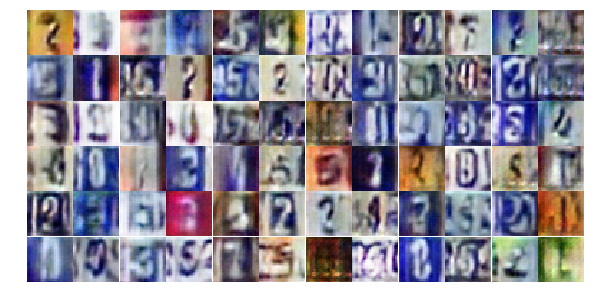

Epoch 24/25... Discriminator Loss: 1.2724... Generator Loss: 0.8221
Epoch 24/25... Discriminator Loss: 1.5404... Generator Loss: 0.6010
Epoch 24/25... Discriminator Loss: 1.3733... Generator Loss: 0.6894
Epoch 24/25... Discriminator Loss: 1.3684... Generator Loss: 0.6836
Epoch 24/25... Discriminator Loss: 1.4776... Generator Loss: 0.6612
Epoch 24/25... Discriminator Loss: 1.1162... Generator Loss: 0.8684
Epoch 24/25... Discriminator Loss: 1.3779... Generator Loss: 0.7361
Epoch 24/25... Discriminator Loss: 1.3740... Generator Loss: 0.6911
Epoch 24/25... Discriminator Loss: 1.4542... Generator Loss: 0.6585
Epoch 24/25... Discriminator Loss: 1.3068... Generator Loss: 0.6970


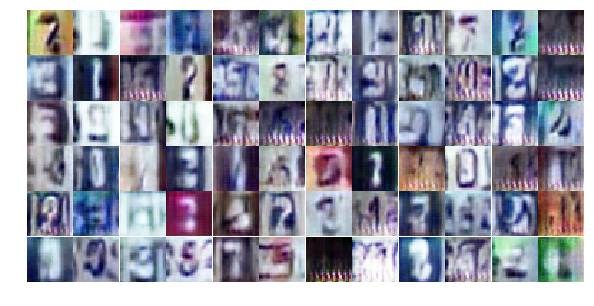

Epoch 24/25... Discriminator Loss: 1.3685... Generator Loss: 0.6429
Epoch 24/25... Discriminator Loss: 1.3251... Generator Loss: 0.7596
Epoch 24/25... Discriminator Loss: 1.3967... Generator Loss: 0.7221
Epoch 24/25... Discriminator Loss: 1.4301... Generator Loss: 0.6918
Epoch 24/25... Discriminator Loss: 1.3024... Generator Loss: 0.7639
Epoch 24/25... Discriminator Loss: 1.4615... Generator Loss: 0.6937
Epoch 24/25... Discriminator Loss: 1.4178... Generator Loss: 0.6839
Epoch 24/25... Discriminator Loss: 1.4019... Generator Loss: 0.7349
Epoch 24/25... Discriminator Loss: 1.3971... Generator Loss: 0.6891
Epoch 24/25... Discriminator Loss: 1.4050... Generator Loss: 0.6407


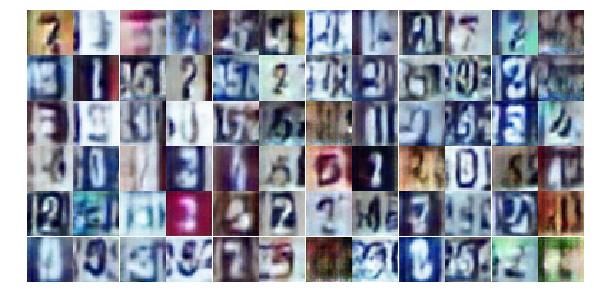

Epoch 24/25... Discriminator Loss: 1.3538... Generator Loss: 0.7154
Epoch 24/25... Discriminator Loss: 1.3282... Generator Loss: 0.7286
Epoch 24/25... Discriminator Loss: 1.6159... Generator Loss: 0.5669
Epoch 24/25... Discriminator Loss: 1.3319... Generator Loss: 0.7353
Epoch 24/25... Discriminator Loss: 1.4050... Generator Loss: 0.7038
Epoch 25/25... Discriminator Loss: 1.4066... Generator Loss: 0.6980
Epoch 25/25... Discriminator Loss: 1.2998... Generator Loss: 0.7621
Epoch 25/25... Discriminator Loss: 1.2759... Generator Loss: 0.6916
Epoch 25/25... Discriminator Loss: 1.3069... Generator Loss: 0.7335
Epoch 25/25... Discriminator Loss: 1.1644... Generator Loss: 0.8060


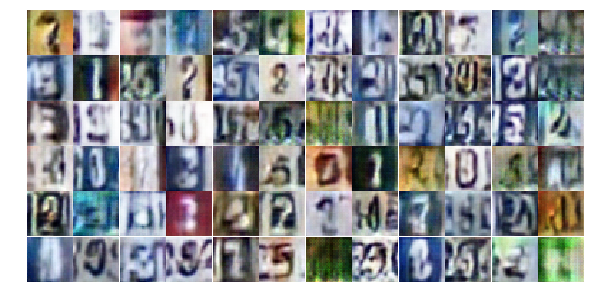

Epoch 25/25... Discriminator Loss: 1.3280... Generator Loss: 0.7262
Epoch 25/25... Discriminator Loss: 1.4671... Generator Loss: 0.6796
Epoch 25/25... Discriminator Loss: 1.2404... Generator Loss: 0.7561
Epoch 25/25... Discriminator Loss: 1.4360... Generator Loss: 0.6492
Epoch 25/25... Discriminator Loss: 1.3571... Generator Loss: 0.6817
Epoch 25/25... Discriminator Loss: 1.4450... Generator Loss: 0.6630
Epoch 25/25... Discriminator Loss: 1.3410... Generator Loss: 0.6148
Epoch 25/25... Discriminator Loss: 1.3206... Generator Loss: 0.7298
Epoch 25/25... Discriminator Loss: 1.3289... Generator Loss: 0.7859
Epoch 25/25... Discriminator Loss: 1.3978... Generator Loss: 0.6958


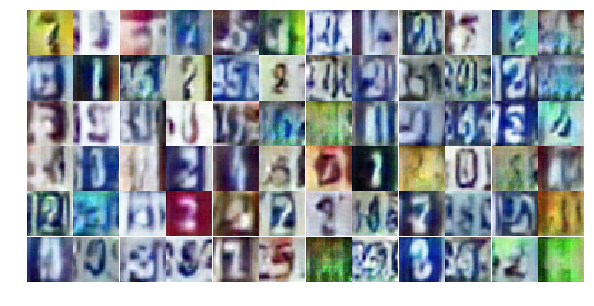

Epoch 25/25... Discriminator Loss: 1.3897... Generator Loss: 0.6381
Epoch 25/25... Discriminator Loss: 1.3139... Generator Loss: 0.6660
Epoch 25/25... Discriminator Loss: 1.3278... Generator Loss: 0.7036
Epoch 25/25... Discriminator Loss: 1.3953... Generator Loss: 0.7333
Epoch 25/25... Discriminator Loss: 1.5953... Generator Loss: 0.5722
Epoch 25/25... Discriminator Loss: 1.3808... Generator Loss: 0.8218
Epoch 25/25... Discriminator Loss: 1.2700... Generator Loss: 0.7286
Epoch 25/25... Discriminator Loss: 1.3921... Generator Loss: 0.6991
Epoch 25/25... Discriminator Loss: 1.4528... Generator Loss: 0.6836
Epoch 25/25... Discriminator Loss: 1.3827... Generator Loss: 0.7026


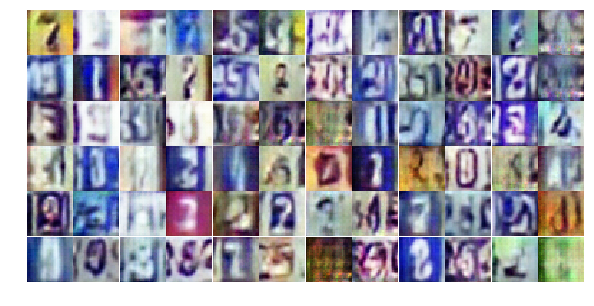

Epoch 25/25... Discriminator Loss: 1.4510... Generator Loss: 0.6741
Epoch 25/25... Discriminator Loss: 1.3107... Generator Loss: 0.8599
Epoch 25/25... Discriminator Loss: 1.4634... Generator Loss: 0.6600
Epoch 25/25... Discriminator Loss: 1.3348... Generator Loss: 0.7589
Epoch 25/25... Discriminator Loss: 1.3886... Generator Loss: 0.7301
Epoch 25/25... Discriminator Loss: 1.3564... Generator Loss: 0.6913
Epoch 25/25... Discriminator Loss: 1.4151... Generator Loss: 0.6915
Epoch 25/25... Discriminator Loss: 1.3951... Generator Loss: 0.6562
Epoch 25/25... Discriminator Loss: 1.3318... Generator Loss: 0.6585
Epoch 25/25... Discriminator Loss: 1.3252... Generator Loss: 0.6663


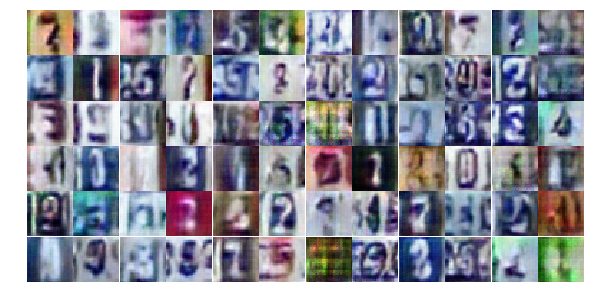

Epoch 25/25... Discriminator Loss: 1.3849... Generator Loss: 0.6911
Epoch 25/25... Discriminator Loss: 1.3530... Generator Loss: 0.7309
Epoch 25/25... Discriminator Loss: 1.3172... Generator Loss: 0.6845
Epoch 25/25... Discriminator Loss: 1.5662... Generator Loss: 0.6228
Epoch 25/25... Discriminator Loss: 1.4143... Generator Loss: 0.6800
Epoch 25/25... Discriminator Loss: 1.3768... Generator Loss: 0.6976
Epoch 25/25... Discriminator Loss: 1.1917... Generator Loss: 0.7798
Epoch 25/25... Discriminator Loss: 1.1738... Generator Loss: 0.7488
Epoch 25/25... Discriminator Loss: 1.3778... Generator Loss: 0.6190
Epoch 25/25... Discriminator Loss: 1.2304... Generator Loss: 0.8707


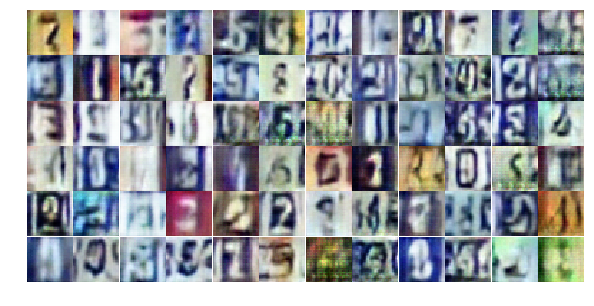

Epoch 25/25... Discriminator Loss: 1.5338... Generator Loss: 0.6719
Epoch 25/25... Discriminator Loss: 1.2262... Generator Loss: 0.7030
Epoch 25/25... Discriminator Loss: 1.4001... Generator Loss: 0.6369
Epoch 25/25... Discriminator Loss: 1.3315... Generator Loss: 0.6977
Epoch 25/25... Discriminator Loss: 1.3184... Generator Loss: 0.6625
Epoch 25/25... Discriminator Loss: 1.3547... Generator Loss: 0.6644
Epoch 25/25... Discriminator Loss: 1.3784... Generator Loss: 0.7359
Epoch 25/25... Discriminator Loss: 1.3229... Generator Loss: 0.8596
Epoch 25/25... Discriminator Loss: 1.3779... Generator Loss: 0.7048
Epoch 25/25... Discriminator Loss: 1.3031... Generator Loss: 0.7294


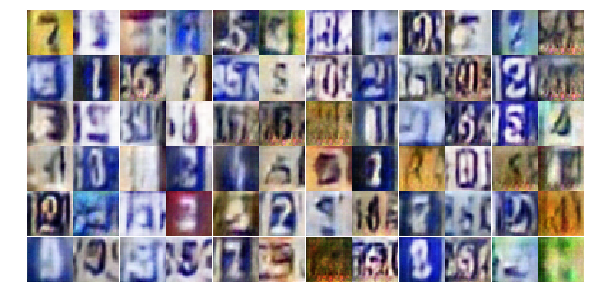

Epoch 25/25... Discriminator Loss: 1.3702... Generator Loss: 0.7575
Epoch 25/25... Discriminator Loss: 1.3524... Generator Loss: 0.6735


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

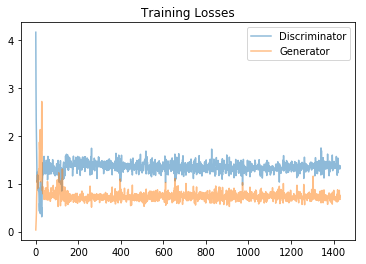

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

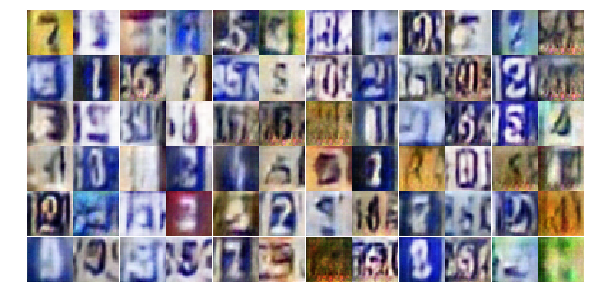

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))